# Penalaan Parameter PID Menggunakan Deep Learning pada Kit iTCLab dan Pemantauannya Menggunakan Internet of Things (IoT)

![Deep-PID-iTCLab-IoT](DL07.jpg)
Proses penalaan nilai Kc, τI dan τD pada
pengendali PID menggunakan Deep Learning pada Kit iTCLab dan Pemantauannya Menggunakan Internet of Things (IoT)

In [1]:
import itclab
import numpy as np
import time
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import random
from paho.mqtt import client as mqtt_client

In [2]:
# Machine Learning - Building Datasets and Model
# Impor `Sequential` dari` keras.models`
from keras.models import Sequential

# Impor `Dense` dari` keras.layers`
from keras.layers import Dense

# Inisialisasi konstruktor
model = Sequential()

# Tambahkan lapisan masukan 
model.add(Dense(2, activation='sigmoid', input_shape=(2,)))

# Tambahkan satu lapisan tersembunyi
model.add(Dense(3, activation='sigmoid'))

# Tambahkan lapisan keluaran
model.add(Dense(3, activation='sigmoid'))

# Data Latih.
X = np.array([
    [1, 1],
    [0.4, 1.2],
    [1.2, 0.1],
    [1, 0.1]
])

# Label untuk Data Latih.
y = np.array([
    [0.25, 4.31, 0.20],
    [0.2, 4.1, 0.1],
    [0.1, 4.0, 0],
    [0.1, 4.0, 0]
])

# Bentuk keluaran model
model.output_shape

# Ringkasan model
model.summary()

# Konfigurasi model
model.get_config()

# Buat daftar semua tensor bobot 
model.get_weights()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2)                 6         
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 9         
_________________________________________________________________
dense_2 (Dense)              (None, 3)                 12        
Total params: 27
Trainable params: 27
Non-trainable params: 0
_________________________________________________________________


[array([[-0.4637087 ,  0.48527718],
        [-0.5195681 , -0.03880537]], dtype=float32),
 array([0., 0.], dtype=float32),
 array([[ 1.0622828 ,  0.278062  , -0.25159615],
        [ 1.0829821 , -0.5021074 , -0.3673082 ]], dtype=float32),
 array([0., 0., 0.], dtype=float32),
 array([[ 0.9468181 ,  0.06228137,  0.8859892 ],
        [-0.36950827,  0.21268964,  0.03301334],
        [ 0.4722724 , -0.6382086 ,  0.85636044]], dtype=float32),
 array([0., 0., 0.], dtype=float32)]

In [3]:
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
                   
model.fit(X, y,epochs=10, batch_size=1, verbose=1)

Epoch 1/10
4/4 [==============================] - 2s 19ms/step - loss: 1.1343 - accuracy: 0.0000e+00
Epoch 2/10
4/4 [==============================] - 0s 2ms/step - loss: 1.1146 - accuracy: 0.0000e+00
Epoch 3/10
4/4 [==============================] - 0s 2ms/step - loss: 1.0950 - accuracy: 0.0000e+00
Epoch 4/10
4/4 [==============================] - 0s 4ms/step - loss: 1.0756 - accuracy: 0.0000e+00
Epoch 5/10
4/4 [==============================] - 0s 4ms/step - loss: 1.0561 - accuracy: 0.0000e+00
Epoch 6/10
4/4 [==============================] - 0s 2ms/step - loss: 1.0367 - accuracy: 0.0000e+00
Epoch 7/10
4/4 [==============================] - 0s 2ms/step - loss: 1.0173 - accuracy: 0.0000e+00
Epoch 8/10
4/4 [==============================] - 0s 3ms/step - loss: 0.9979 - accuracy: 0.0000e+00
Epoch 9/10
4/4 [==============================] - 0s 5ms/step - loss: 0.9787 - accuracy: 0.0000e+00
Epoch 10/10
4/4 [==============================] - 0s 4ms/step - loss: 0.9595 - accuracy: 0.0000e+0

In [4]:
######################################################
# Use this script for evaluating model predictions   #
# and PID controller performance for the TCLab       #
# Adjust only PID and model sections                 #
######################################################

######################################################
# PID Controller                                     #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution
def pid(sp,pv,pv_last,ierr,dt):
    Kc   = 10.0 # K/%Heater
    tauI = 50.0 # sec
    tauD = 1.0  # sec
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0
    # calculate the error
    error = sp-pv
    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [5]:
######################################################
# PID Controller using Deep Learning                 #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution

def pid_dl(sp,pv,pv_last,ierr,dt):

    # calculate the error
    error = sp-pv
    d_error = sp-pv_last
    delta_error = (error - d_error)
    
    outDL = model.predict(np.array([[error,delta_error]]))
    
    Kc = outDL[0,0]
    tauI = outDL[0,1]
    tauD = outDL[0,2]
    
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0

    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [6]:
######################################################
# FOPDT model                                        #
######################################################
Kp = 0.5      # degC/%
tauP = 120.0  # seconds
thetaP = 10   # seconds (integer)
Tss = 23      # degC (ambient temperature)
Qss = 0       # % heater

######################################################
# Energy balance model                               #
######################################################
def heat(x,t,Q):
    # Parameters
    Ta = 23 + 273.15   # K
    U = 10.0           # W/m^2-K
    m = 4.0/1000.0     # kg
    Cp = 0.5 * 1000.0  # J/kg-K    
    A = 12.0 / 100.0**2 # Area in m^2
    alpha = 0.01       # W / % heater
    eps = 0.9          # Emissivity
    sigma = 5.67e-8    # Stefan-Boltzman

    # Temperature State 
    T = x[0]

    # Nonlinear Energy Balance
    dTdt = (1.0/(m*Cp))*(U*A*(Ta-T) \
            + eps * sigma * A * (Ta**4 - T**4) \
            + alpha*Q)
    return dTdt

In [8]:
# Connect to MQTT Broker for Monitoring
broker = 'broker.hivemq.com'
port = 1883
client_id = f'python-mqtt-{random.randint(0, 1000)}'

def connect_mqtt():
    def on_connect(client, userdata, flags, rc):
        if rc == 0:
            print("Connected to MQTT Broker!")
        else:
            print("Failed to connect, return code %d\n", rc)

    client = mqtt_client.Client(client_id)
    client.on_connect = on_connect
    client.connect(broker, port)
    return client

client = connect_mqtt()
client.loop_start()

Connected to MQTT Broker!


Opening connection
iTCLab connected via Arduino on port COM9
LED On
Running Main Loop. Ctrl-C to end.
  Time     SP     PV     Q1   =  P   +  I  +   D
   0.0  25.00  23.46   0.00   0.00   0.00   0.00


<Figure size 720x504 with 0 Axes>

   1.0  25.00  23.49   2.91   0.98   1.95  -0.01


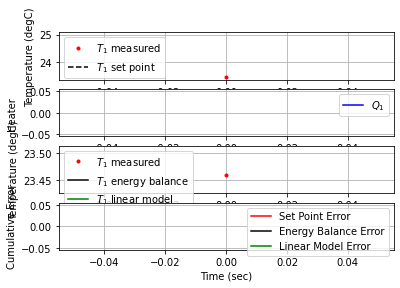

   3.5  25.00  23.44   8.07   1.01   7.04   0.01


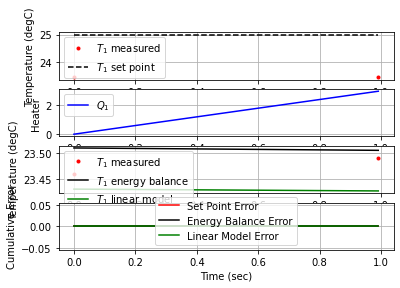

   4.8  25.00  23.45  10.63   1.01   9.63  -0.00


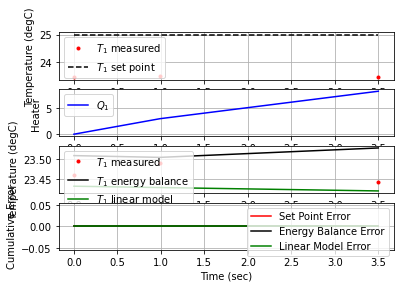

   6.0  25.00  23.47  13.13   0.99  12.15  -0.01


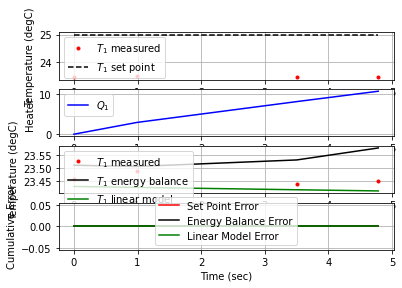

   7.3  25.00  23.52  15.41   0.96  14.47  -0.02


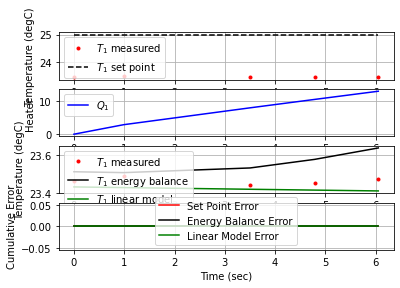

   8.4  25.00  23.53  17.60   0.95  16.65  -0.00


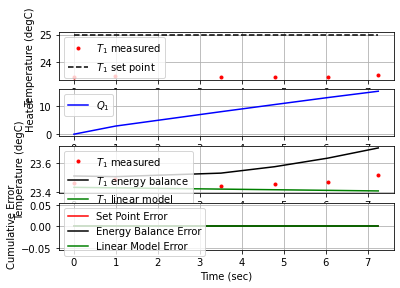

   9.6  25.00  23.45  20.02   1.01  18.98   0.03


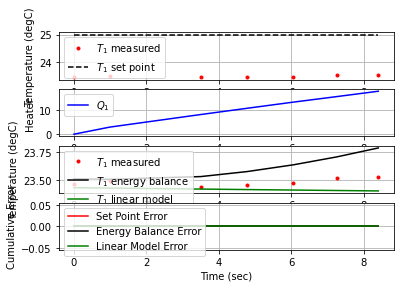

  10.7  25.00  23.44  22.35   1.01  21.33   0.00


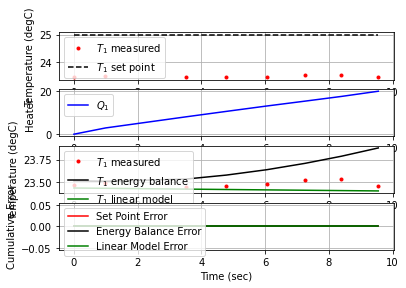

  11.8  25.00  23.37  24.67   1.06  23.59   0.03


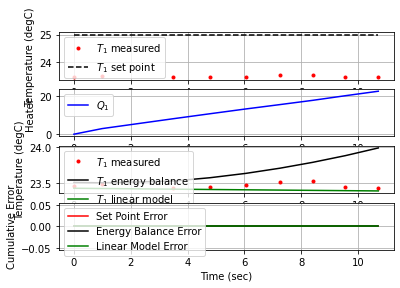

  12.9  25.00  23.53  26.71   0.95  25.82  -0.06


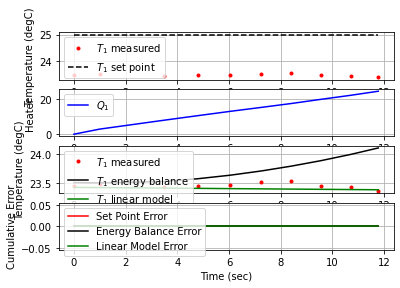

  14.0  25.00  23.45  29.04   1.01  28.00   0.03


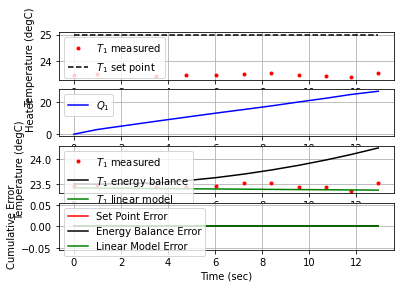

  15.1  25.00  23.54  30.95   0.95  30.04  -0.04


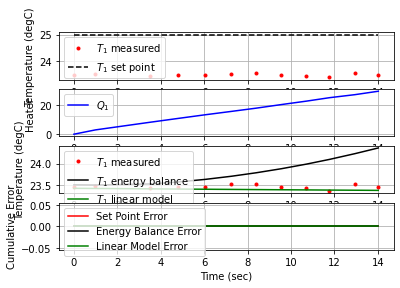

  16.2  25.00  23.51  33.17   0.97  32.19   0.01


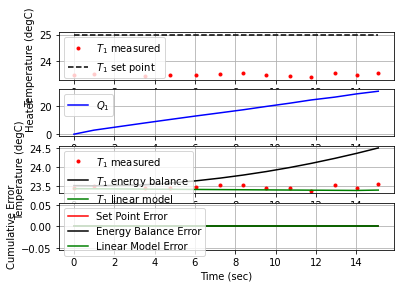

  17.5  25.00  23.36  36.05   1.06  34.93   0.05


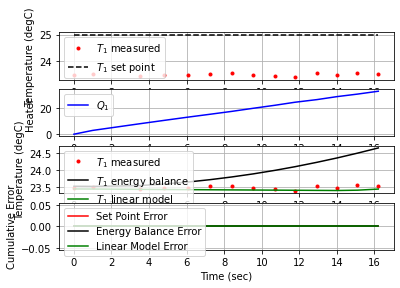

  18.6  25.00  23.49  38.09   0.98  37.17  -0.05


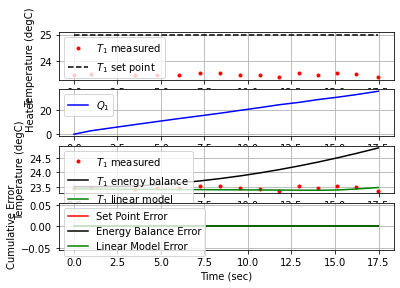

  20.6  25.00  23.49  41.95   0.98  40.97  -0.00


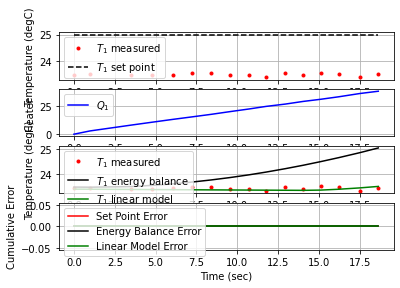

  21.9  25.00  23.47  44.56   0.99  43.56   0.01


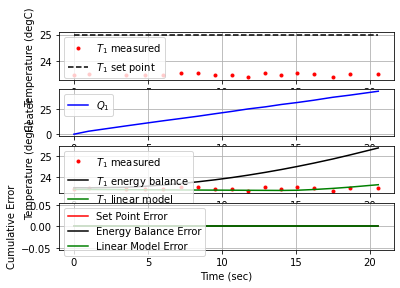

  23.2  25.00  23.55  47.07   0.94  46.16  -0.03


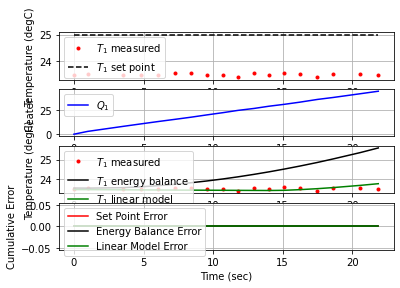

  24.4  25.00  23.44  49.62   1.01  48.57   0.04


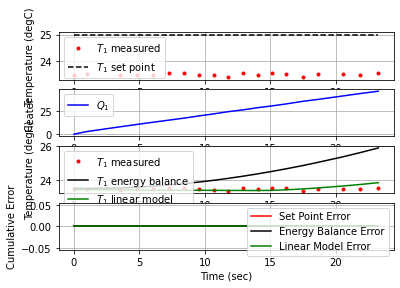

  25.6  25.00  23.43  52.02   1.02  50.99   0.00


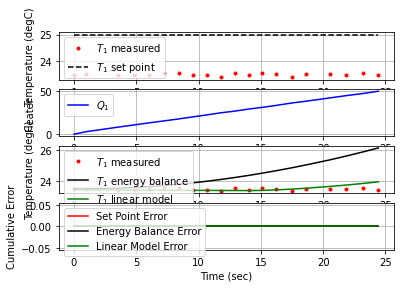

  26.9  25.00  23.48  54.56   0.99  53.59  -0.02


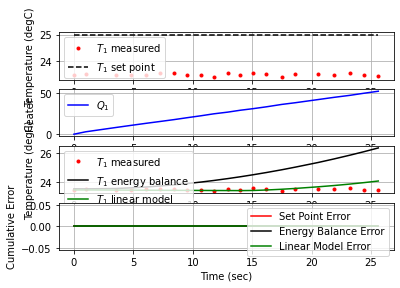

  28.1  25.00  23.52  56.76   0.96  55.81  -0.02


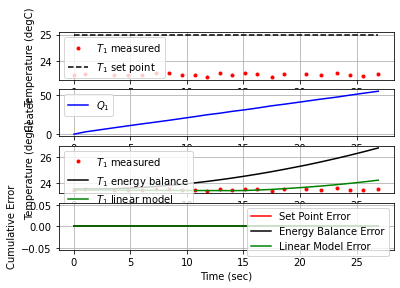

  29.4  25.00  23.40  59.56   1.04  58.48   0.04


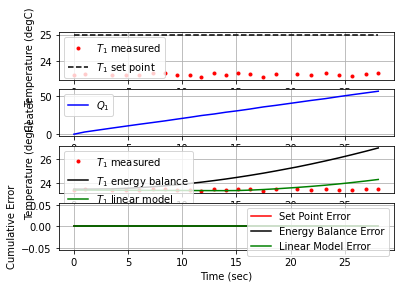

  31.2  25.00  23.50  62.97   0.97  62.02  -0.03


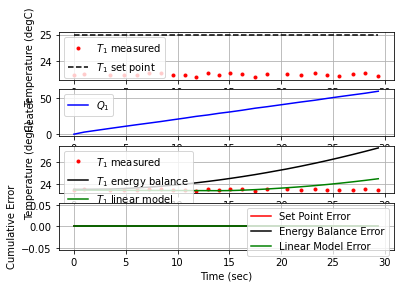

  32.6  25.00  23.49  65.70   0.98  64.72   0.00


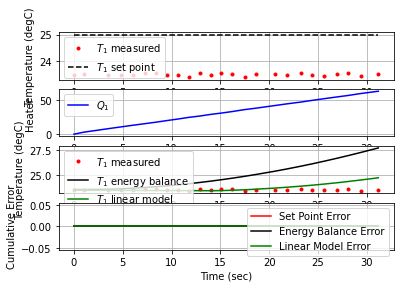

  34.5  25.00  23.45  69.67   1.01  68.66   0.01


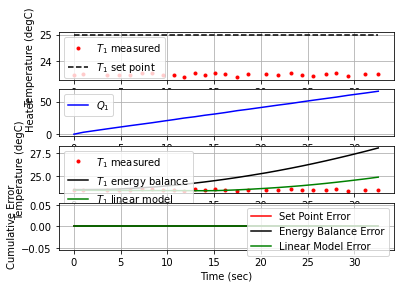

  36.5  25.00  23.38  73.89   1.05  72.83   0.02


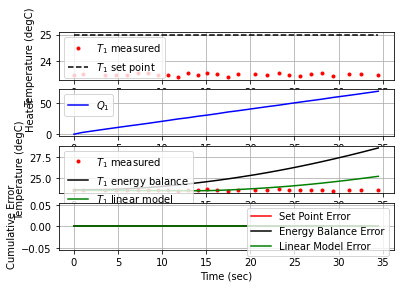

  38.5  25.00  23.48  77.76   0.99  76.79  -0.02


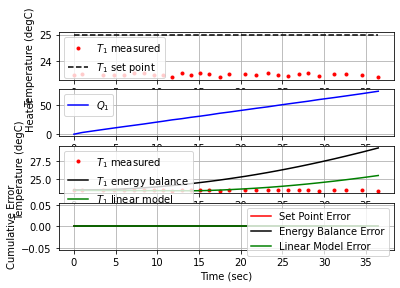

  41.1  25.00  23.44  83.11   1.01  82.09   0.01


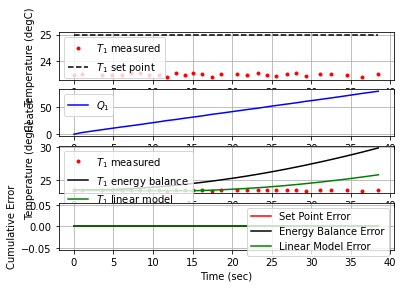

  43.6  25.00  23.50  87.86   0.97  86.90  -0.01


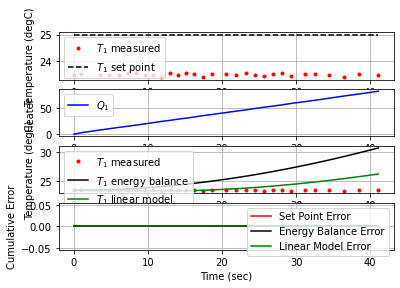

  45.5  25.00  23.43  91.94   1.02  90.91   0.02


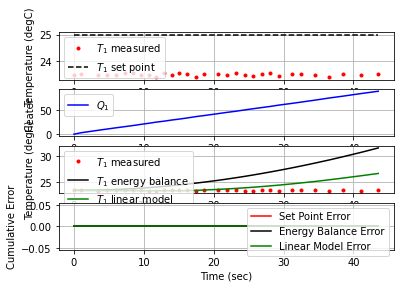

  47.4  25.00  23.36  95.96   1.06  94.88   0.02


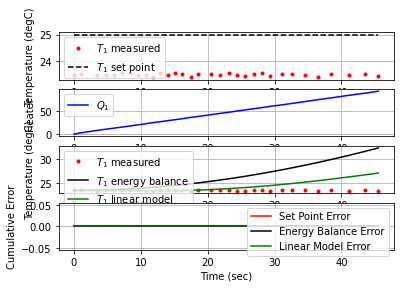

  49.3  25.00  23.44  99.81   1.01  98.82  -0.02


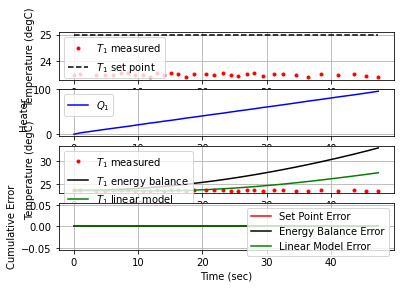

  51.4  25.00  23.49 100.00   0.98  98.82  -0.01


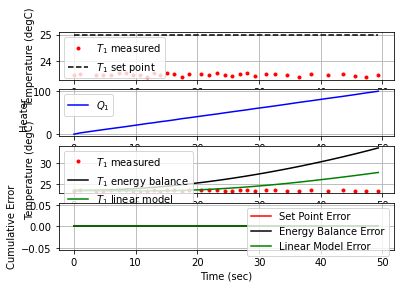

  54.0  25.00  23.47 100.00   0.99  98.82   0.00


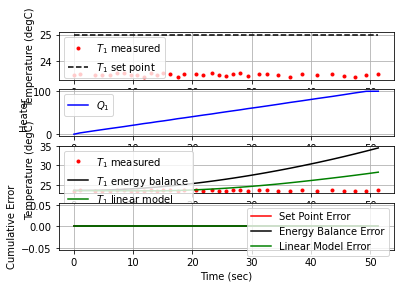

  55.8  25.00  23.41 100.00   1.03  98.82   0.02


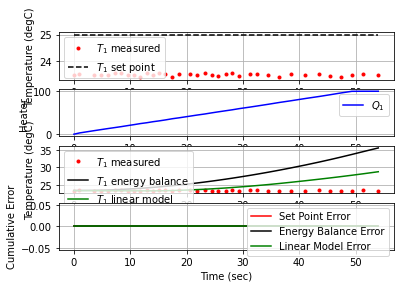

  57.3  25.00  23.45 100.00   1.01  98.82  -0.01


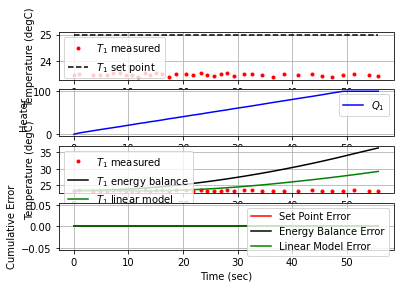

  58.9  25.00  23.52 100.00   0.96  98.82  -0.02


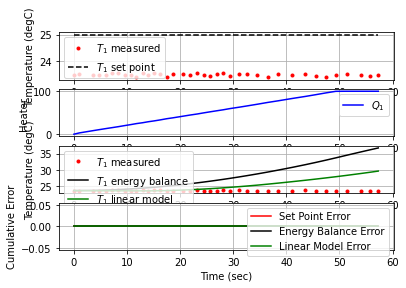

  60.3  25.00  23.41 100.00   1.03  98.82   0.04


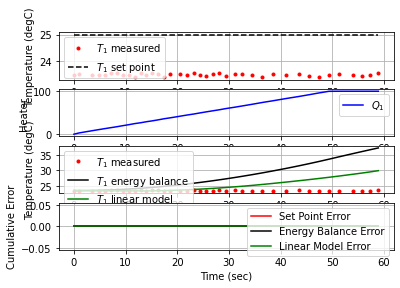

  61.9  25.00  23.39 100.00   1.04  98.82   0.01


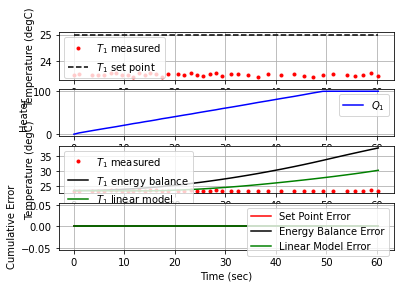

  63.4  25.00  23.48 100.00   0.99  98.82  -0.03


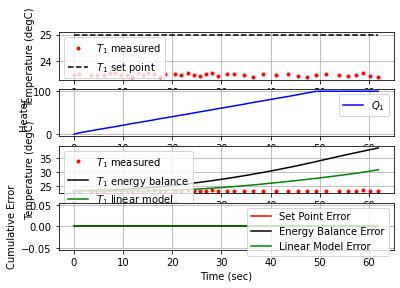

  65.0  25.00  23.52 100.00   0.96  98.82  -0.01


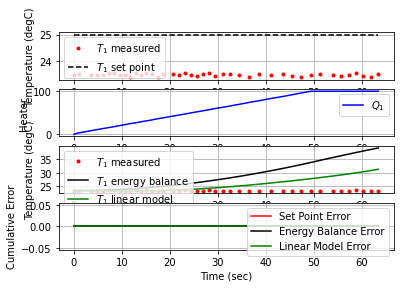

  67.4  25.00  23.41 100.00   1.03  98.82   0.02


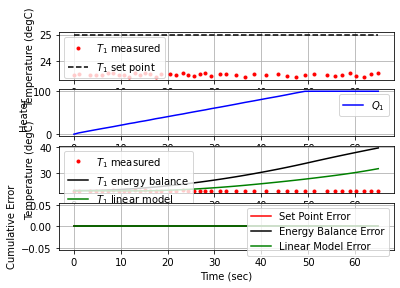

  69.3  25.00  23.40 100.00   1.04  98.82   0.00


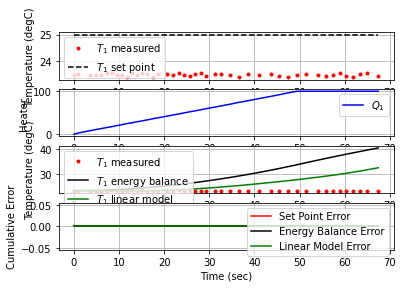

  72.2  25.00  23.49 100.00   0.98  98.82  -0.01


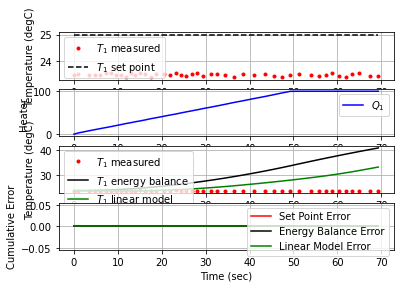

  74.3  25.00  23.54 100.00   0.95  98.82  -0.01


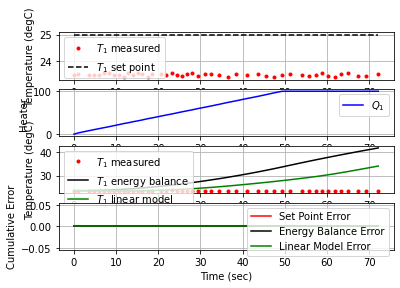

  76.2  25.00  23.53 100.00   0.95  98.82   0.00


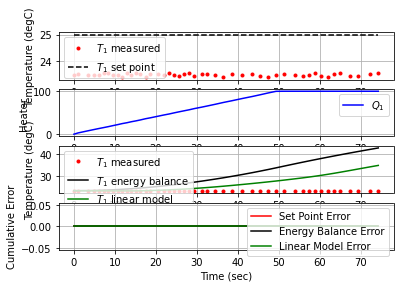

  78.2  25.00  23.53 100.00   0.95  98.82  -0.00


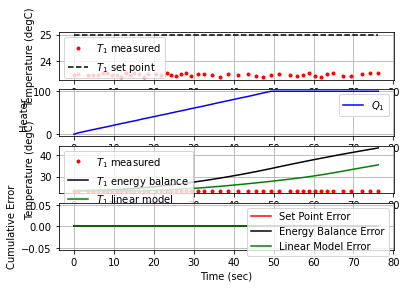

  80.1  25.00  23.55 100.00   0.94  98.82  -0.00


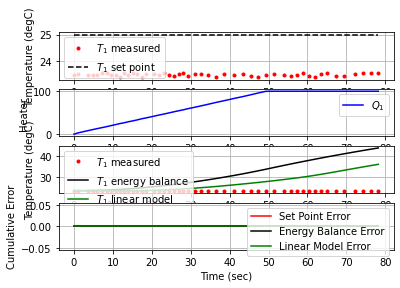

  82.3  25.00  23.53 100.00   0.95  98.82   0.00


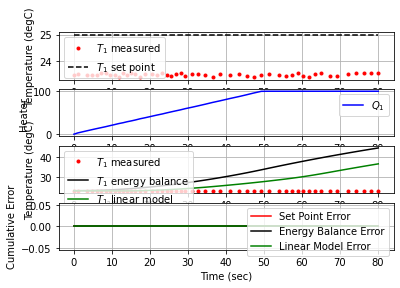

  84.6  25.00  23.48 100.00   0.99  98.82   0.01


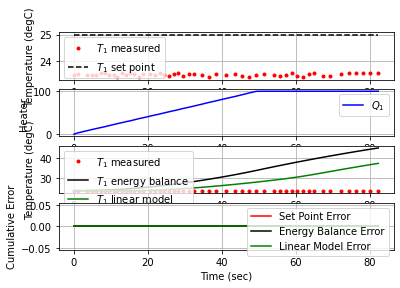

  86.6  25.00  23.47 100.00   0.99  98.82   0.00


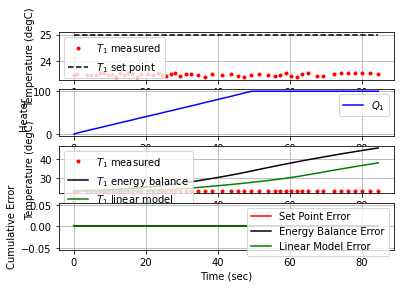

  88.3  25.00  23.45 100.00   1.01  98.82   0.01


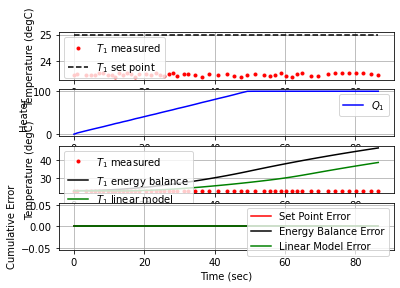

  90.1  25.00  23.49 100.00   0.98  98.82  -0.01


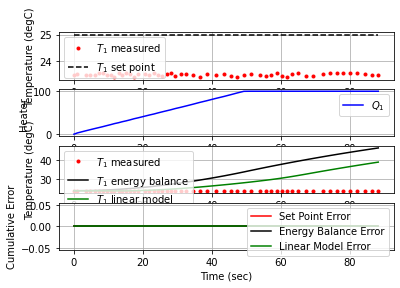

  92.1  25.00  23.54 100.00   0.95  98.82  -0.01


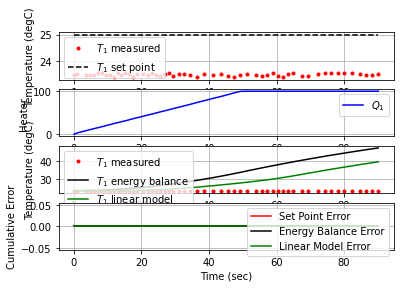

  94.0  25.00  23.61 100.00   0.90  98.82  -0.02


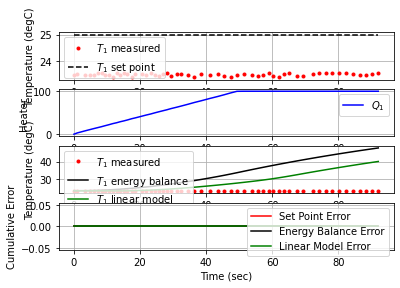

  96.0  25.00  23.60 100.00   0.91  98.82   0.00


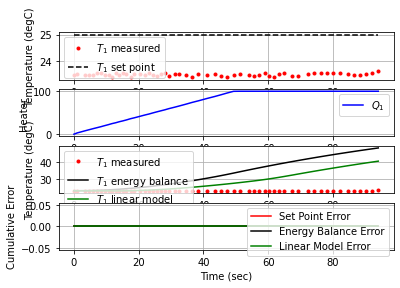

  97.9  25.00  23.51 100.00   0.97  98.82   0.02


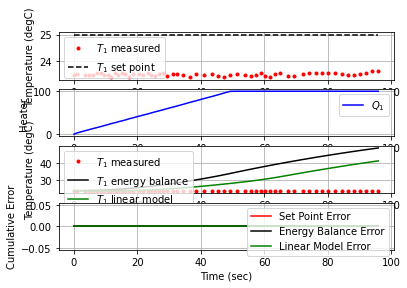

  99.6  25.00  23.49 100.00   0.98  98.82   0.01


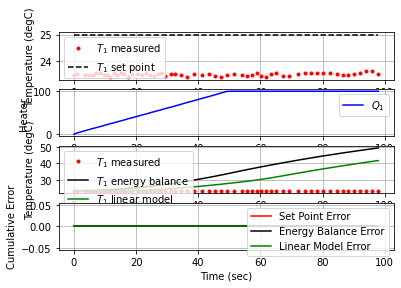

 101.4  45.00  23.57 100.00  13.99  98.82  -0.02


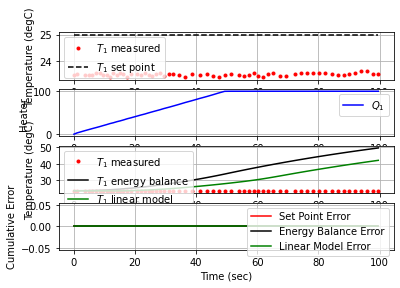

 102.4  45.00  23.57 100.00  13.99  98.82  -0.00


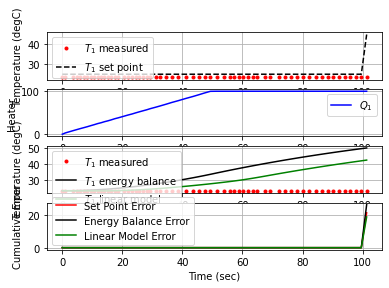

 103.5  45.00  23.58 100.00  13.99  98.82  -0.00


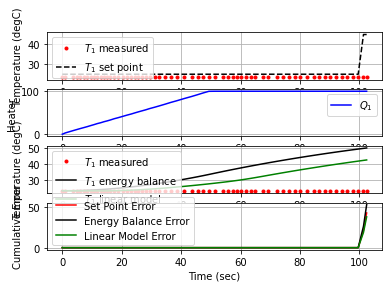

 104.5  45.00  23.62 100.00  13.96  98.82  -0.02


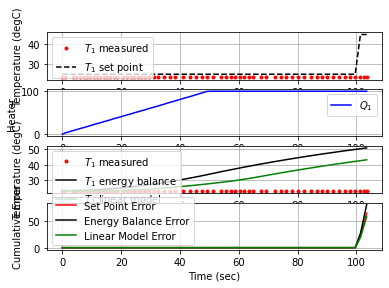

 106.3  45.00  23.61 100.00  13.97  98.82   0.00


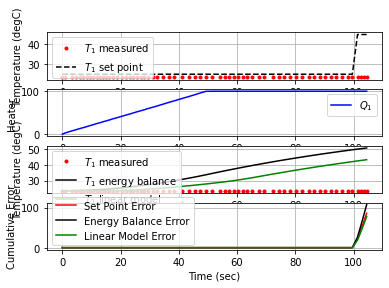

 108.0  45.00  23.60 100.00  13.97  98.82   0.00


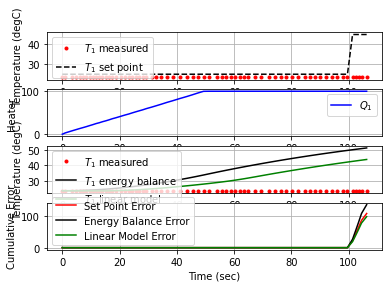

 110.0  45.00  23.49 100.00  14.04  98.82   0.03


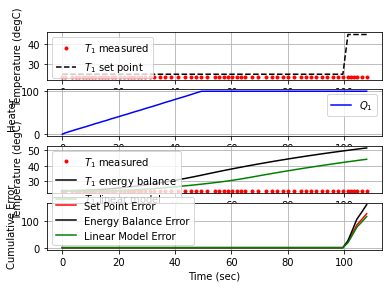

 111.8  45.00  23.54 100.00  14.01  98.82  -0.01


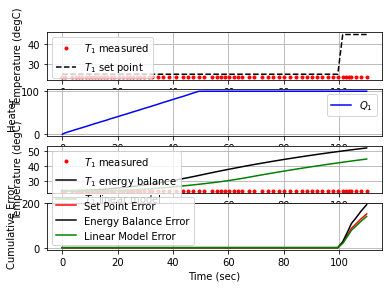

 113.7  45.00  23.58 100.00  13.99  98.82  -0.01


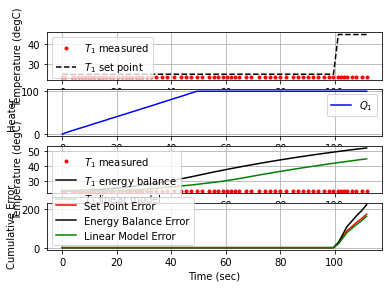

 115.4  45.00  23.60 100.00  13.97  98.82  -0.01


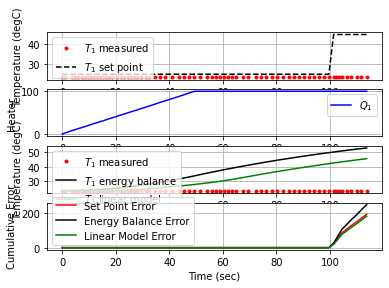

 117.1  45.00  23.54 100.00  14.01  98.82   0.02


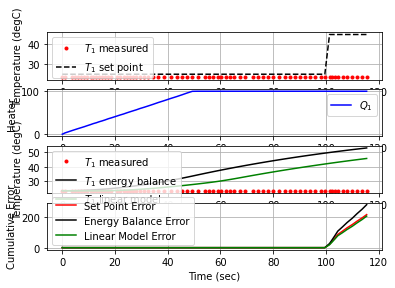

 119.2  45.00  23.45 100.00  14.07  98.82   0.02


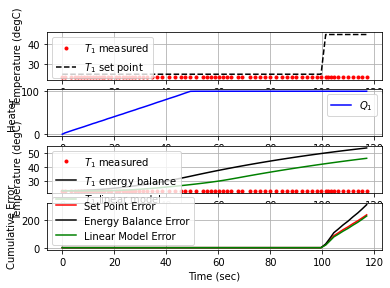

 121.1  45.00  23.52 100.00  14.02  98.82  -0.02


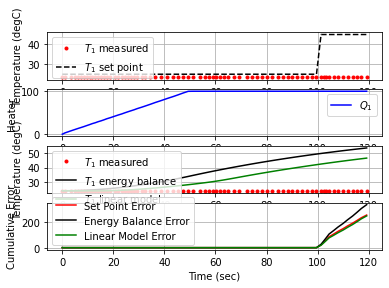

 123.2  45.00  23.51 100.00  14.03  98.82   0.00


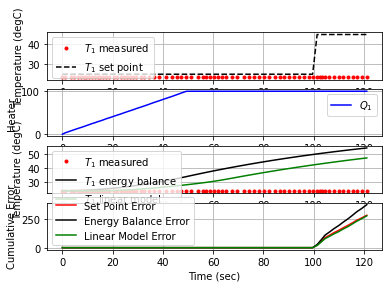

 125.2  45.00  23.50 100.00  14.04  98.82   0.00


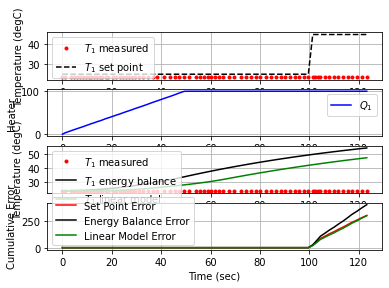

 127.1  45.00  23.51 100.00  14.03  98.82  -0.00


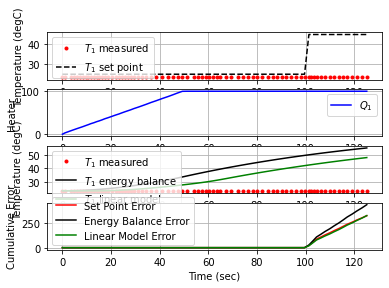

 129.3  45.00  23.54 100.00  14.01  98.82  -0.01


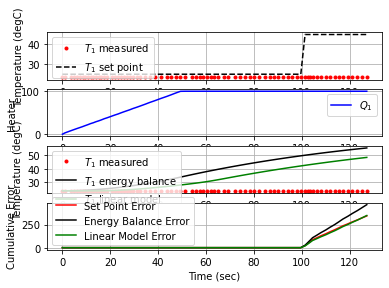

 131.3  45.00  23.56 100.00  14.00  98.82  -0.00


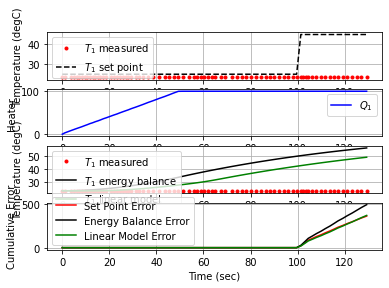

 133.4  45.00  23.58 100.00  13.99  98.82  -0.00


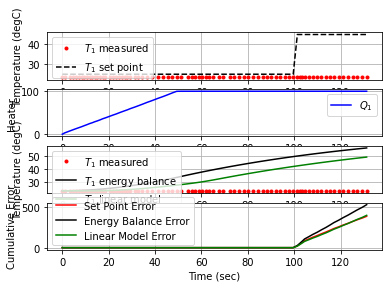

 135.3  45.00  23.65 100.00  13.94  98.82  -0.02


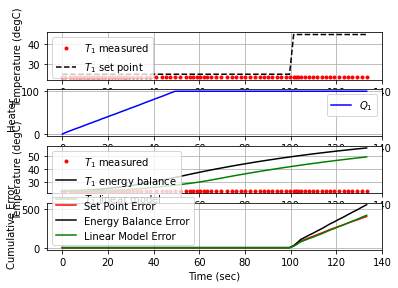

 137.2  45.00  23.57 100.00  13.99  98.82   0.02


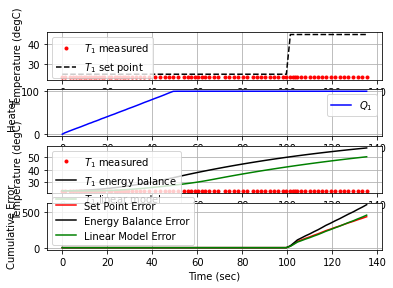

 139.5  45.00  23.56 100.00  14.00  98.82   0.00


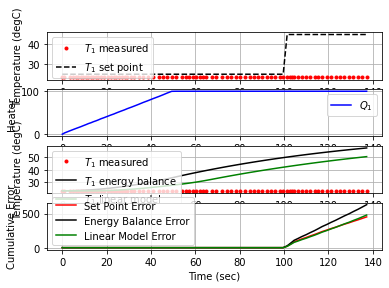

 141.1  45.00  23.50 100.00  14.04  98.82   0.02


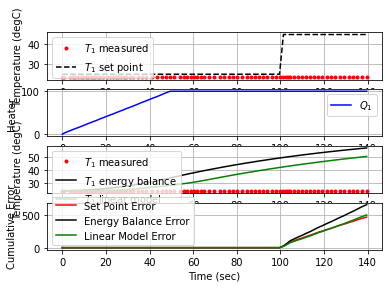

 142.7  45.00  23.59 100.00  13.98  98.82  -0.03


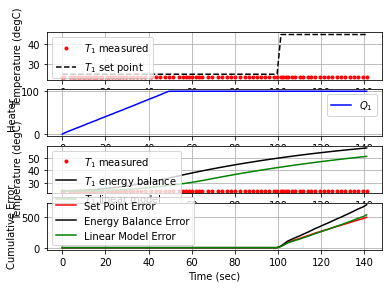

 144.1  45.00  23.51 100.00  14.03  98.82   0.03


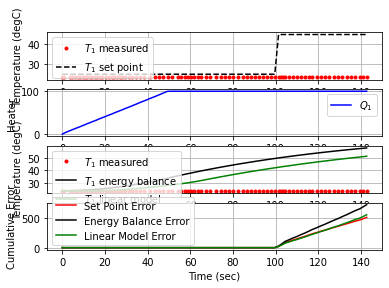

 145.5  45.00  23.59 100.00  13.98  98.82  -0.03


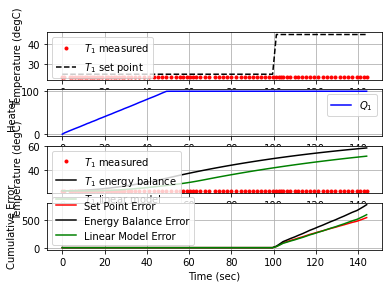

 147.4  45.00  23.54 100.00  14.01  98.82   0.01


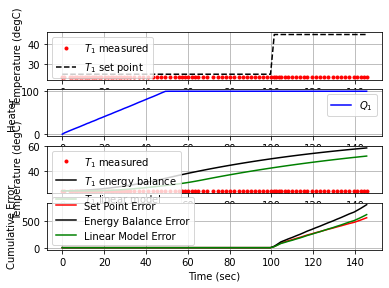

 148.9  45.00  23.50 100.00  14.04  98.82   0.01


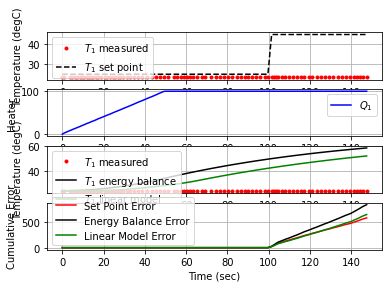

 150.3  45.00  23.58 100.00  13.99  98.82  -0.03


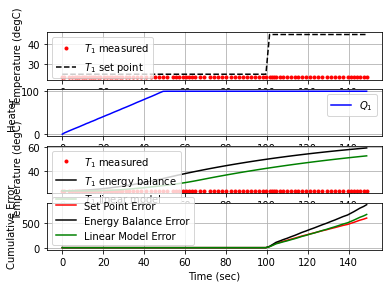

 152.0  45.00  23.51 100.00  14.03  98.82   0.02


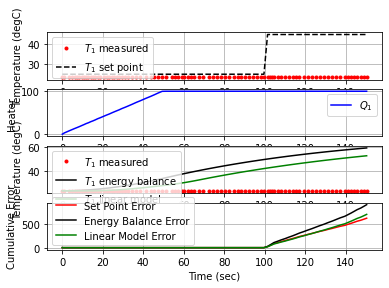

 153.7  45.00  23.50 100.00  14.04  98.82   0.00


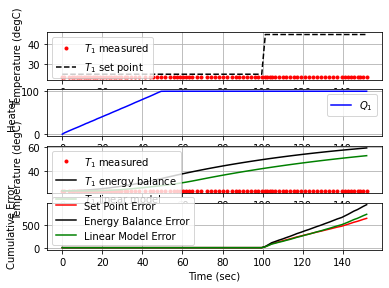

 155.5  45.00  23.57 100.00  13.99  98.82  -0.02


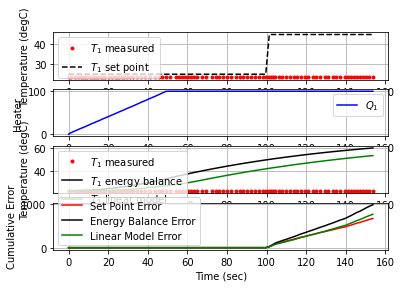

 157.0  45.00  23.52 100.00  14.02  98.82   0.02


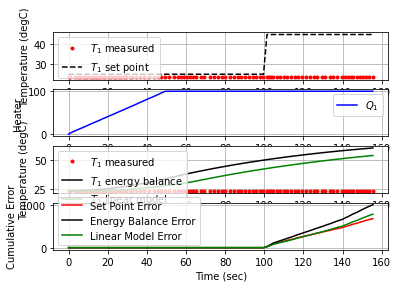

 158.5  45.00  23.59 100.00  13.98  98.82  -0.02


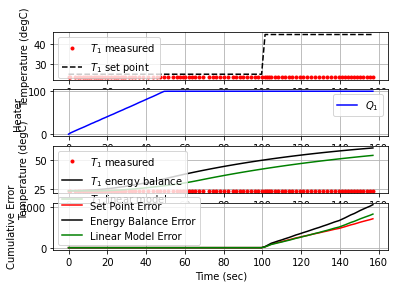

 160.0  45.00  23.48 100.00  14.05  98.82   0.03


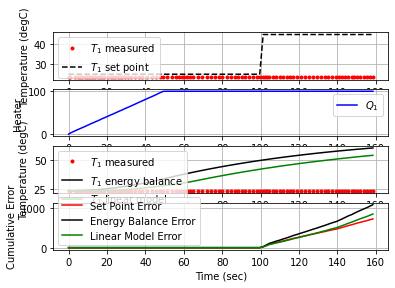

 161.6  45.00  23.49 100.00  14.04  98.82  -0.00


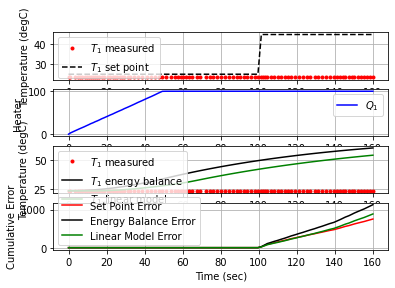

 163.4  45.00  23.51 100.00  14.03  98.82  -0.00


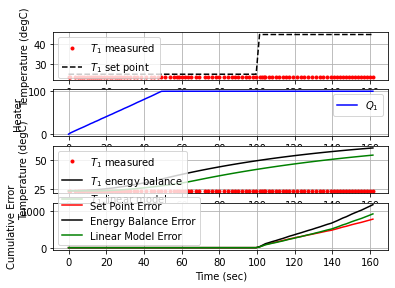

 165.1  45.00  23.54 100.00  14.01  98.82  -0.01


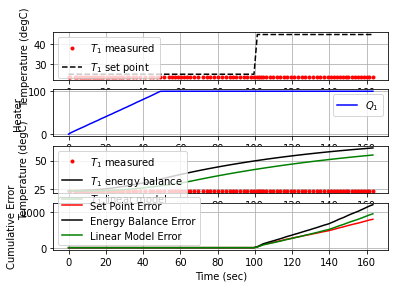

 166.6  45.00  23.63 100.00  13.95  98.82  -0.03


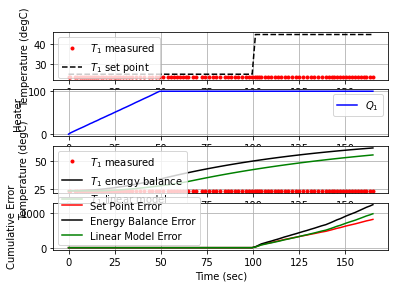

 168.1  45.00  23.53 100.00  14.02  98.82   0.03


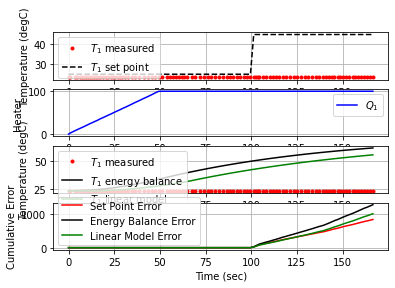

 169.7  45.00  23.59 100.00  13.98  98.82  -0.02


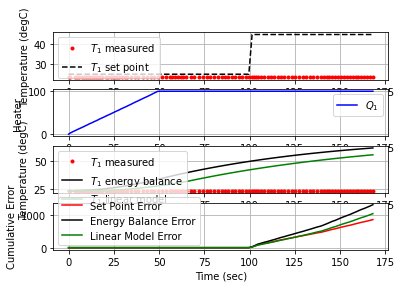

 171.1  45.00  23.52 100.00  14.02  98.82   0.02


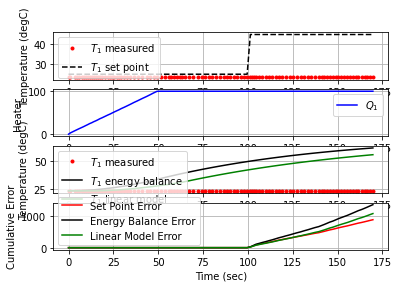

 172.6  45.00  23.54 100.00  14.01  98.82  -0.01


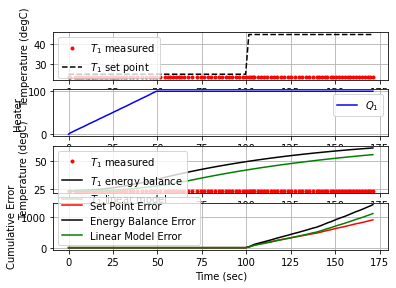

 174.2  45.00  23.56 100.00  14.00  98.82  -0.01


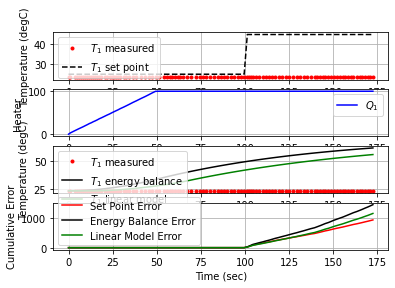

 175.6  45.00  23.54 100.00  14.01  98.82   0.01


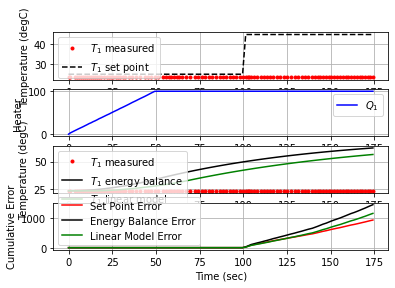

 177.2  45.00  23.61 100.00  13.97  98.82  -0.02


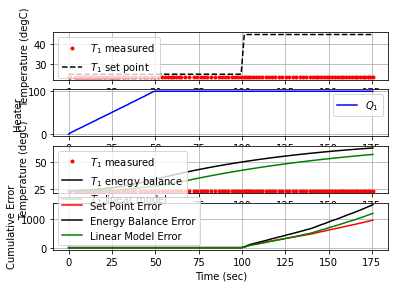

 178.7  45.00  23.61 100.00  13.97  98.82  -0.00


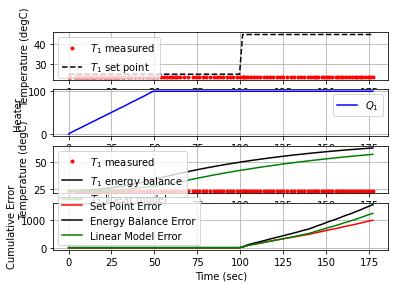

 180.2  45.00  23.48 100.00  14.05  98.82   0.04


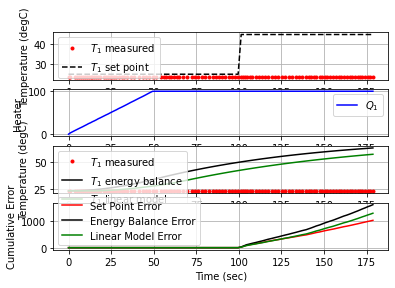

 181.6  45.00  23.50 100.00  14.04  98.82  -0.01


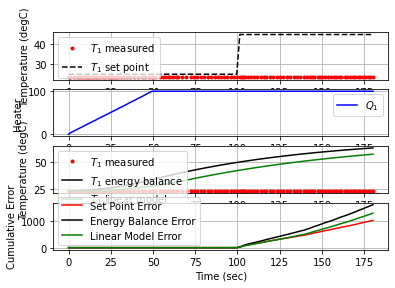

 183.1  45.00  23.54 100.00  14.01  98.82  -0.01


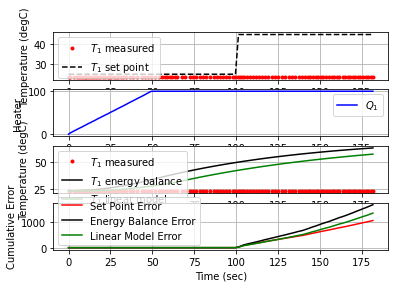

 184.7  45.00  23.59 100.00  13.98  98.82  -0.01


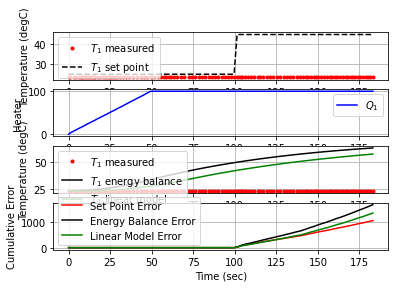

 186.1  45.00  23.59 100.00  13.98  98.82  -0.00


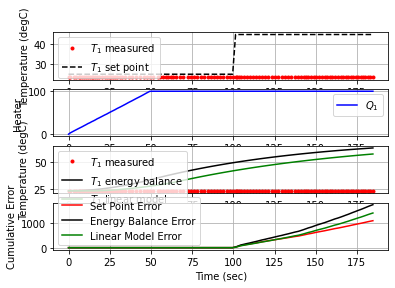

 187.6  45.00  23.53 100.00  14.02  98.82   0.02


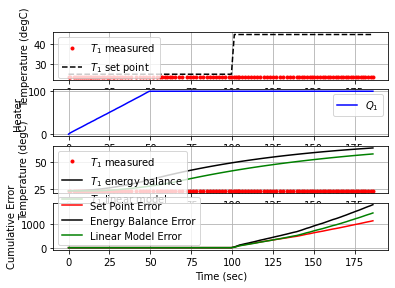

 188.9  45.00  23.63 100.00  13.95  98.82  -0.04


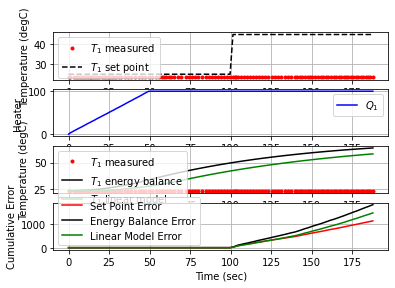

 190.0  45.00  23.57 100.00  13.99  98.82   0.03


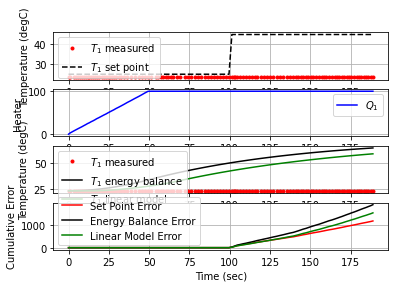

 191.2  45.00  23.48 100.00  14.05  98.82   0.03


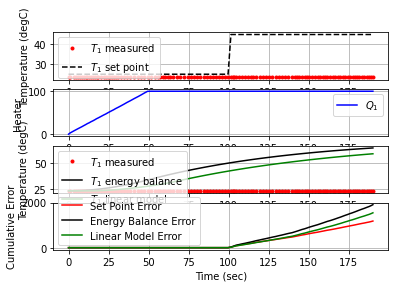

 192.4  45.00  23.51 100.00  14.03  98.82  -0.01


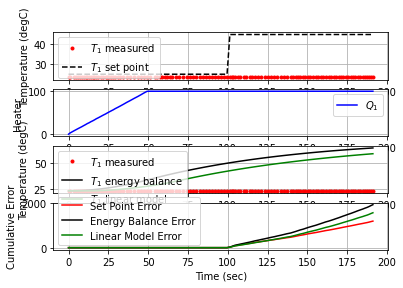

 194.0  45.00  23.52 100.00  14.02  98.82  -0.00


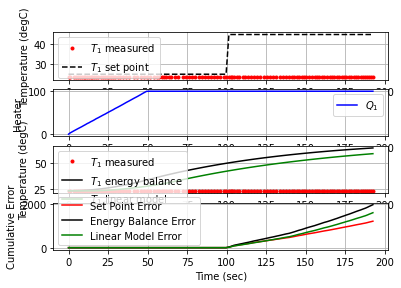

 195.9  45.00  23.61 100.00  13.97  98.82  -0.02


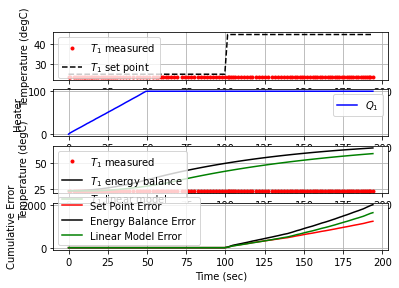

 197.7  45.00  23.53 100.00  14.02  98.82   0.02


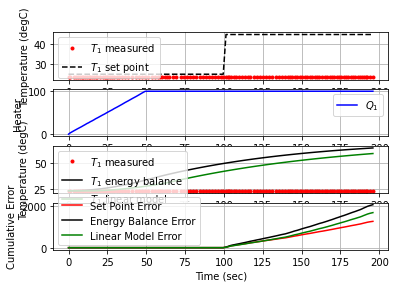

 199.8  45.00  23.58 100.00  13.99  98.82  -0.01


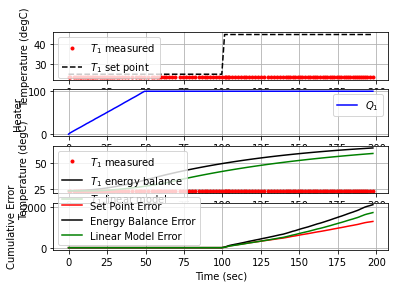

 201.3  45.00  23.57 100.00  13.99  98.82   0.00


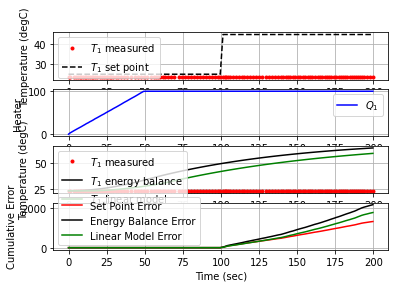

 202.9  45.00  23.51 100.00  14.03  98.82   0.02


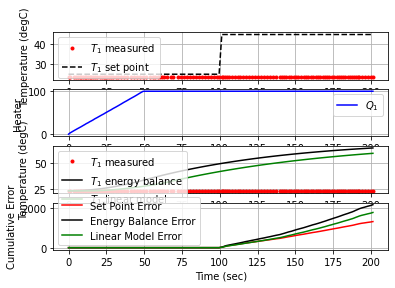

 204.4  45.00  23.59 100.00  13.98  98.82  -0.02


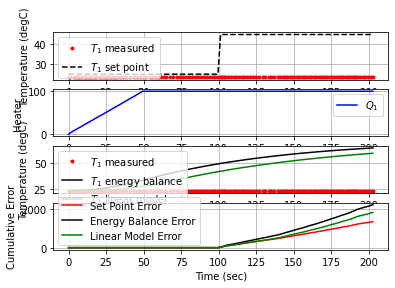

 206.3  45.00  23.53 100.00  14.02  98.82   0.01


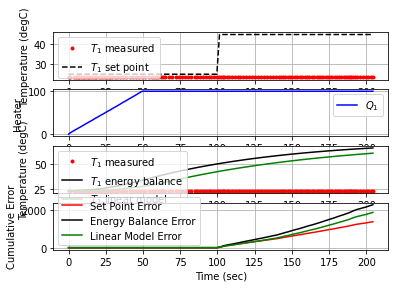

 208.1  45.00  23.51 100.00  14.03  98.82   0.01


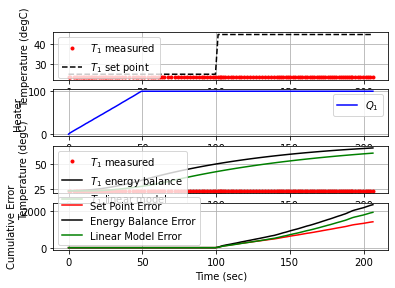

 209.6  45.00  23.54 100.00  14.01  98.82  -0.01


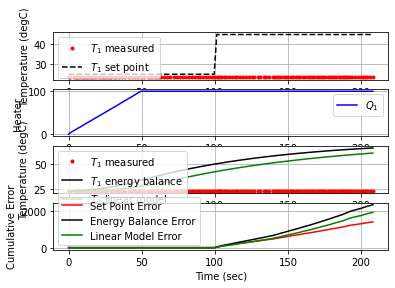

 211.1  45.00  23.55 100.00  14.01  98.82  -0.00


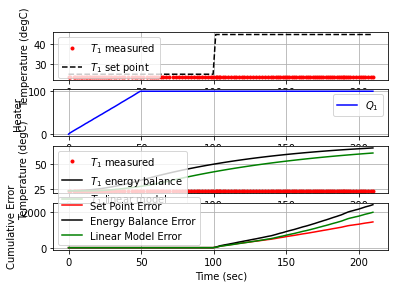

 212.6  45.00  23.53 100.00  14.02  98.82   0.01


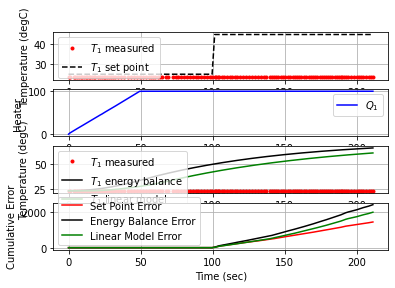

 214.0  45.00  23.50 100.00  14.04  98.82   0.01


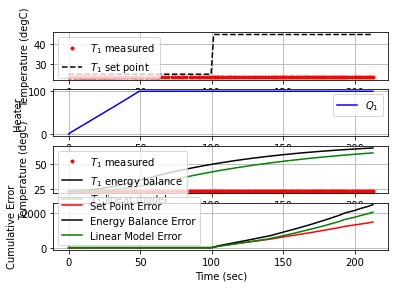

 215.3  45.00  23.63 100.00  13.95  98.82  -0.05


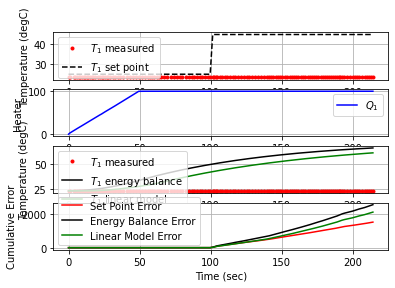

 216.8  45.00  23.61 100.00  13.97  98.82   0.01


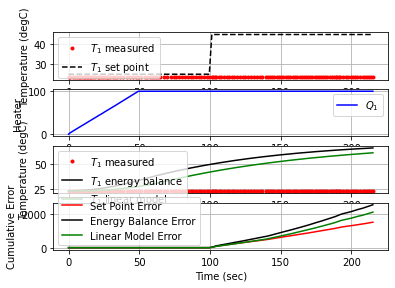

 218.2  45.00  23.56 100.00  14.00  98.82   0.02


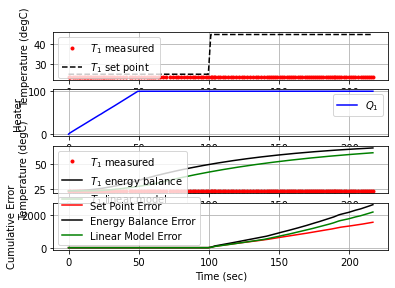

 219.5  45.00  23.56 100.00  14.00  98.82  -0.00


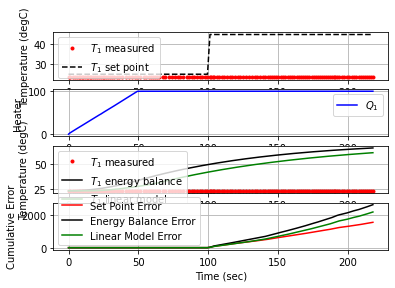

 220.8  45.00  23.58 100.00  13.99  98.82  -0.01


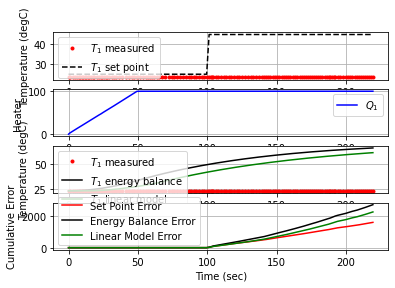

 222.1  45.00  23.58 100.00  13.99  98.82  -0.00


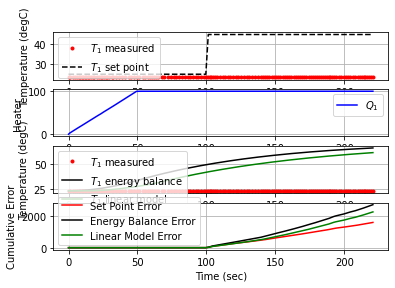

 223.7  45.00  23.45 100.00  14.07  98.82   0.04


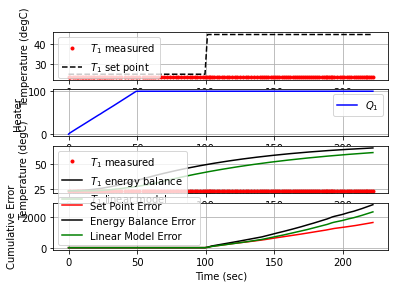

 225.0  45.00  23.57 100.00  13.99  98.82  -0.04


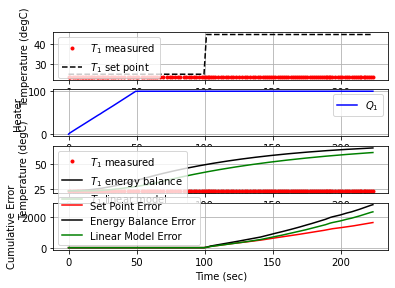

 226.3  45.00  23.50 100.00  14.04  98.82   0.02


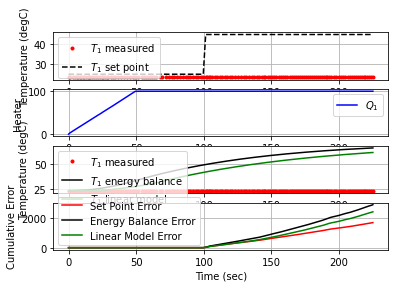

 227.6  45.00  23.60 100.00  13.97  98.82  -0.04


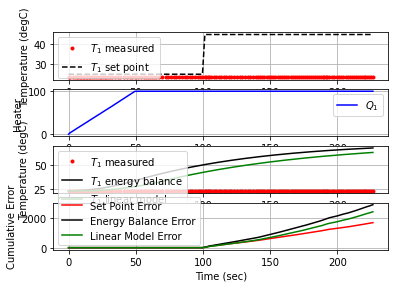

 228.9  45.00  23.51 100.00  14.03  98.82   0.03


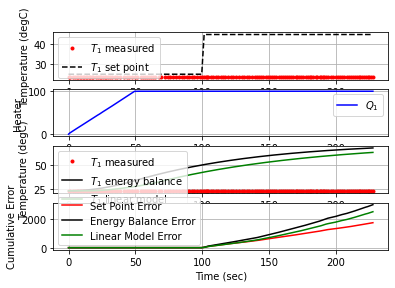

 230.3  45.00  23.51 100.00  14.03  98.82  -0.00


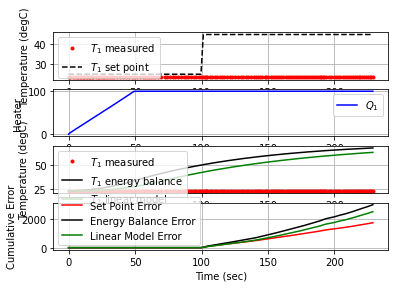

 231.9  45.00  23.54 100.00  14.01  98.82  -0.01


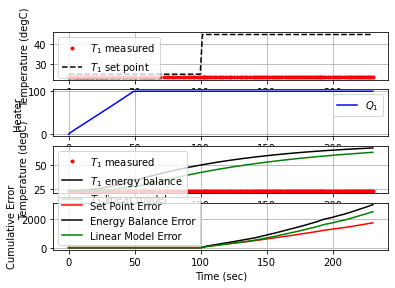

 233.4  45.00  23.54 100.00  14.01  98.82  -0.00


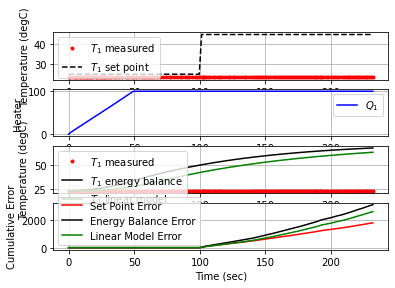

 234.7  45.00  23.60 100.00  13.97  98.82  -0.02


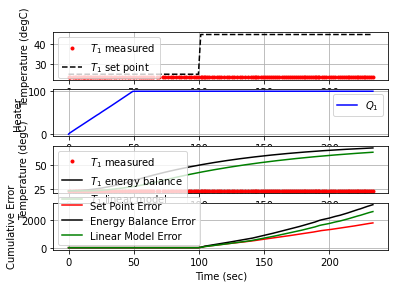

 236.0  45.00  23.58 100.00  13.99  98.82   0.01


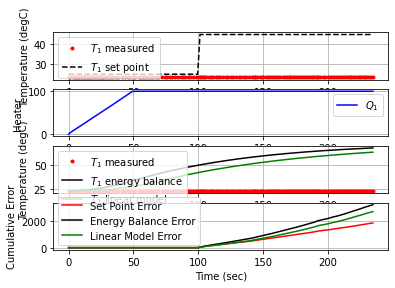

 237.3  45.00  23.61 100.00  13.97  98.82  -0.01


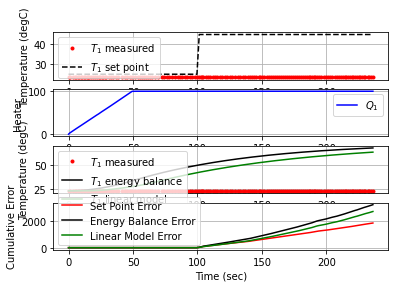

 238.9  45.00  23.59 100.00  13.98  98.82   0.01


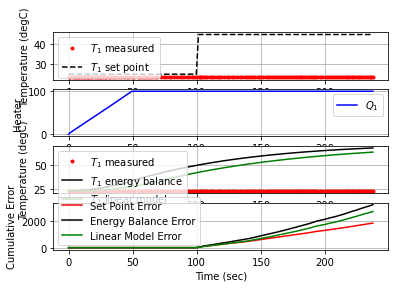

 240.2  45.00  23.54 100.00  14.01  98.82   0.02


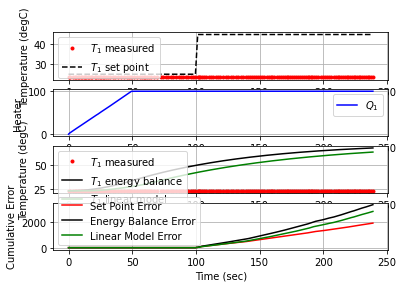

 241.6  45.00  23.59 100.00  13.98  98.82  -0.02


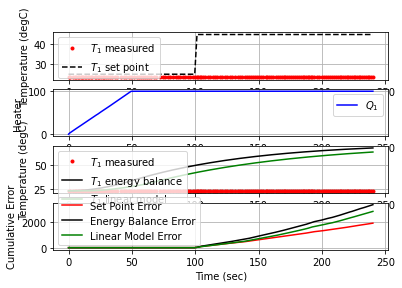

 243.0  45.00  23.61 100.00  13.97  98.82  -0.01


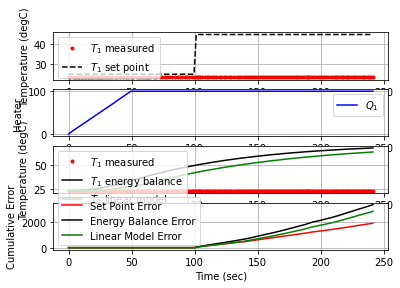

 244.4  45.00  23.61 100.00  13.97  98.82  -0.00


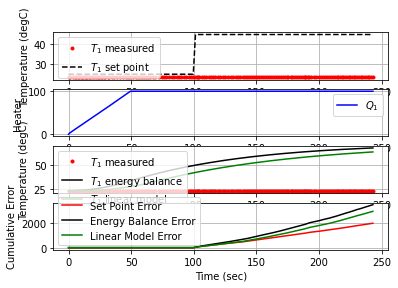

 245.7  45.00  23.48 100.00  14.05  98.82   0.04


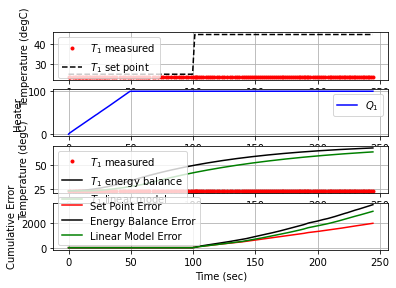

 247.3  45.00  23.64 100.00  13.95  98.82  -0.05


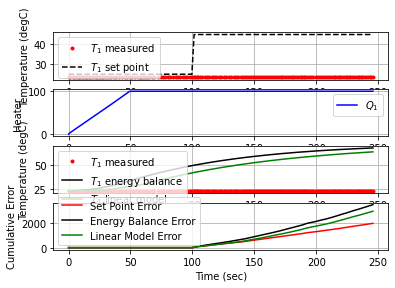

 248.6  45.00  23.59 100.00  13.98  98.82   0.02


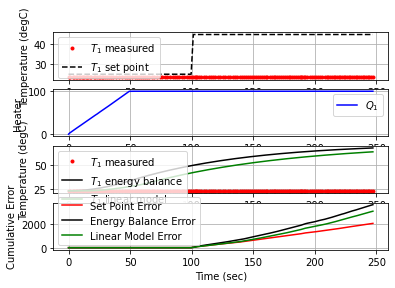

 250.0  45.00  23.57 100.00  13.99  98.82   0.01


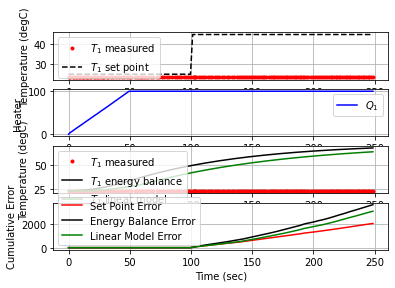

 251.5  45.00  23.56 100.00  14.00  98.82   0.00


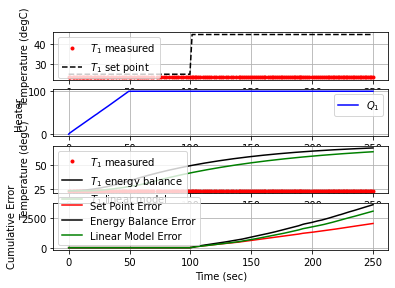

 255.0  45.00  23.55 100.00  14.01  98.82   0.00


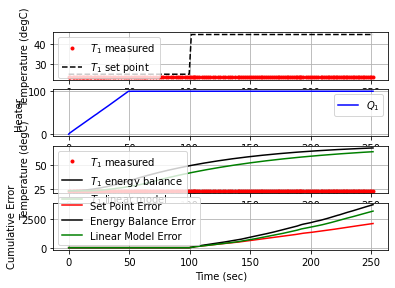

 257.4  45.00  23.70 100.00  13.91  98.82  -0.03


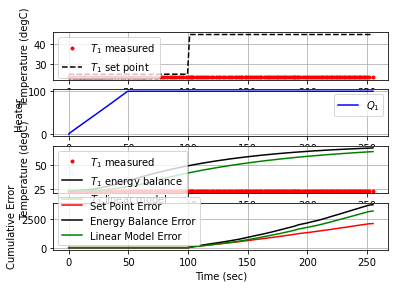

 259.4  45.00  23.57 100.00  13.99  98.82   0.03


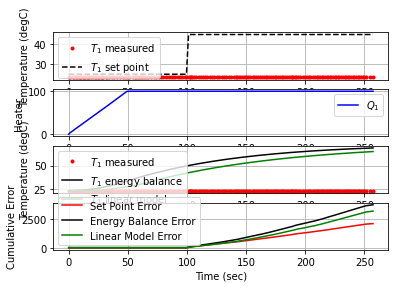

 261.8  45.00  23.64 100.00  13.95  98.82  -0.01


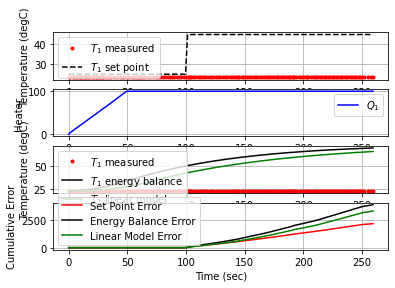

 264.4  45.00  23.59 100.00  13.98  98.82   0.01


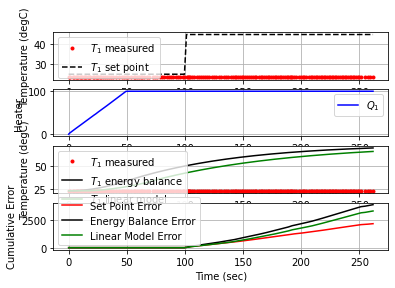

 266.4  45.00  23.59 100.00  13.98  98.82  -0.00


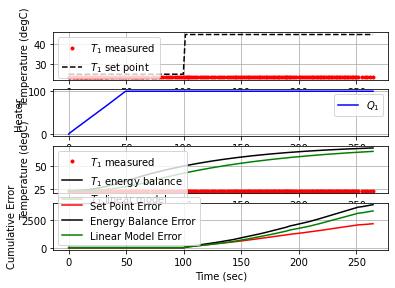

 268.2  45.00  23.60 100.00  13.97  98.82  -0.00


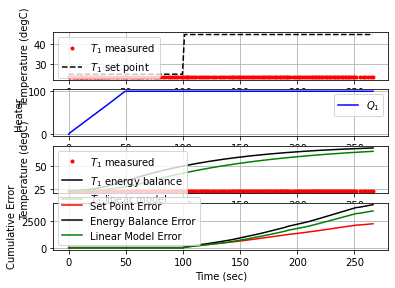

 270.6  45.00  23.60 100.00  13.97  98.82  -0.00


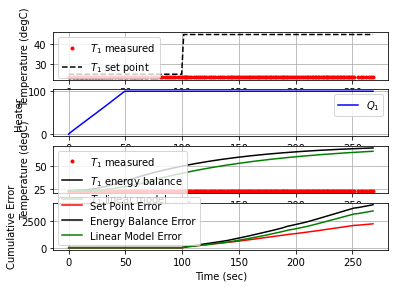

 273.0  45.00  23.69 100.00  13.91  98.82  -0.02


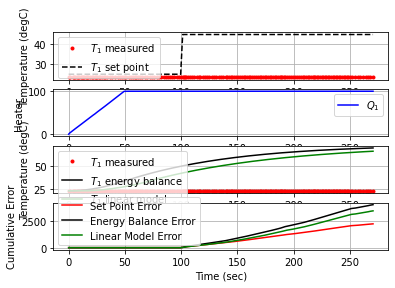

 275.0  45.00  23.56 100.00  14.00  98.82   0.03


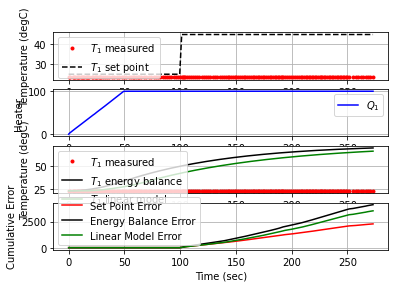

 277.1  45.00  23.69 100.00  13.91  98.82  -0.03


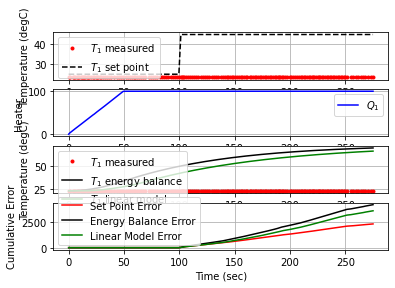

 279.1  45.00  23.63 100.00  13.95  98.82   0.01


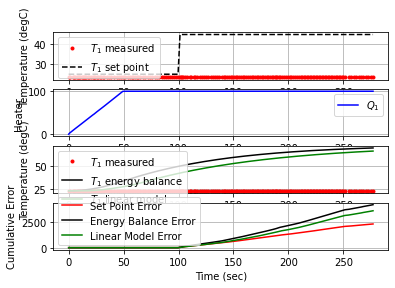

 281.4  45.00  23.61 100.00  13.97  98.82   0.00


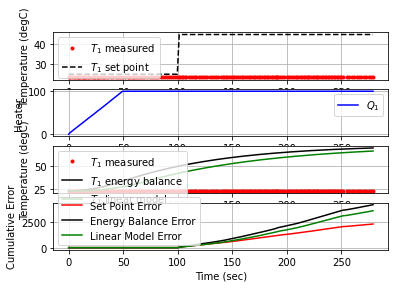

 283.8  45.00  23.61 100.00  13.97  98.82  -0.00


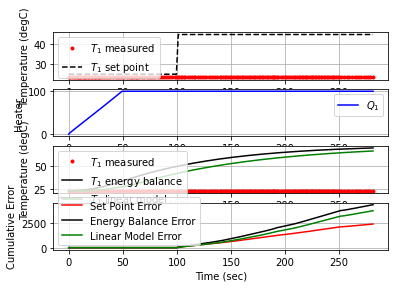

 286.3  45.00  23.62 100.00  13.96  98.82  -0.00


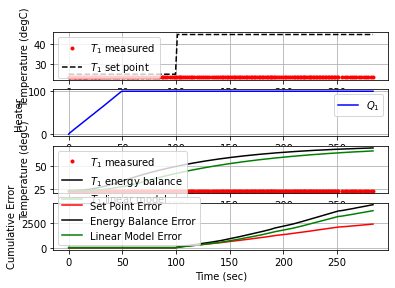

 288.7  45.00  23.60 100.00  13.97  98.82   0.00


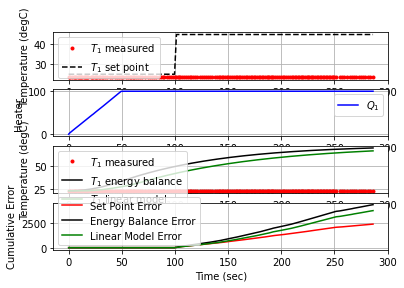

 291.1  45.00  23.61 100.00  13.97  98.82  -0.00


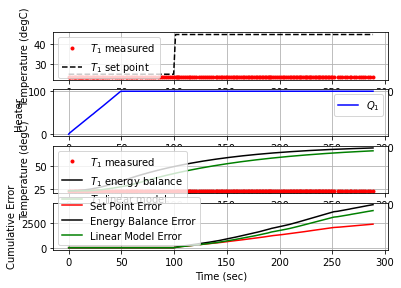

 294.0  45.00  23.61 100.00  13.97  98.82  -0.00


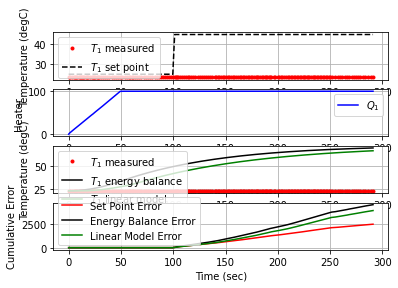

 296.8  45.00  23.60 100.00  13.97  98.82   0.00


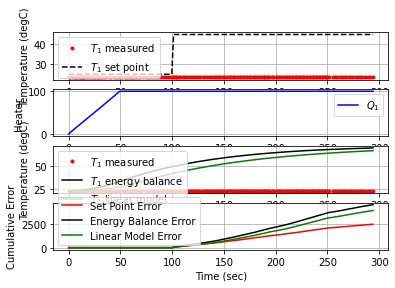

 299.0  45.00  23.64 100.00  13.95  98.82  -0.01


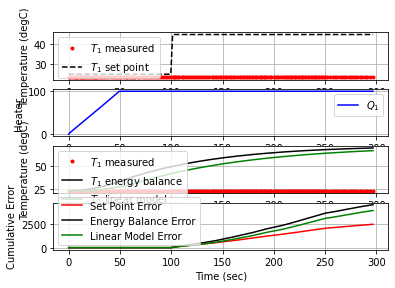

 301.2  45.00  23.57 100.00  13.99  98.82   0.01


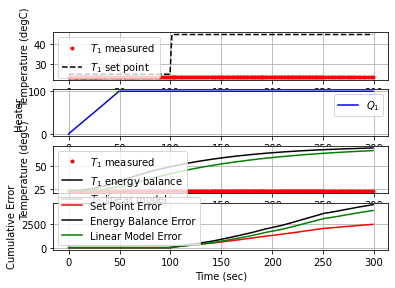

 303.6  45.00  23.55 100.00  14.01  98.82   0.00


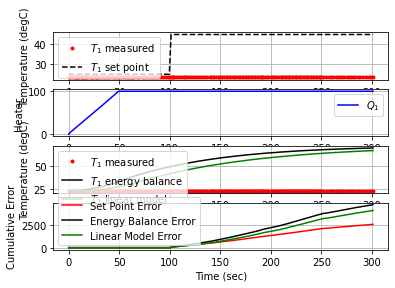

 305.8  45.00  23.58 100.00  13.99  98.82  -0.01


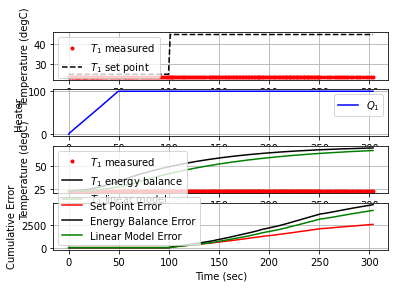

 308.3  45.00  23.64 100.00  13.95  98.82  -0.01


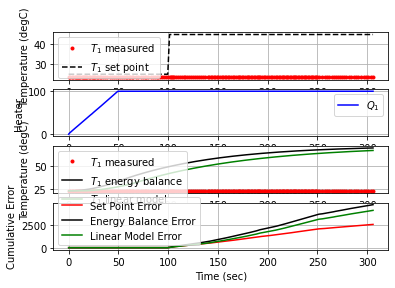

 310.5  45.00  23.54 100.00  14.01  98.82   0.02


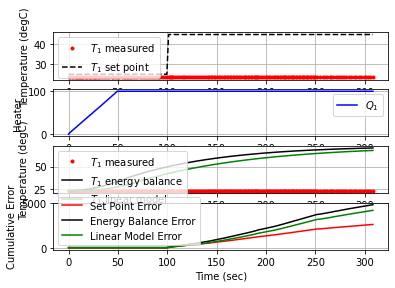

 313.4  45.00  23.58 100.00  13.99  98.82  -0.01


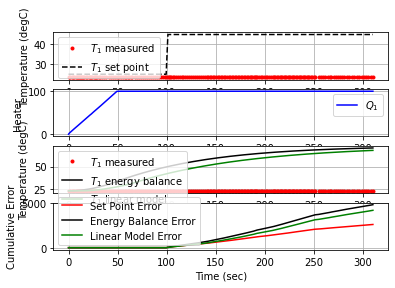

 315.8  45.00  23.59 100.00  13.98  98.82  -0.00


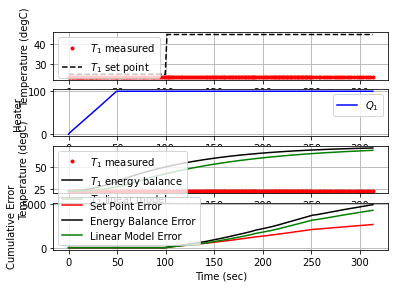

 318.4  45.00  23.59 100.00  13.98  98.82  -0.00


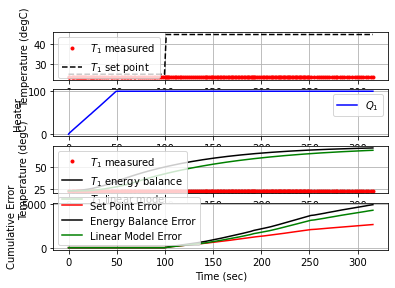

 321.0  45.00  23.65 100.00  13.94  98.82  -0.01


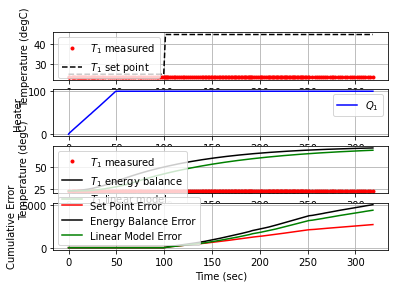

 326.8  45.00  23.62 100.00  13.96  98.82   0.00


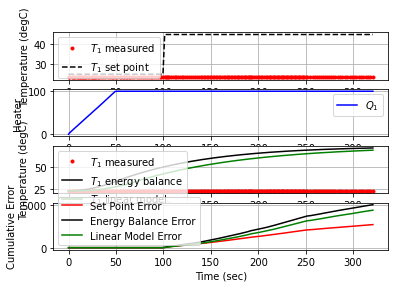

 330.1  45.00  23.63 100.00  13.95  98.82  -0.00


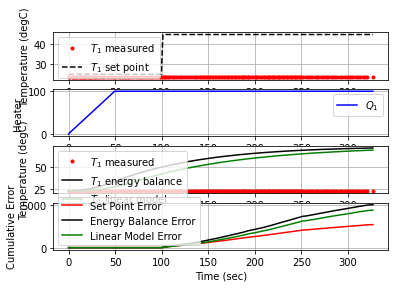

 332.7  45.00  23.58 100.00  13.99  98.82   0.01


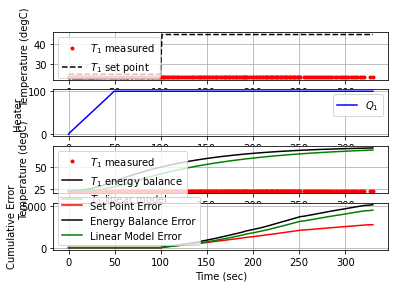

 335.0  45.00  23.60 100.00  13.97  98.82  -0.00


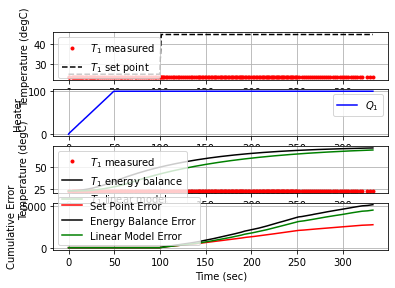

 336.5  45.00  23.63 100.00  13.95  98.82  -0.01


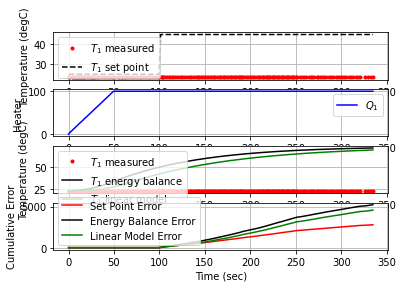

 339.1  45.00  23.55 100.00  14.01  98.82   0.01


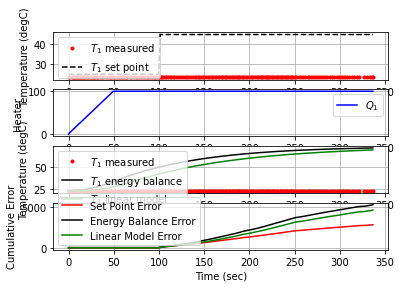

 341.1  45.00  23.61 100.00  13.97  98.82  -0.01


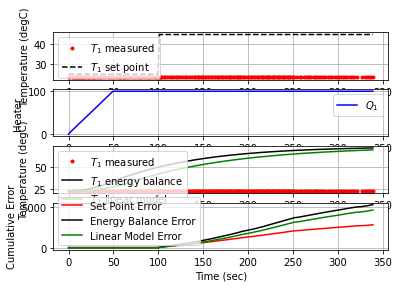

 343.1  45.00  23.67 100.00  13.93  98.82  -0.01


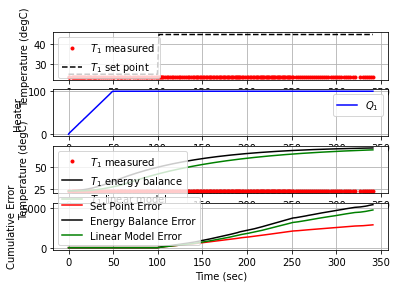

 345.1  45.00  23.66 100.00  13.93  98.82   0.00


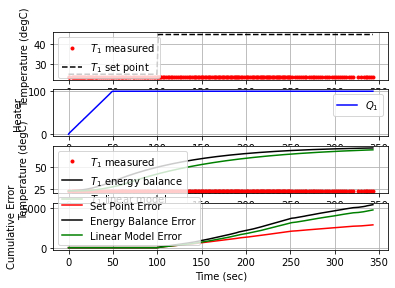

 347.1  45.00  23.54 100.00  14.01  98.82   0.03


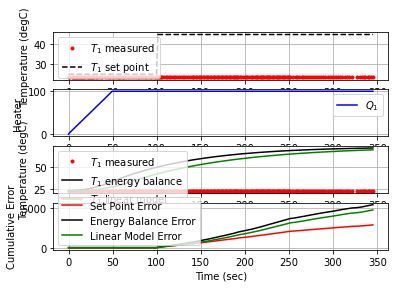

 349.3  45.00  23.56 100.00  14.00  98.82  -0.00


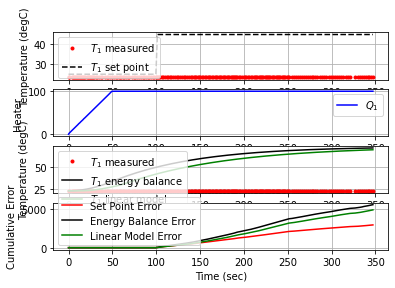

 351.4  45.00  23.80 100.00  13.84  98.82  -0.05


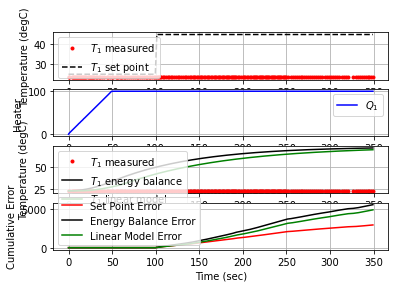

 354.1  45.00  23.73 100.00  13.89  98.82   0.01


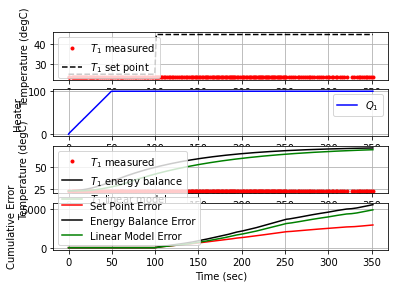

 356.3  45.00  23.66 100.00  13.93  98.82   0.01


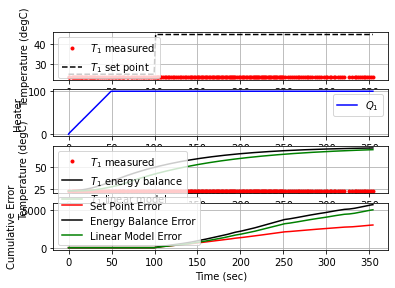

 358.3  45.00  23.76 100.00  13.87  98.82  -0.02


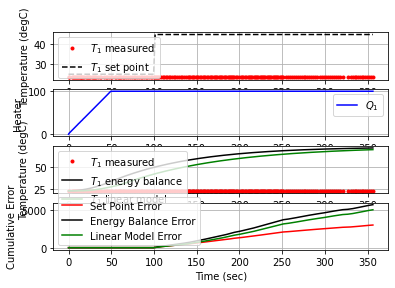

 360.5  45.00  23.71 100.00  13.90  98.82   0.01


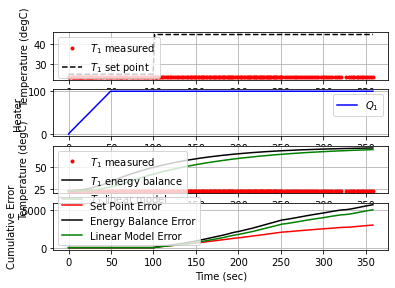

 362.4  45.00  23.79 100.00  13.85  98.82  -0.02


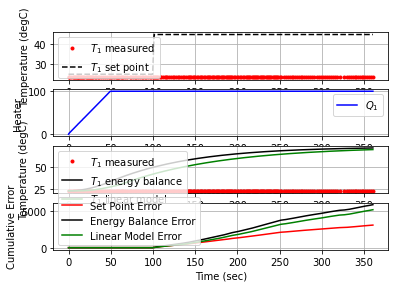

 364.5  45.00  23.73 100.00  13.89  98.82   0.01


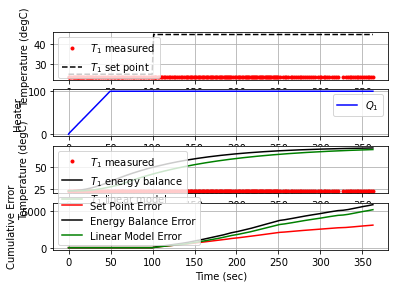

 365.8  45.00  23.76 100.00  13.87  98.82  -0.01


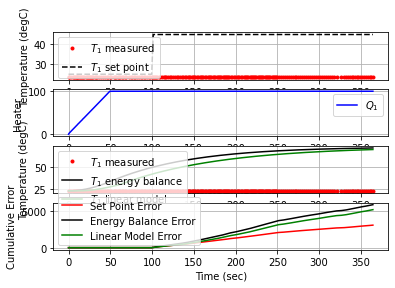

 366.9  45.00  23.83 100.00  13.82  98.82  -0.03


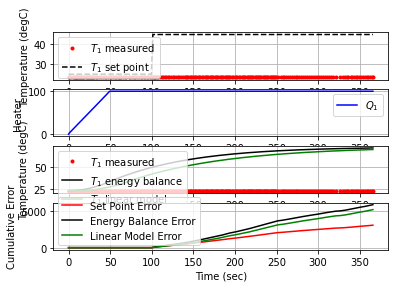

 368.2  45.00  23.84 100.00  13.82  98.82  -0.00


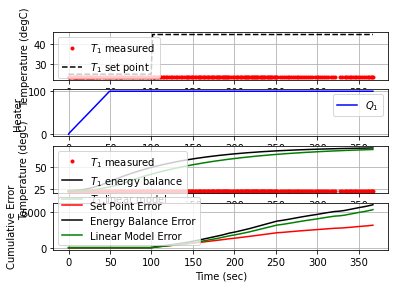

 369.8  45.00  23.89 100.00  13.78  98.82  -0.01


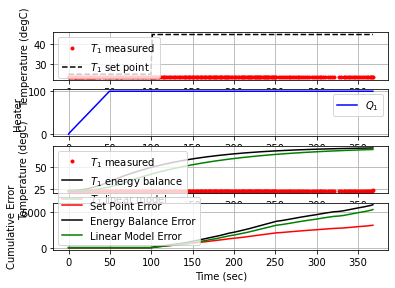

 371.7  45.00  24.02 100.00  13.70  98.82  -0.03


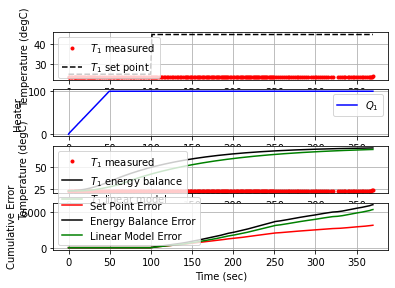

 373.8  45.00  24.07 100.00  13.67  98.82  -0.01


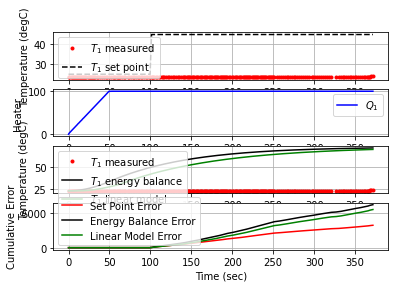

 375.8  45.00  24.33 100.00  13.50  98.82  -0.06


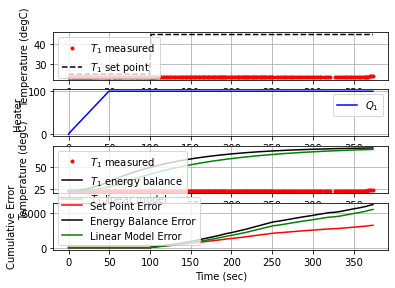

 378.0  45.00  24.49 100.00  13.39  98.82  -0.03


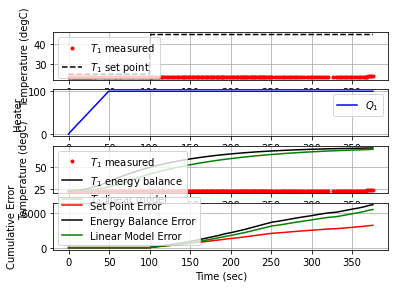

 380.0  45.00  24.73 100.00  13.23  98.82  -0.06


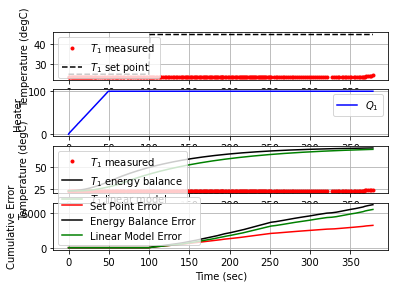

 381.9  45.00  25.00 100.00  13.06  98.82  -0.07


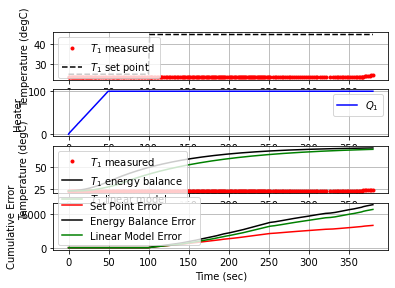

 384.0  45.00  25.23 100.00  12.91  98.82  -0.05


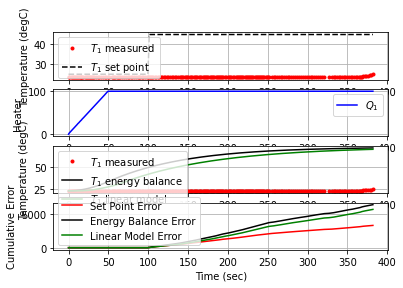

 386.1  45.00  25.48 100.00  12.75  98.82  -0.06


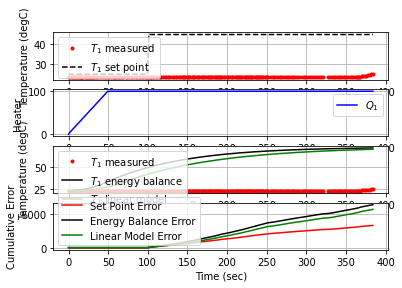

 388.8  45.00  25.89 100.00  12.48  98.82  -0.07


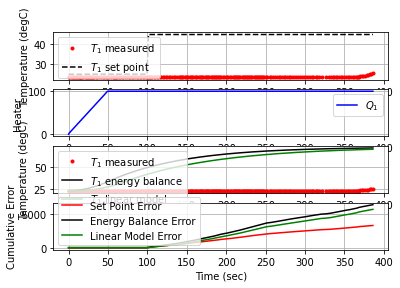

 391.0  45.00  26.32 100.00  12.20  98.82  -0.09


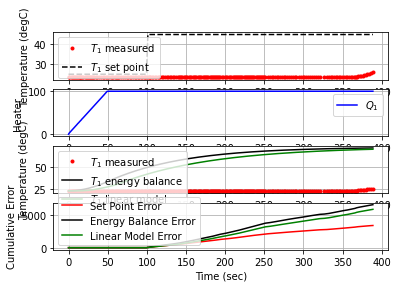

 393.2  45.00  26.63 100.00  11.99  98.82  -0.06


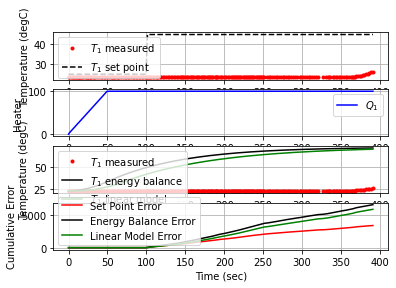

 395.2  45.00  26.75 100.00  11.92  98.82  -0.03


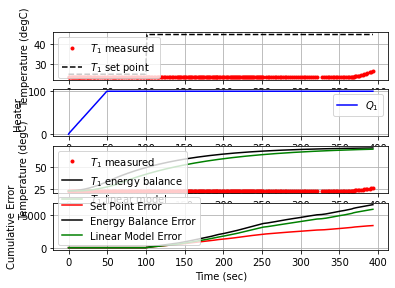

 397.3  45.00  27.12 100.00  11.67  98.82  -0.08


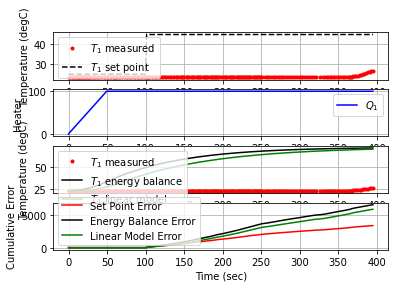

 399.5  45.00  27.50 100.00  11.43  98.82  -0.08


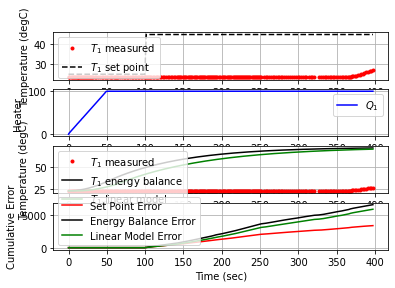

 401.5  45.00  27.85 100.00  11.20  98.82  -0.08


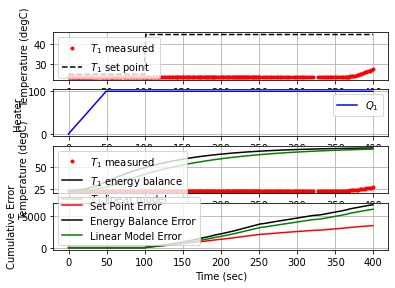

 404.3  45.00  28.31 100.00  10.90  98.82  -0.08


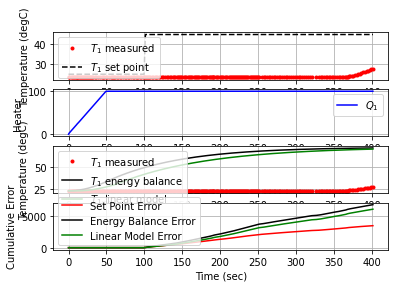

 407.0  45.00  28.64 100.00  10.68  98.82  -0.06


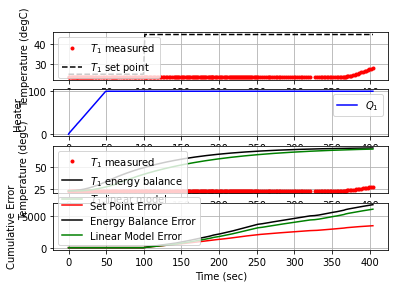

 408.6  45.00  28.81 100.00  10.57  98.82  -0.05


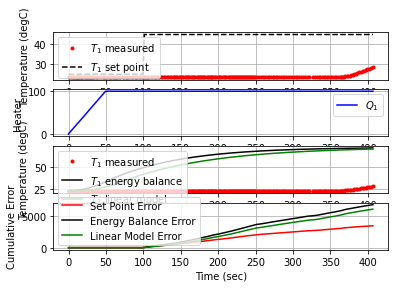

 410.5  45.00  29.22 100.00  10.30  98.82  -0.10


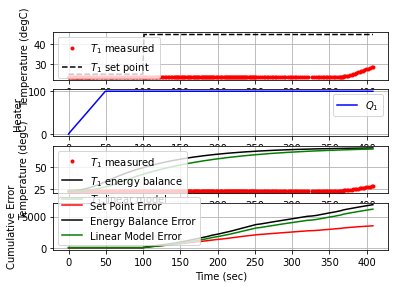

 413.2  45.00  29.55 100.00  10.09  98.82  -0.06


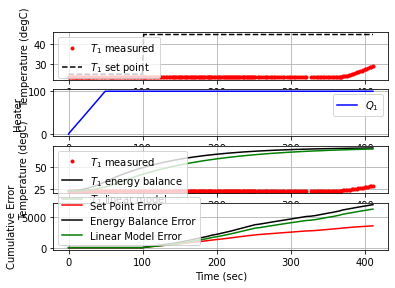

 415.0  45.00  29.87 100.00   9.88  98.82  -0.08


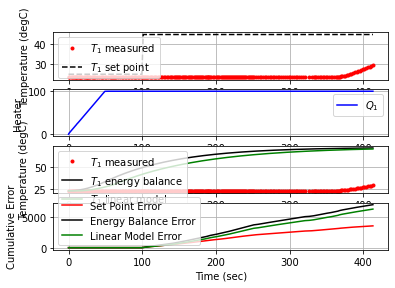

 417.6  45.00  30.38 100.00   9.55  98.82  -0.09


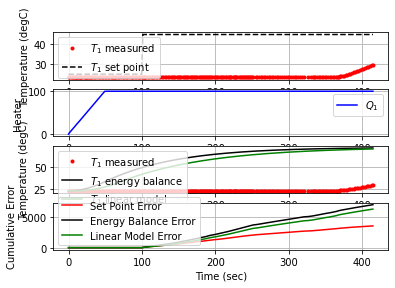

 419.8  45.00  30.68 100.00   9.35  98.82  -0.06


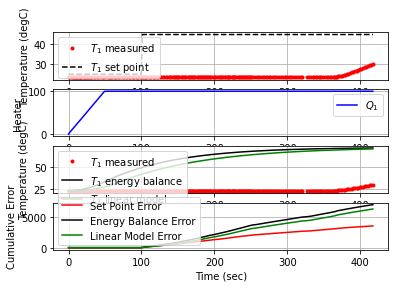

 421.9  45.00  30.89 100.00   9.21  98.82  -0.05


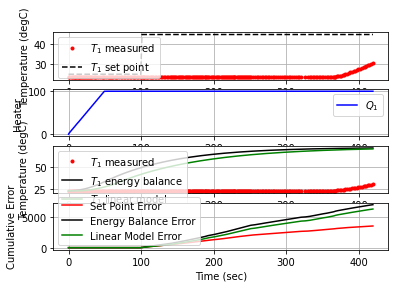

 424.1  45.00  31.24 100.00   8.98  98.82  -0.07


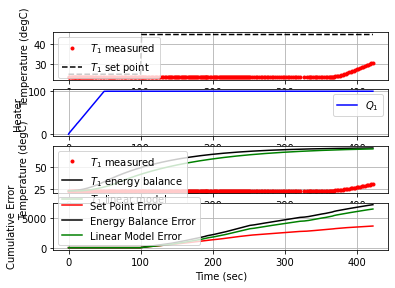

 426.4  45.00  31.31 100.00   8.94  98.82  -0.01


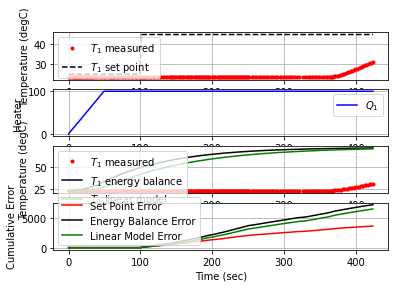

 428.6  45.00  31.53 100.00   8.80  98.82  -0.05


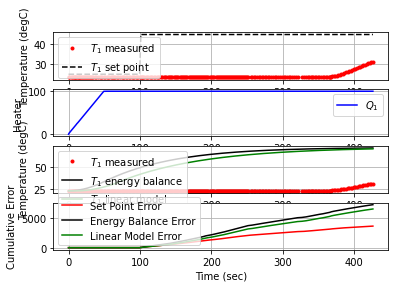

 430.2  45.00  31.92 100.00   8.54  98.82  -0.12


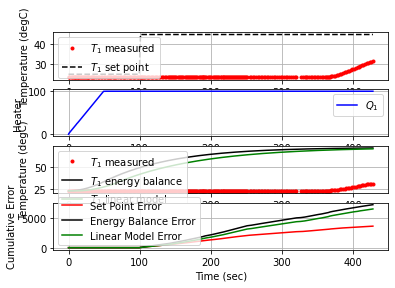

 431.5  45.00  32.13 100.00   8.40  98.82  -0.07


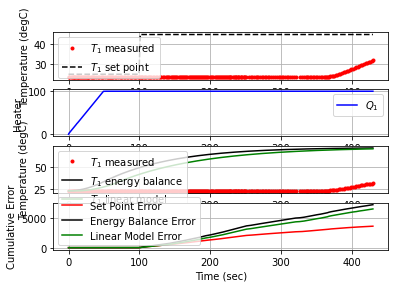

 432.6  45.00  32.40 100.00   8.23  98.82  -0.11


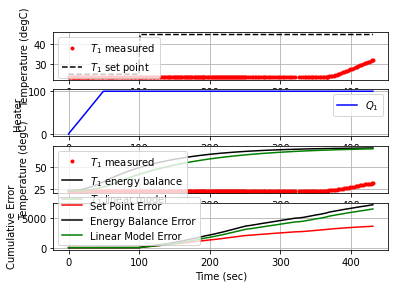

 434.4  45.00  32.61 100.00   8.09  98.82  -0.06


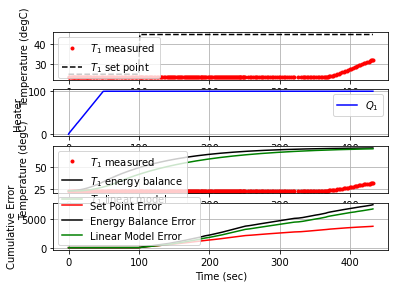

 436.5  45.00  33.04 100.00   7.81  98.82  -0.09


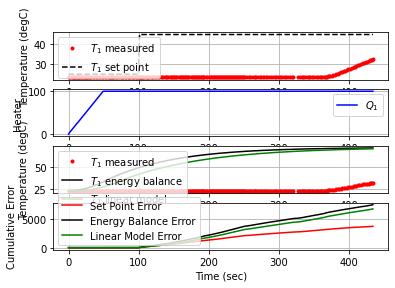

 438.7  45.00  33.54 100.00   7.48  98.82  -0.11


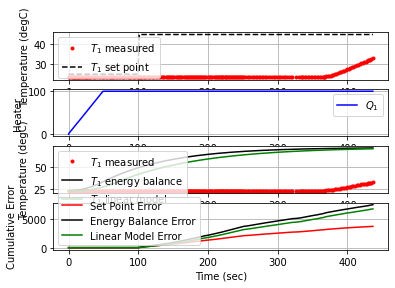

 441.0  45.00  33.67 100.00   7.40  98.82  -0.03


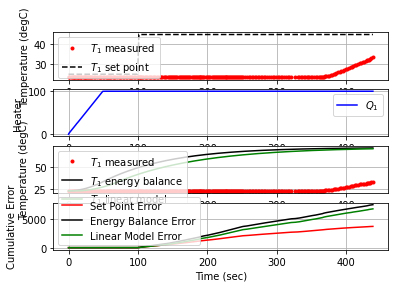

 444.0  45.00  33.96 100.00   7.21  98.82  -0.05


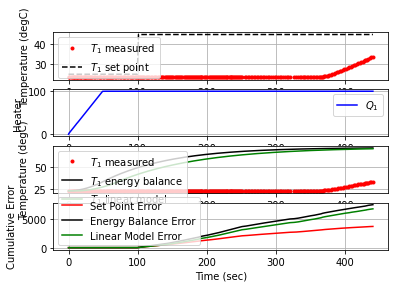

 447.6  45.00  34.19 100.00   7.06  98.82  -0.03


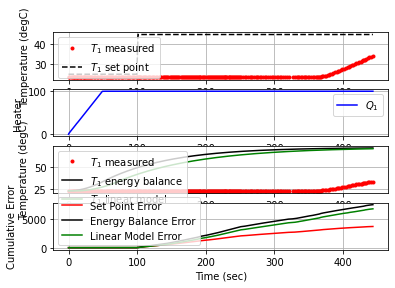

 450.7  45.00  34.34 100.00   6.96  98.82  -0.02


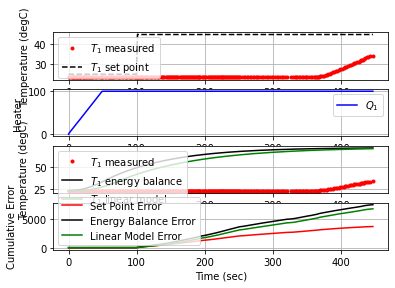

 454.0  45.00  34.64 100.00   6.77  98.82  -0.04


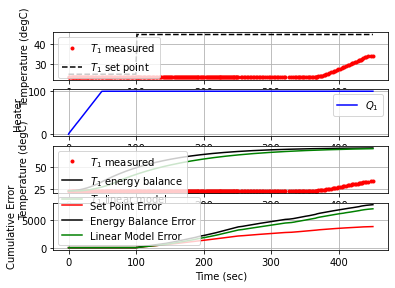

 457.1  45.00  34.81 100.00   6.65  98.82  -0.03


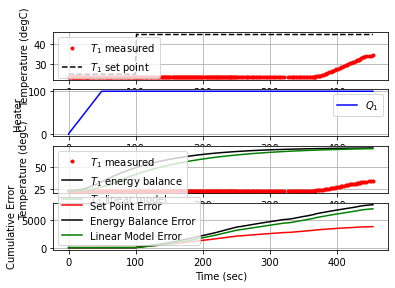

 460.7  45.00  35.19 100.00   6.41  98.82  -0.05


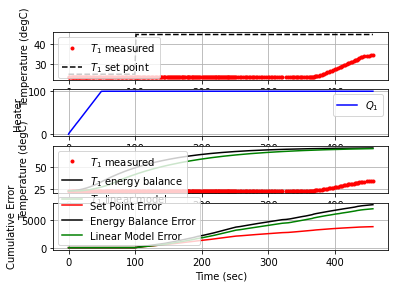

 463.8  45.00  35.58 100.00   6.15  98.82  -0.06


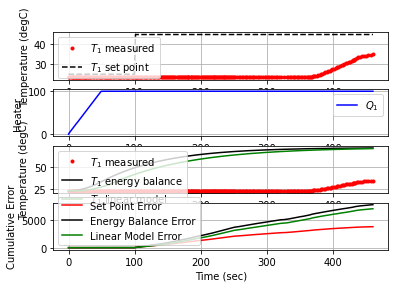

 466.6  45.00  36.25 100.00   5.72  98.82  -0.11


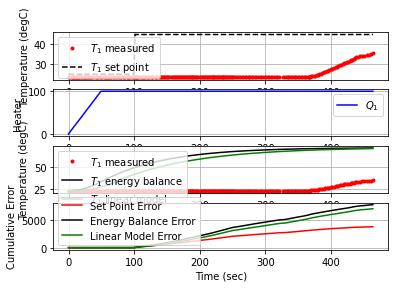

 469.6  45.00  37.05 100.00   5.19  98.82  -0.12


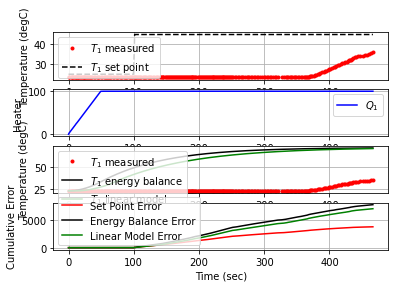

 473.0  45.00  37.35 100.00   5.00  98.82  -0.04


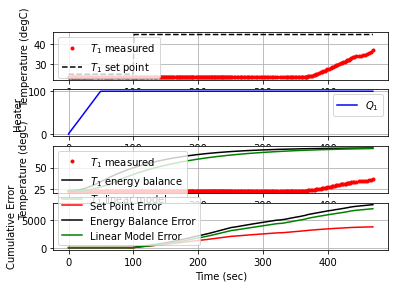

 476.4  45.00  37.84 100.00   4.68  98.82  -0.07


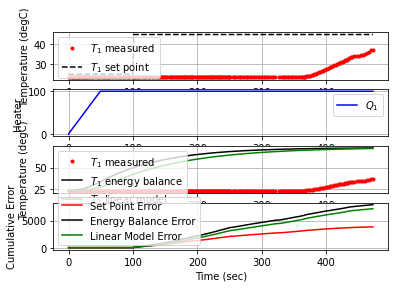

 480.1  45.00  38.72 100.00   4.11  98.82  -0.11


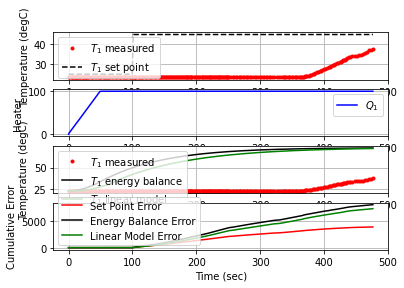

 483.8  45.00  39.47 100.00   3.61  98.82  -0.09


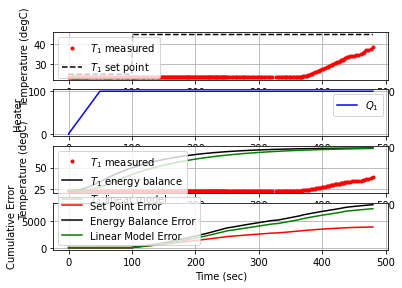

 486.6  45.00  39.46 100.00   3.62  98.82   0.00


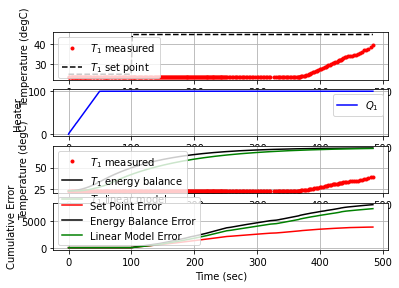

 489.1  45.00  39.74 100.00   3.43  98.82  -0.05


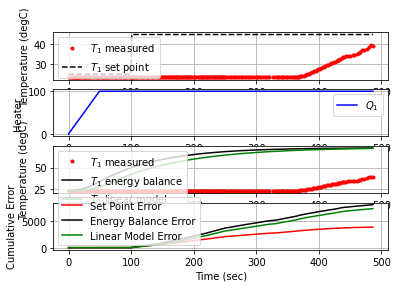

 491.6  45.00  39.86 100.00   3.35  98.82  -0.02


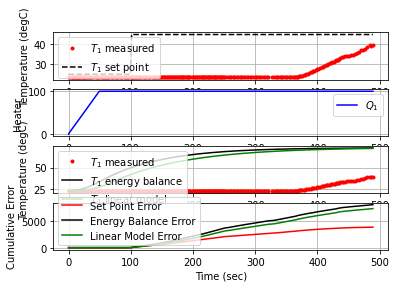

 494.6  45.00  39.92 100.00   3.32  98.82  -0.01


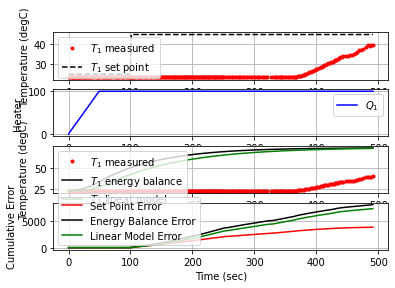

 497.1  45.00  39.89 100.00   3.33  98.82   0.01


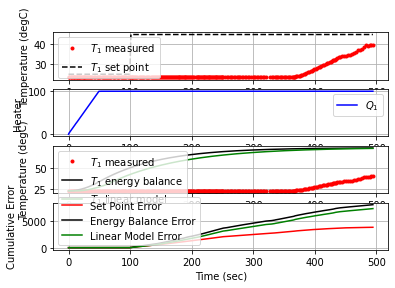

 499.7  45.00  39.79 100.00   3.40  98.82   0.02


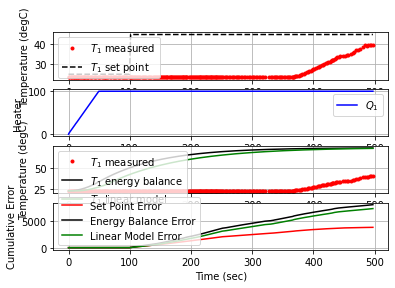

 502.3  45.00  39.70 100.00   3.46  98.82   0.02


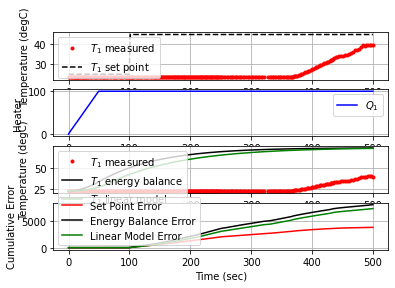

 505.1  45.00  39.93 100.00   3.31  98.82  -0.04


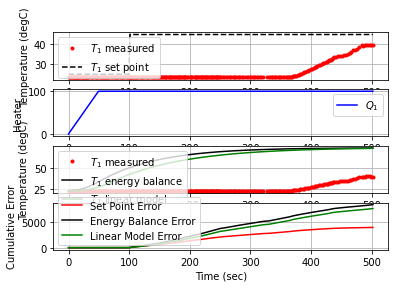

 507.7  45.00  40.38 100.00   3.02  98.82  -0.08


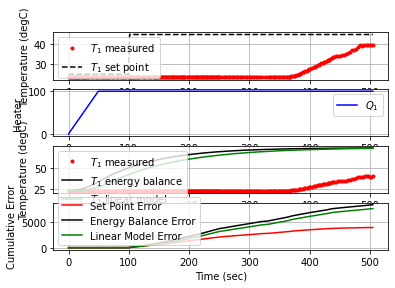

 510.6  45.00  40.66 100.00   2.83  98.82  -0.05


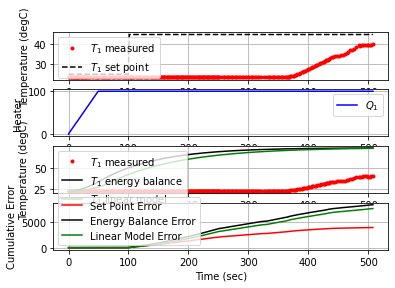

 513.4  45.00  40.77 100.00   2.76  98.82  -0.02


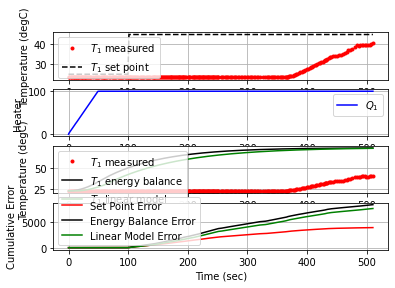

 516.0  45.00  41.40 100.00   2.35  98.82  -0.11


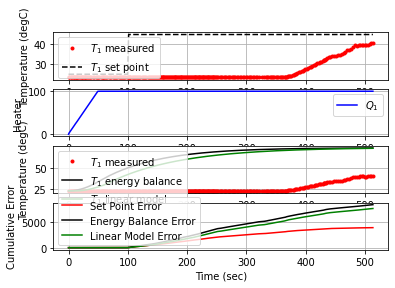

 518.7  45.00  42.06 100.00   1.92  98.82  -0.12


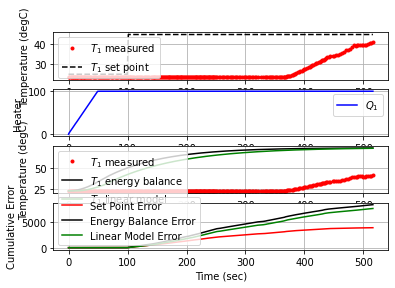

 521.4  45.00  42.57 100.00   1.58  98.82  -0.09


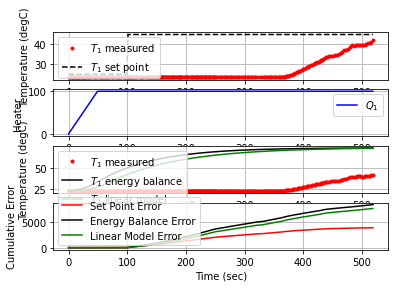

 524.6  45.00  42.85 100.00   1.40  98.82  -0.04


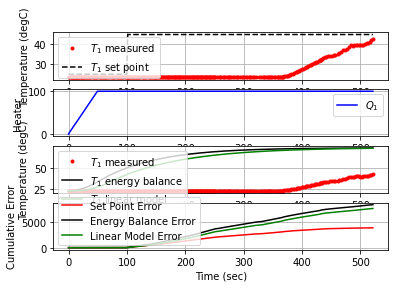

 527.1  45.00  43.19 100.00   1.18  98.82  -0.06


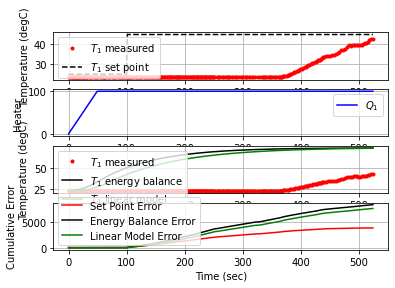

 529.7  45.00  43.29 100.00   1.11  98.82  -0.02


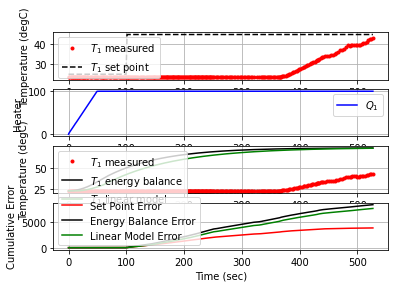

 532.4  45.00  43.66 100.00   0.87  98.82  -0.06


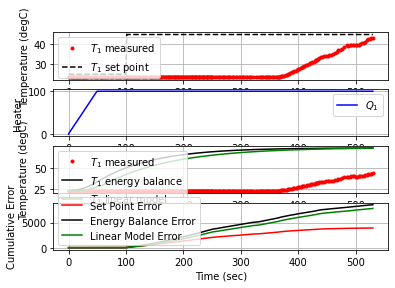

 535.2  45.00  44.16 100.00   0.55  98.82  -0.08


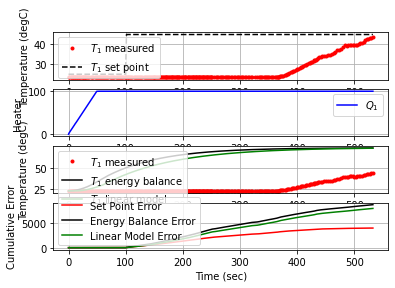

 537.4  45.00  44.39 100.00   0.39  98.82  -0.05


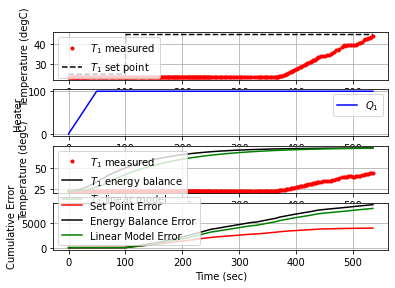

 539.2  45.00  44.35 100.00   0.42  98.82   0.01


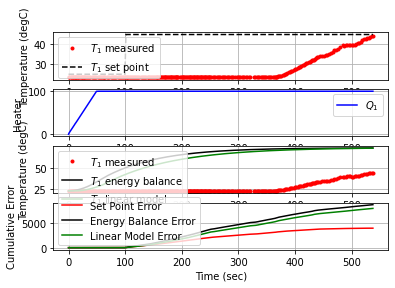

 541.8  45.00  44.37 100.00   0.41  98.82  -0.00


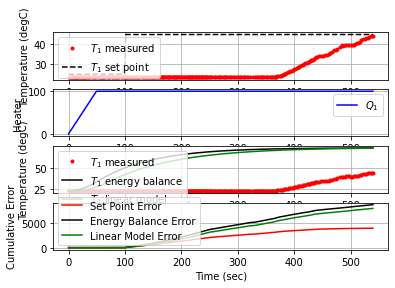

 544.6  45.00  44.75  99.82   0.16  99.72  -0.06


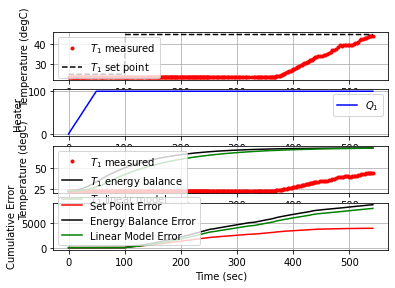

 547.1  45.00  45.09  99.31  -0.06  99.43  -0.06


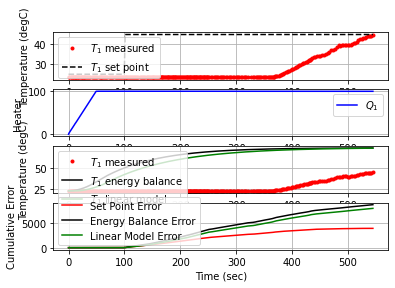

 549.1  45.00  45.06  99.25  -0.04  99.28   0.01


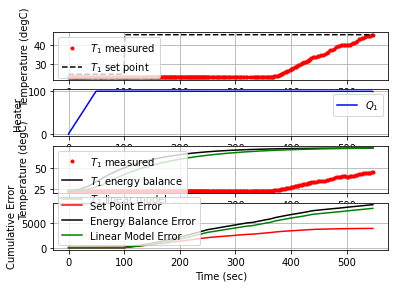

 551.2  45.00  45.22  98.50  -0.14  98.68  -0.03


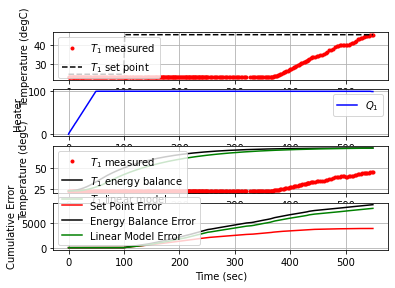

 553.4  45.00  45.47  97.01  -0.30  97.37  -0.05


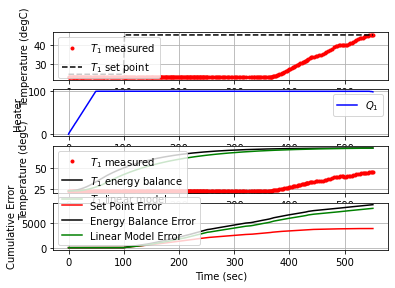

 555.2  45.00  45.48  95.91  -0.31  96.22  -0.00


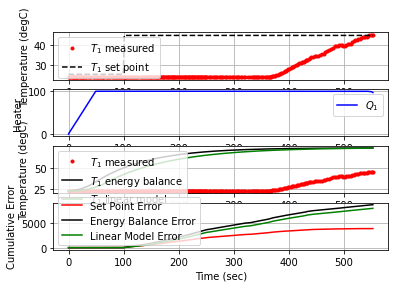

 557.1  45.00  45.47  94.79  -0.30  95.09   0.00


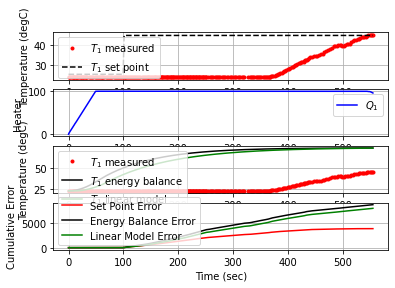

 559.0  45.00  45.63  93.07  -0.41  93.52  -0.04


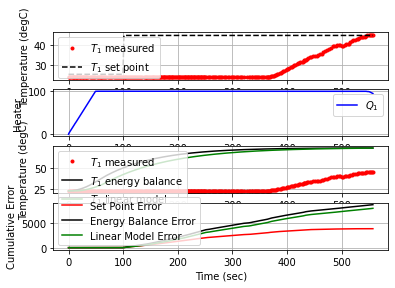

 560.9  45.00  45.81  91.01  -0.52  91.57  -0.04


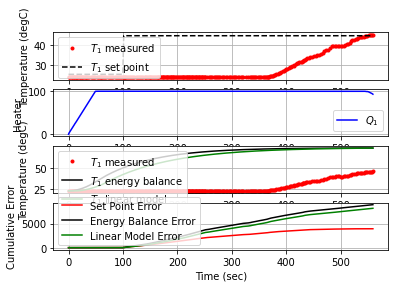

 563.2  45.00  46.10  87.55  -0.71  88.31  -0.06


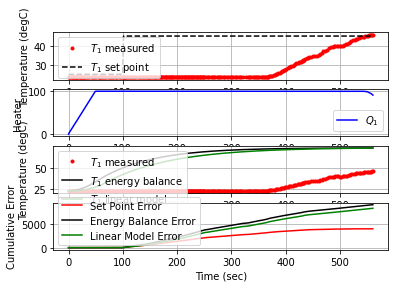

 565.7  45.00  46.33  83.08  -0.86  83.97  -0.04


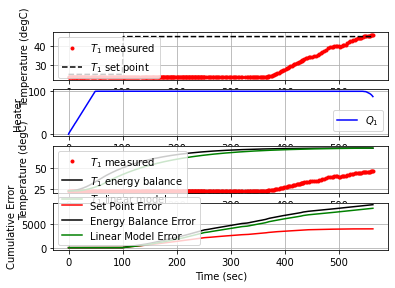

 568.3  45.00  46.69  77.20  -1.09  78.35  -0.06


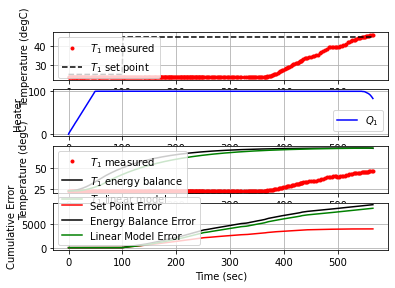

 570.6  45.00  46.59  72.74  -1.02  73.74   0.02


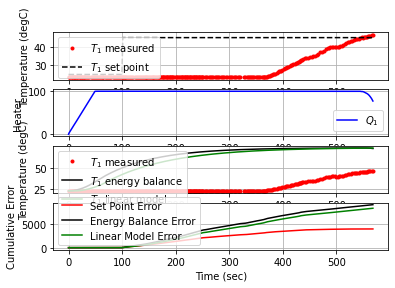

 572.7  45.00  46.95  67.14  -1.25  68.47  -0.08


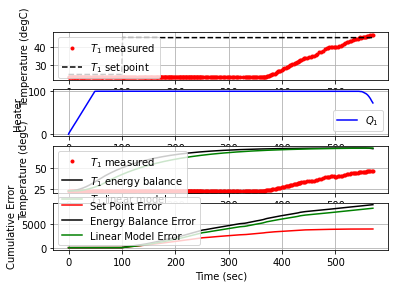

 575.1  45.00  46.90  61.44  -1.22  62.65   0.01


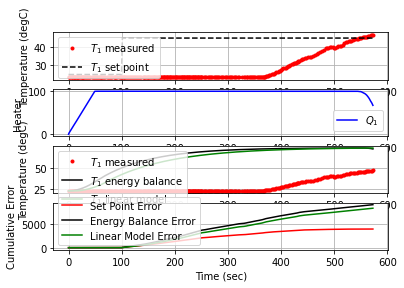

 577.2  45.00  46.97  56.10  -1.26  57.38  -0.02


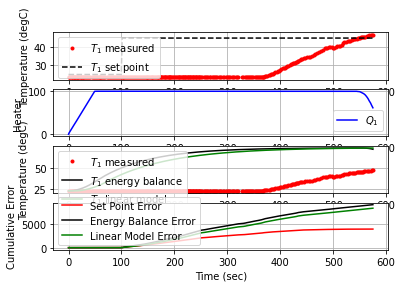

 579.2  45.00  47.16  50.39  -1.38  51.82  -0.04


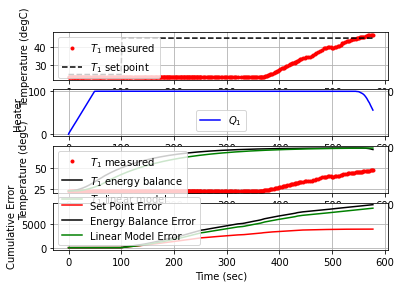

 581.2  45.00  46.97  45.48  -1.26  46.70   0.04


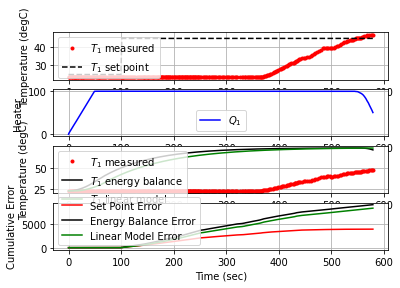

 583.5  45.00  46.89  39.99  -1.21  41.18   0.02


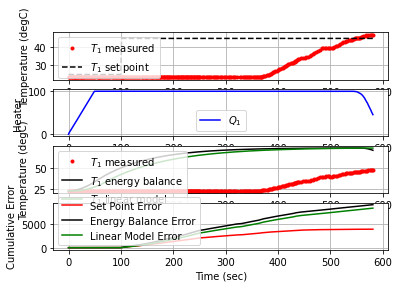

 585.5  45.00  47.12  34.36  -1.36  35.77  -0.05


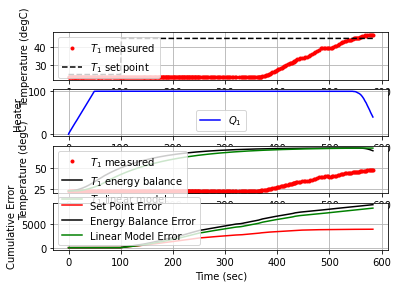

 587.9  45.00  47.39  27.00  -1.53  28.58  -0.05


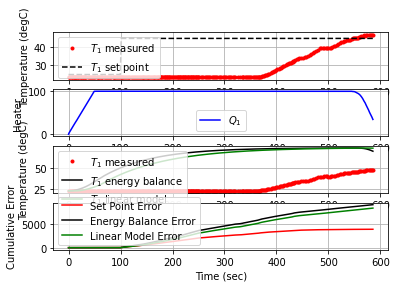

 589.9  45.00  47.62  20.07  -1.68  21.80  -0.05


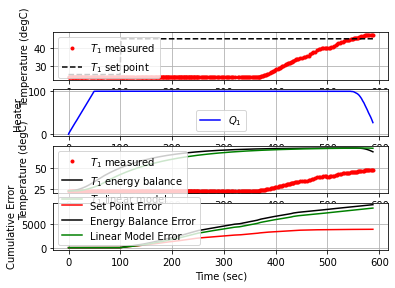

 592.0  45.00  47.88  12.28  -1.84  14.18  -0.06


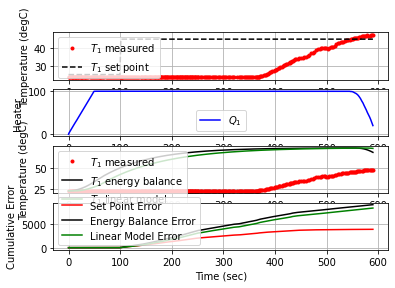

 594.5  45.00  48.17   1.94  -2.03   4.02  -0.05


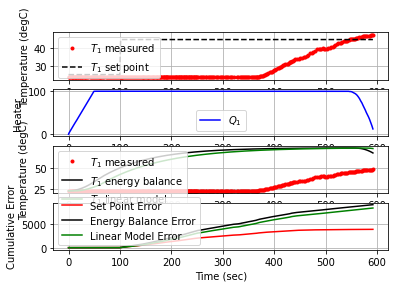

 596.5  45.00  48.20   0.00  -2.04   4.02  -0.01


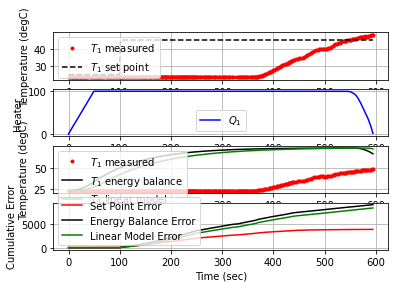

 598.7  45.00  48.17   0.00  -2.03   4.02   0.01


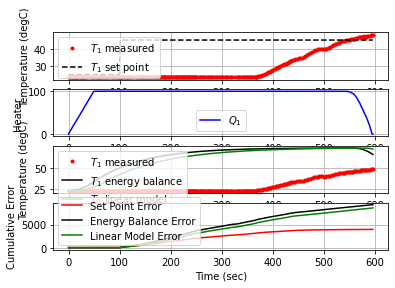

 600.5  45.00  48.22   0.00  -2.06   4.02  -0.01


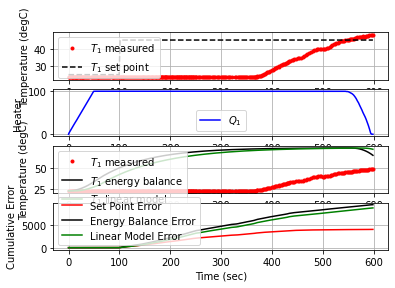

 601.6  45.00  48.19   0.00  -2.04   4.02   0.01


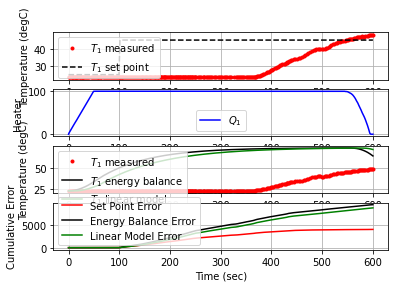

 603.6  45.00  48.03   0.00  -1.94   4.02   0.04


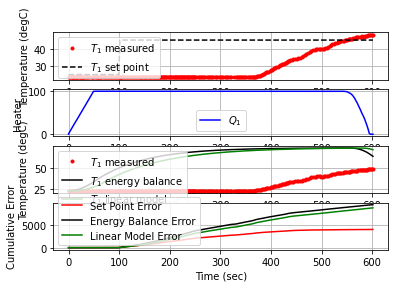

 605.7  45.00  47.97   0.00  -1.90   4.02   0.01


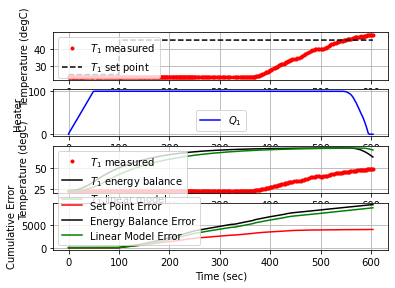

 607.8  45.00  47.59   0.00  -1.65   4.02   0.08


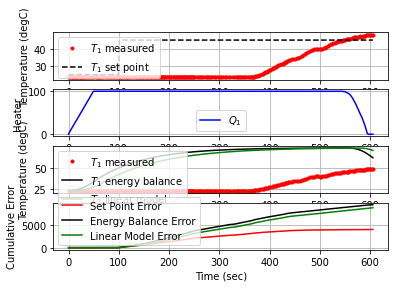

 610.1  45.00  47.28   0.00  -1.46   4.02   0.06


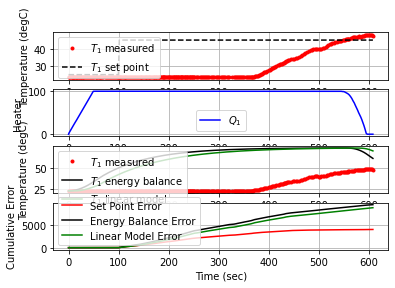

 612.2  45.00  46.86   0.00  -1.19   4.02   0.09


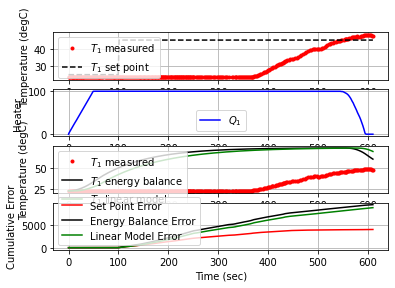

 614.5  45.00  46.57   0.00  -1.01   4.02   0.06


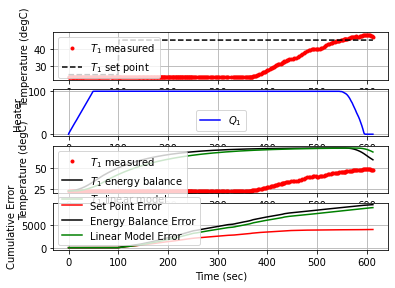

 616.4  45.00  46.61   0.00  -1.03   4.02  -0.01


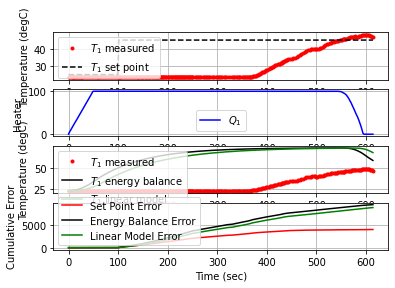

 618.3  45.00  46.46   0.00  -0.94   4.02   0.04


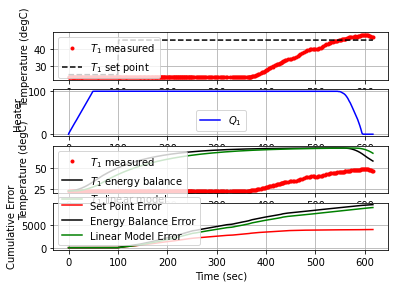

 620.6  45.00  46.13   0.13  -0.72   0.79   0.07


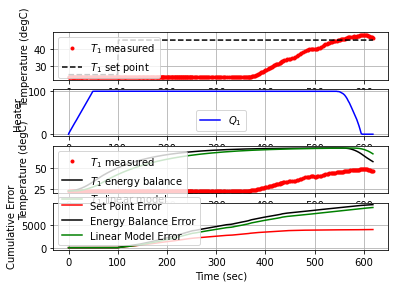

 622.5  45.00  45.69   0.00  -0.44   0.79   0.10


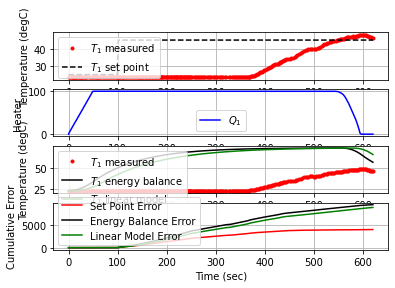

 625.1  45.00  45.43   0.00  -0.28   0.79   0.05


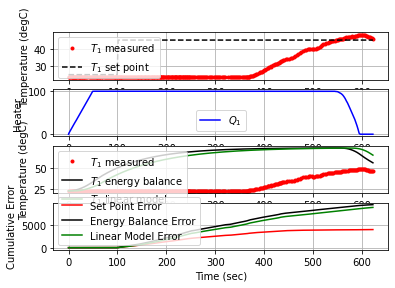

 626.9  45.00  45.24   0.12  -0.15   0.23   0.05


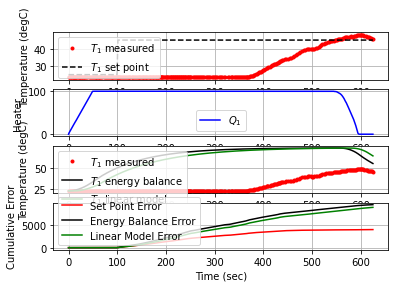

 628.9  45.00  44.92   0.56   0.05   0.44   0.07


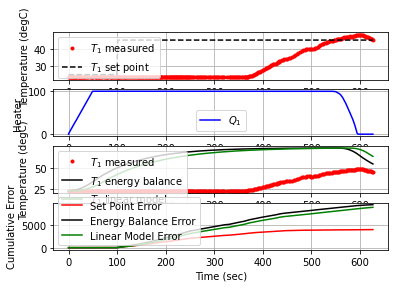

 631.3  45.00  44.49   2.41   0.33   1.99   0.08


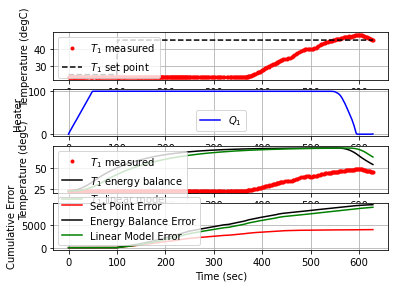

 633.5  45.00  44.36   4.28   0.41   3.84   0.03


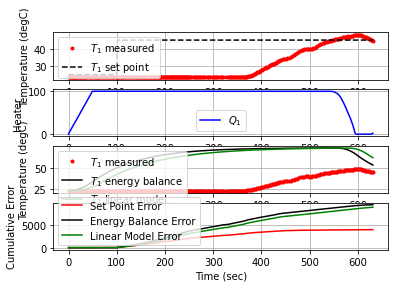

 635.6  45.00  44.14   6.74   0.56   6.13   0.05


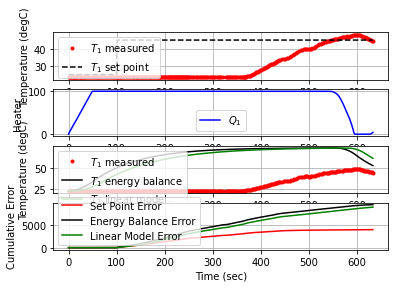

 637.6  45.00  44.00   9.46   0.65   8.78   0.03


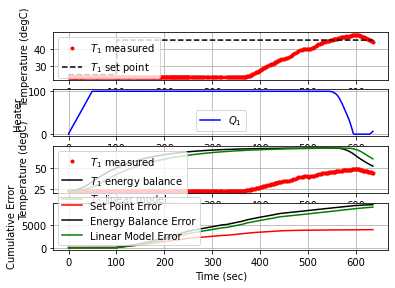

 639.7  45.00  43.70  13.31   0.84  12.40   0.06


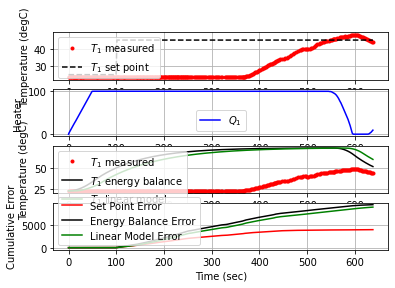

 641.8  45.00  43.72  16.65   0.83  15.83  -0.00


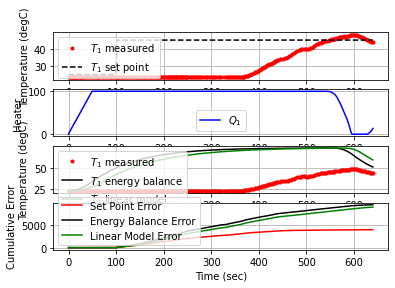

 644.3  45.00  43.56  21.49   0.93  20.53   0.03


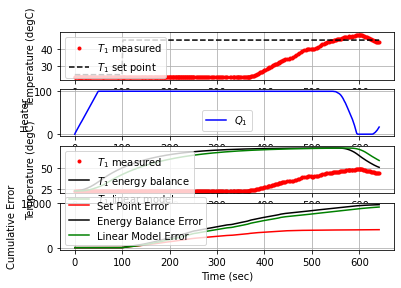

 646.3  45.00  43.27  26.24   1.12  25.05   0.07


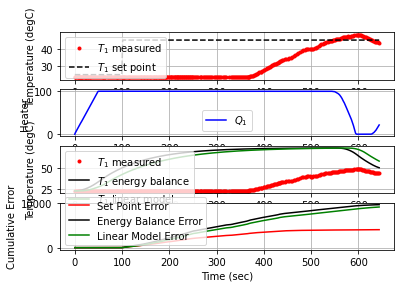

 648.4  45.00  42.88  32.32   1.37  30.86   0.09


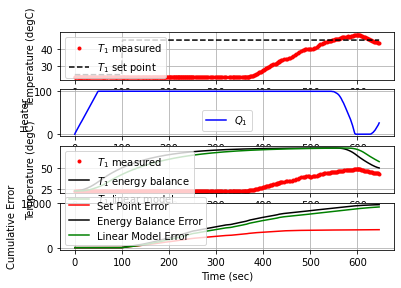

 650.5  45.00  42.51  39.38   1.62  37.69   0.08


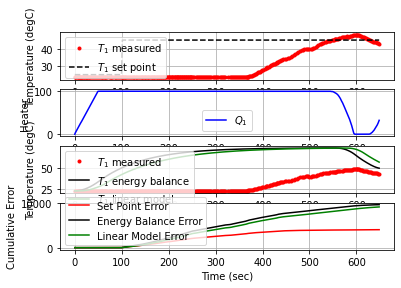

 652.5  45.00  42.17  46.96   1.84  45.05   0.08


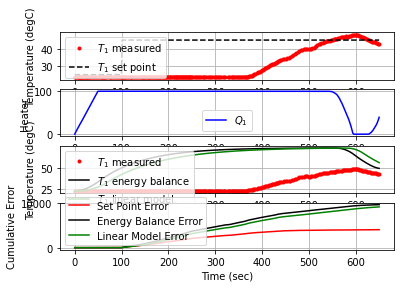

 655.1  45.00  42.08  56.79   1.90  54.87   0.02


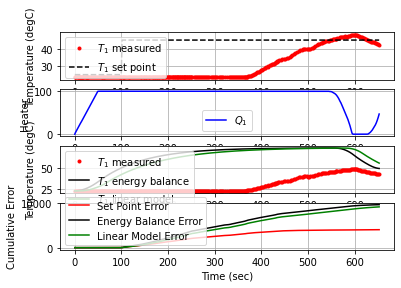

 657.3  45.00  42.23  64.72   1.80  62.94  -0.03


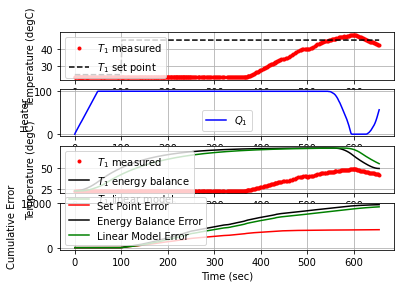

 659.4  45.00  42.36  71.94   1.72  70.25  -0.03


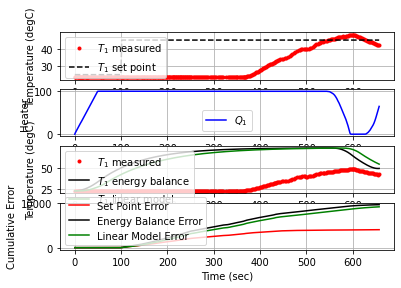

 661.5  45.00  42.37  79.25   1.71  77.54  -0.00


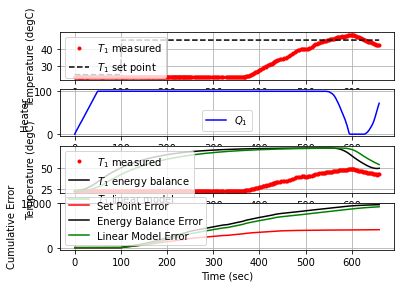

 663.2  45.00  42.48  84.57   1.64  82.96  -0.03


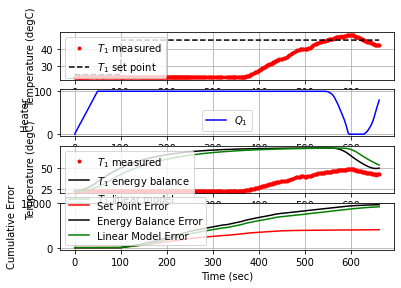

 664.4  45.00  42.08  89.66   1.90  87.61   0.15


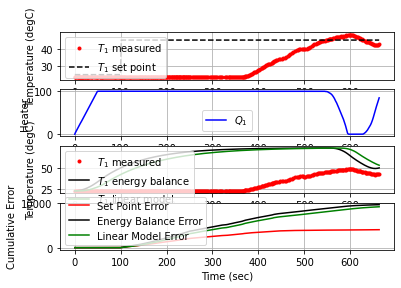

 665.6  45.00  42.00  94.38   1.95  92.40   0.03


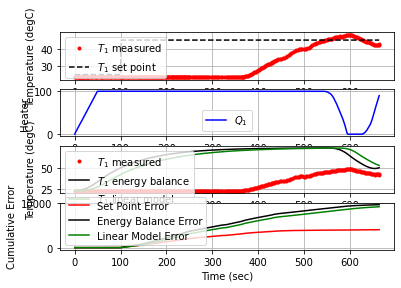

 666.7  45.00  41.86  98.94   2.04  96.84   0.06


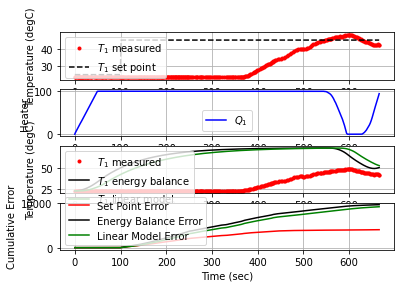

 668.1  45.00  41.89 100.00   2.03  96.84  -0.01


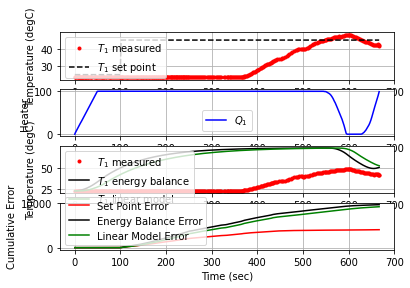

 669.2  45.00  41.87 100.00   2.04  96.84   0.01


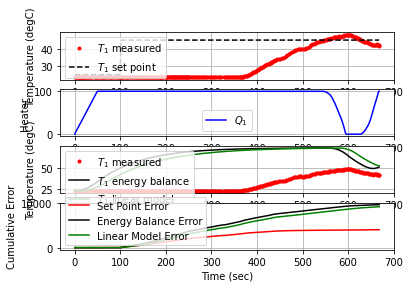

 671.0  45.00  42.10 100.00   1.89  96.84  -0.06


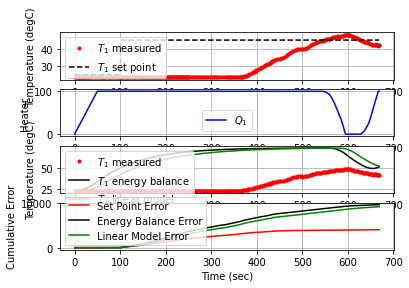

 673.4  45.00  42.01 100.00   1.95  96.84   0.02


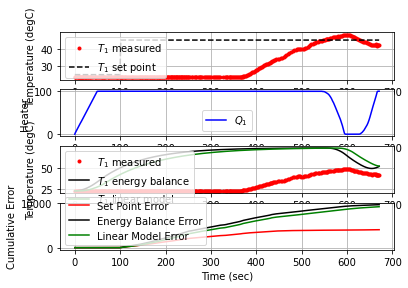

 675.3  45.00  41.88 100.00   2.03  96.84   0.03


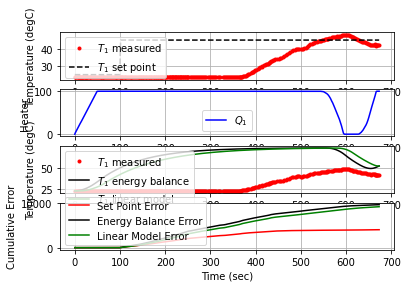

 677.4  45.00  42.10 100.00   1.89  96.84  -0.05


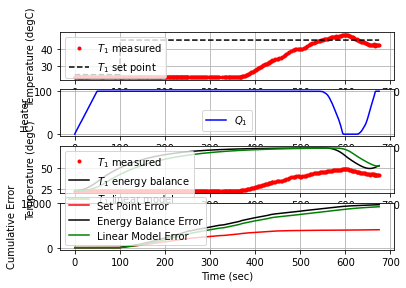

 679.5  45.00  42.35 100.00   1.73  96.84  -0.06


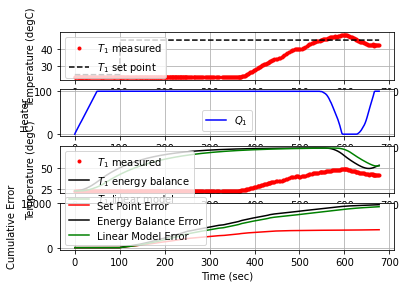

 681.7  45.00  42.51 100.00   1.62  96.84  -0.03


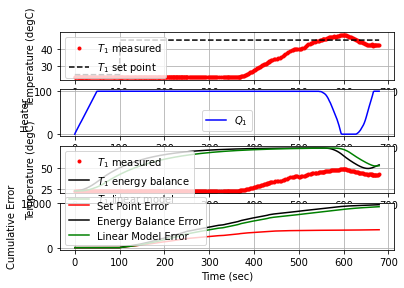

 684.0  45.00  42.50 100.00   1.63  96.84   0.00


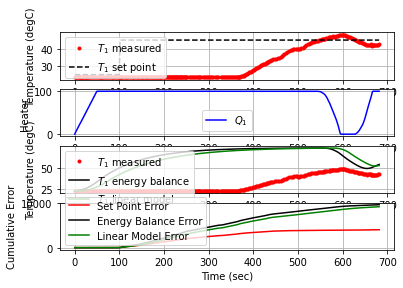

 687.4  45.00  42.59 100.00   1.57  96.84  -0.01


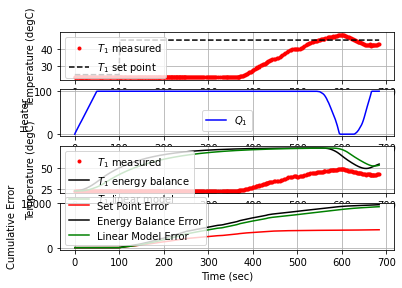

 691.3  45.00  43.26 100.00   1.13  96.84  -0.08


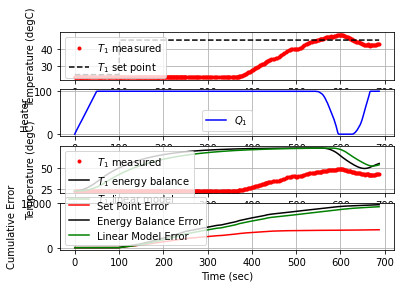

 693.9  45.00  43.66 100.00   0.87  96.84  -0.07


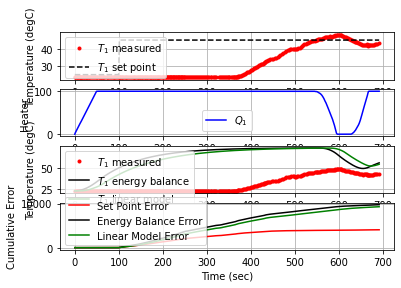

 697.5  45.00  44.17 100.00   0.54  96.84  -0.07


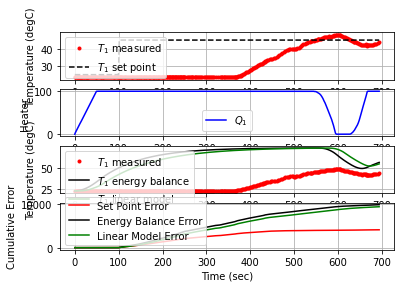

 700.7  45.00  44.56  98.94   0.28  98.71  -0.05


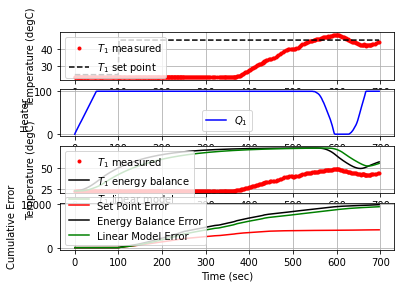

 702.8  45.00  44.69  99.70   0.20  99.53  -0.03


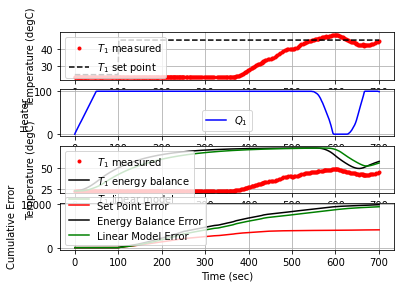

 704.6  45.00  44.80 100.00   0.13  99.53  -0.03


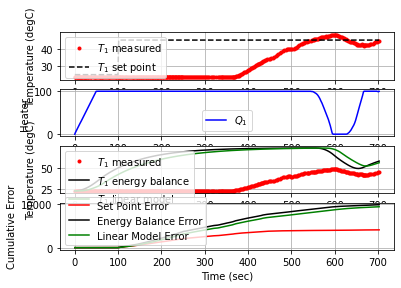

 706.4  45.00  45.11  99.12  -0.07  99.27  -0.08


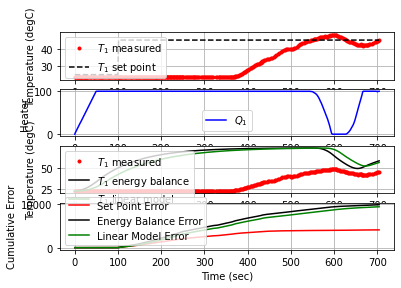

 709.3  45.00  45.35  97.71  -0.23  97.97  -0.04


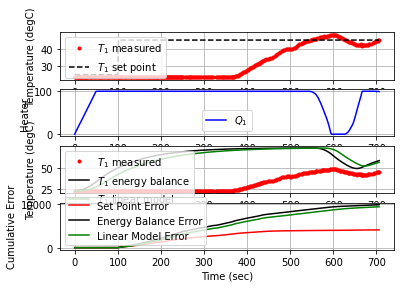

 712.8  45.00  45.38  96.02  -0.24  96.26  -0.00


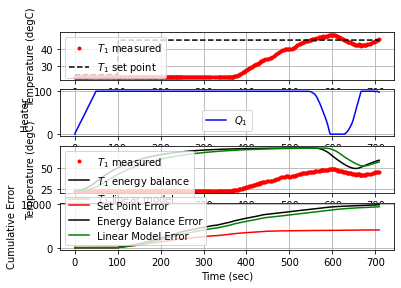

 715.8  45.00  45.63  93.36  -0.41  93.80  -0.04


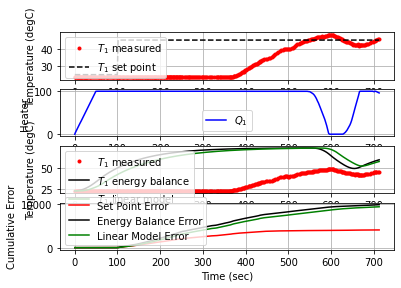

 719.3  45.00  45.48  91.37  -0.31  91.66   0.02


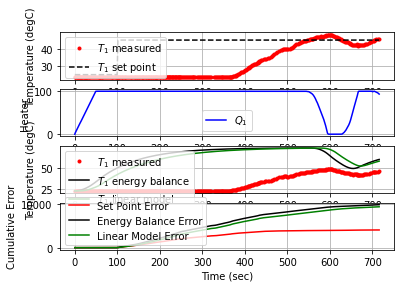

 723.6  45.00  45.66  87.56  -0.43  88.01  -0.02


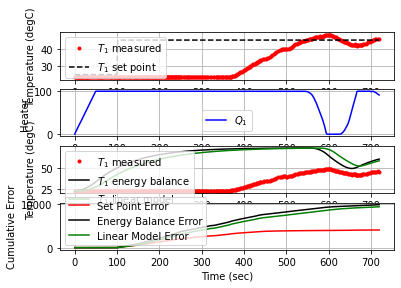

 728.6  45.00  45.95  81.22  -0.61  81.86  -0.03


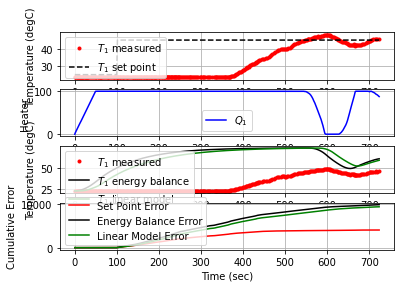

 732.3  30.00  46.37   0.00 -10.42  81.86  -0.05


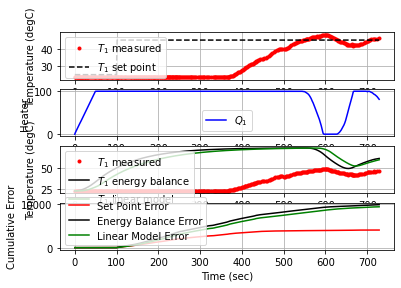

 735.4  30.00  46.45   7.18 -10.48  17.66  -0.01


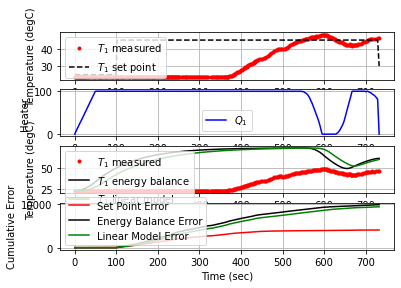

 736.7  30.00  46.32   0.00 -10.39  17.66   0.04


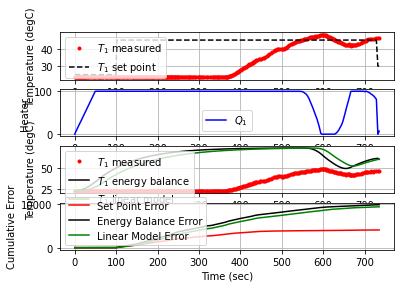

 737.8  30.00  46.08   0.00 -10.24  17.66   0.10


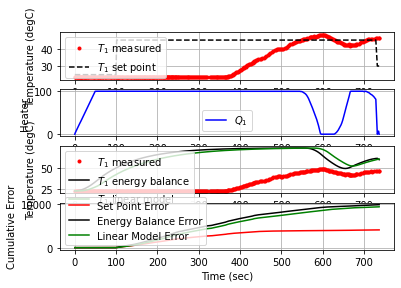

 739.2  30.00  45.87   0.00 -10.11  17.66   0.07


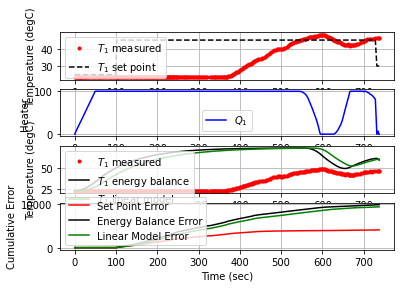

 740.3  30.00  45.67   0.00  -9.98  17.66   0.08


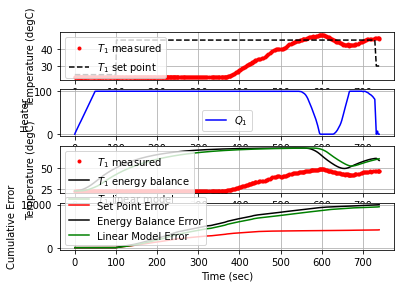

 741.4  30.00  45.63   0.00  -9.95  17.66   0.02


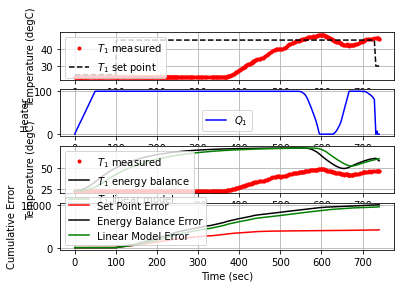

 742.5  30.00  45.53   0.00  -9.89  17.66   0.04


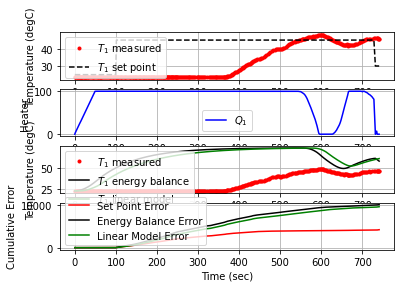

 743.7  30.00  45.43   0.00  -9.83  17.66   0.04


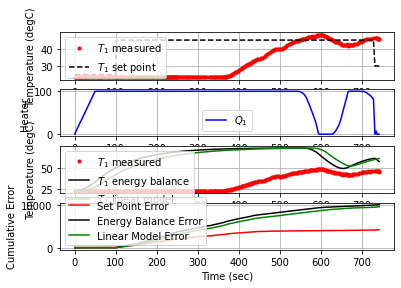

 744.9  30.00  45.37   0.00  -9.79  17.66   0.02


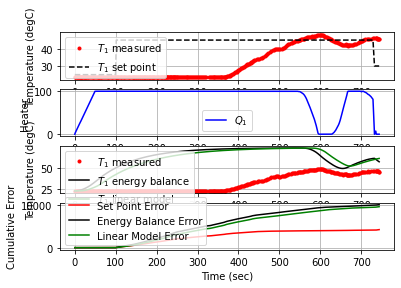

 746.0  30.00  45.37   0.00  -9.79  17.66  -0.00


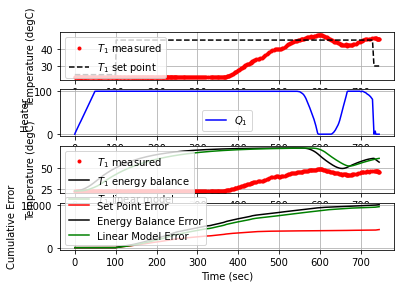

 747.2  30.00  45.27   0.00  -9.72  17.66   0.04


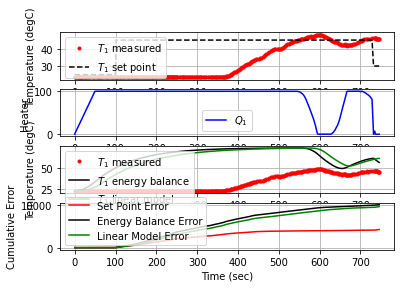

 748.3  30.00  45.14   0.00  -9.64  17.66   0.05


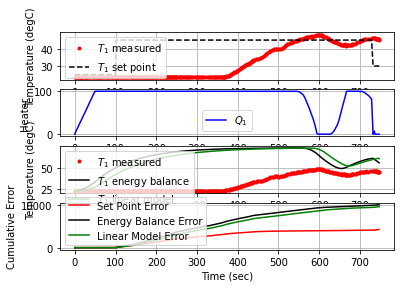

 749.4  30.00  45.06   0.00  -9.59  17.66   0.03


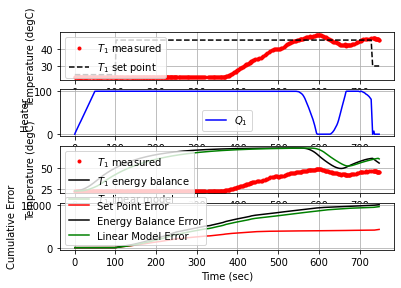

 750.7  30.00  45.01   0.00  -9.56  17.66   0.02


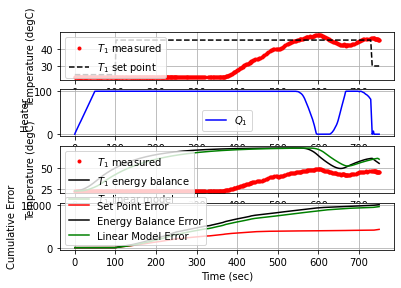

 752.0  30.00  44.99   0.00  -9.55  17.66   0.01


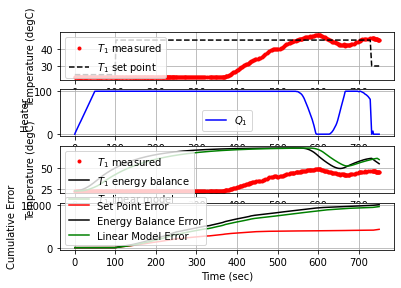

 753.2  30.00  44.97   0.00  -9.53  17.66   0.01


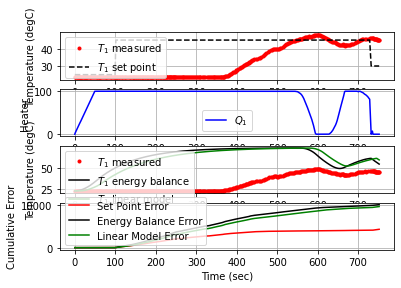

 754.3  30.00  44.84   0.00  -9.45  17.66   0.05


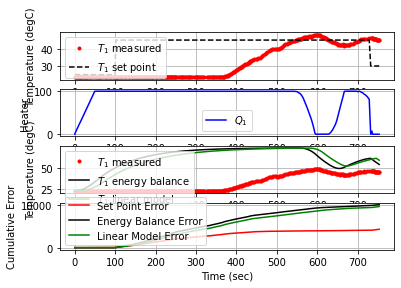

 755.4  30.00  44.55   0.00  -9.26  17.66   0.12


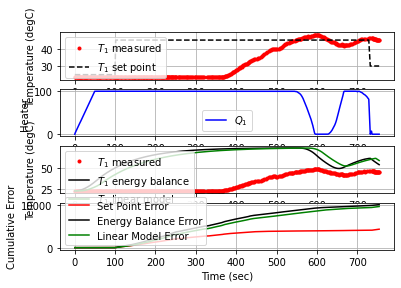

 756.5  30.00  44.70   0.00  -9.36  17.66  -0.06


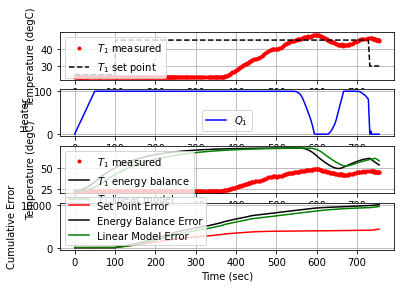

 757.8  30.00  44.63   0.00  -9.32  17.66   0.03


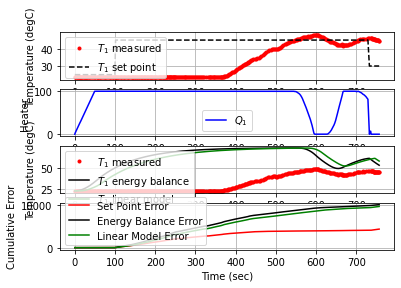

 758.8  30.00  44.42   0.00  -9.18  17.66   0.09


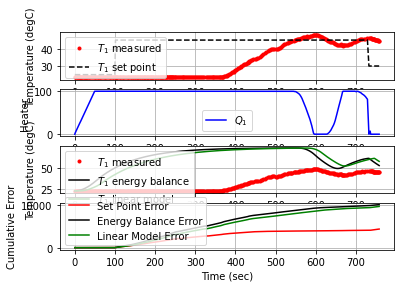

 760.0  30.00  44.39   0.00  -9.16  17.66   0.01


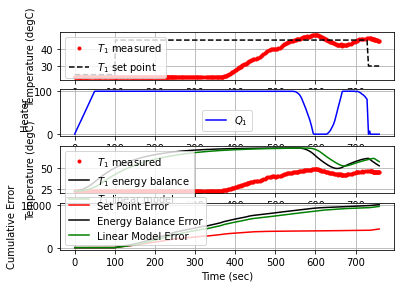

 761.1  30.00  44.22   0.00  -9.05  17.66   0.07


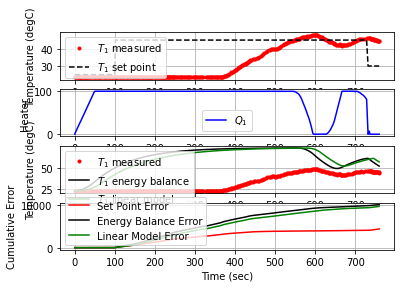

 762.3  30.00  43.85   0.00  -8.82  17.66   0.14


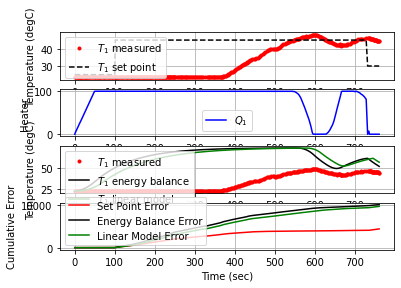

 763.8  30.00  43.48   0.00  -8.58  17.66   0.11


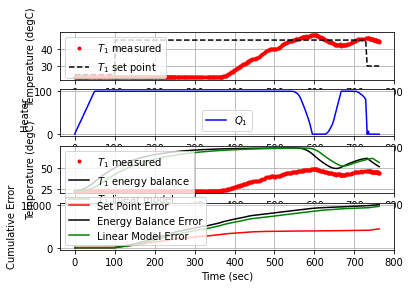

 765.0  30.00  43.23   0.00  -8.42  17.66   0.09


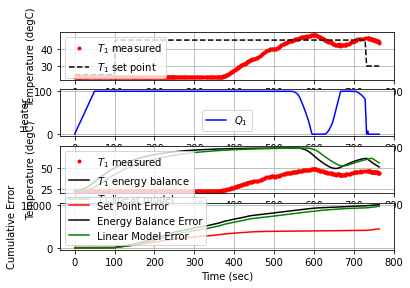

 766.4  30.00  42.85   0.00  -8.18  17.66   0.12


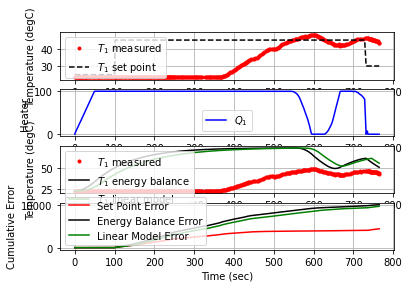

 767.7  30.00  42.74   0.00  -8.11  17.66   0.04


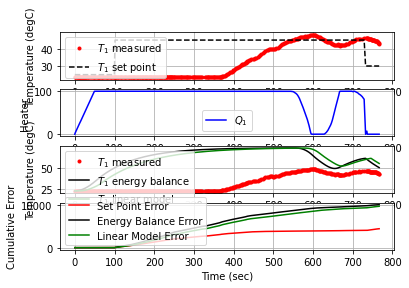

 769.1  30.00  42.54   0.00  -7.98  17.66   0.06


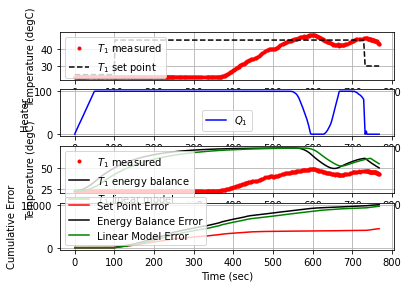

 770.5  30.00  42.29   0.00  -7.83  17.66   0.09


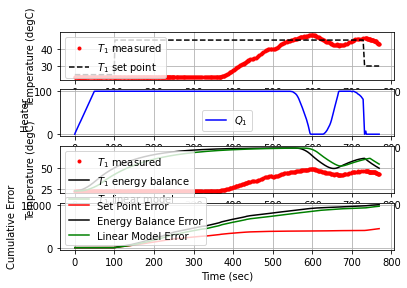

 771.9  30.00  42.17   0.00  -7.75  17.66   0.04


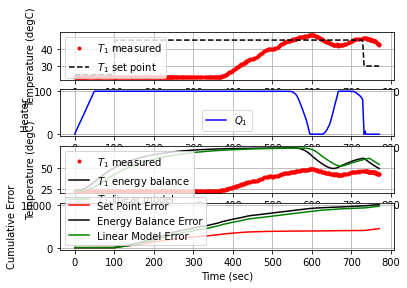

 773.3  30.00  41.88   0.00  -7.56  17.66   0.09


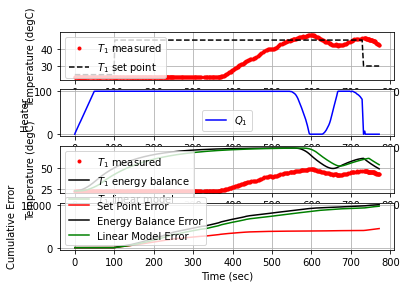

 774.6  30.00  41.82   0.00  -7.53  17.66   0.02


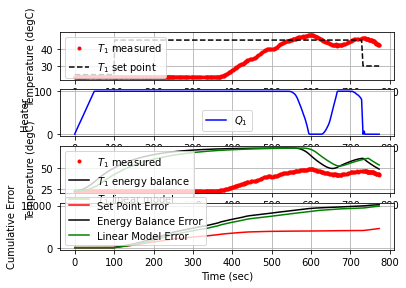

 776.2  30.00  41.99   0.00  -7.63  17.66  -0.05


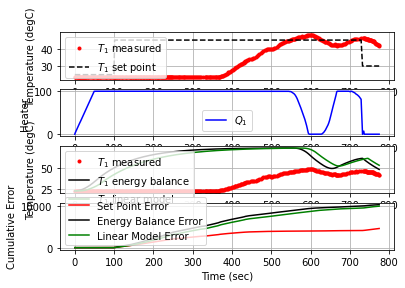

 777.6  30.00  41.84   0.00  -7.54  17.66   0.05


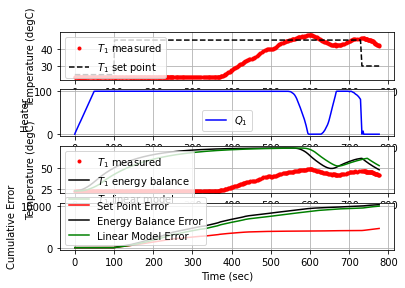

 778.7  30.00  41.72   0.00  -7.46  17.66   0.05


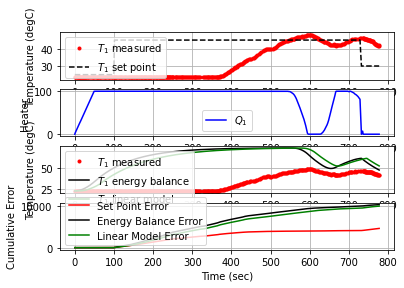

 780.0  30.00  41.57   0.00  -7.37  17.66   0.05


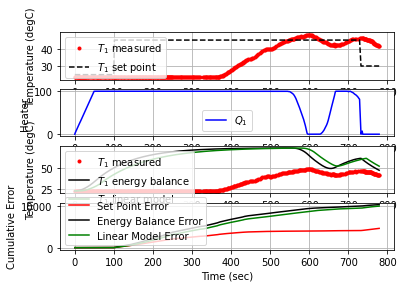

 781.3  30.00  41.45   0.00  -7.29  17.66   0.04


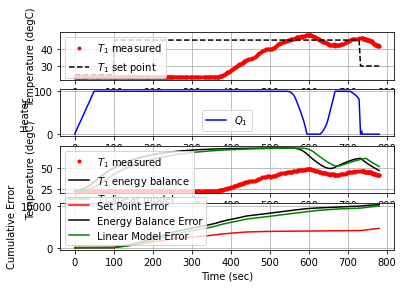

 782.8  30.00  41.43   0.00  -7.28  17.66   0.01


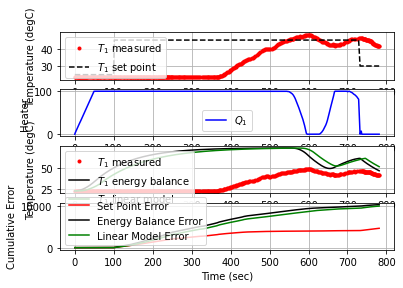

 784.2  30.00  41.36   0.00  -7.23  17.66   0.02


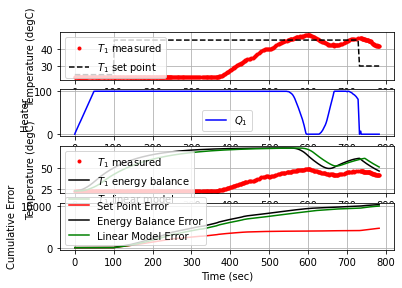

 785.7  30.00  41.28   0.00  -7.18  17.66   0.02


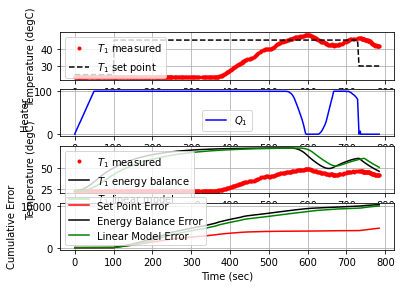

 787.9  30.00  41.14   0.00  -7.09  17.66   0.03


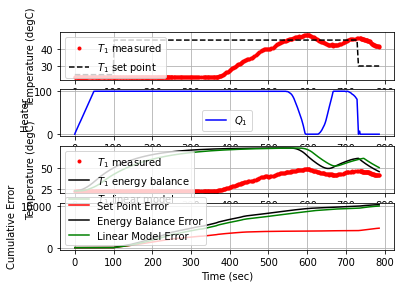

 790.1  30.00  41.12   0.00  -7.08  17.66   0.00


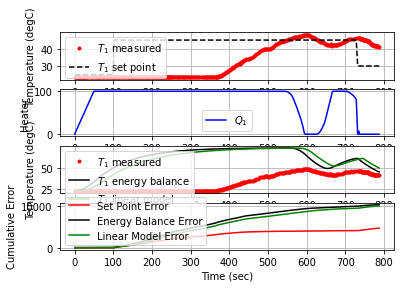

 792.6  30.00  40.62   0.00  -6.76  17.66   0.09


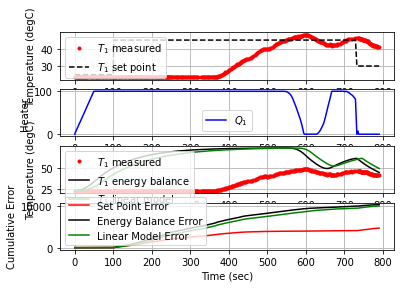

 795.0  30.00  40.15   0.00  -6.46  17.66   0.09


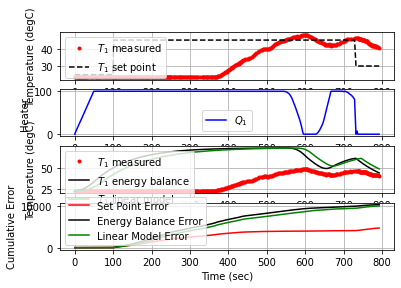

 797.1  30.00  39.85   0.00  -6.27  17.66   0.06


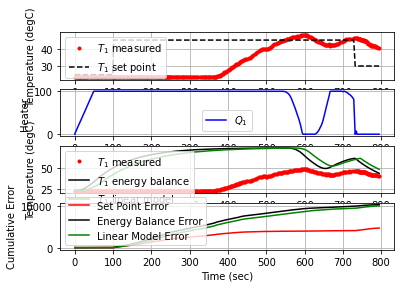

 799.4  30.00  39.70   0.00  -6.18  17.66   0.03


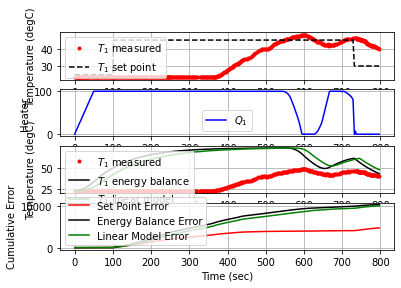

 801.6  30.00  39.63   0.00  -6.13  17.66   0.01


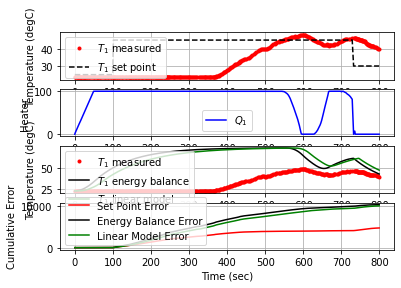

 804.3  30.00  39.71   0.00  -6.18  17.66  -0.01


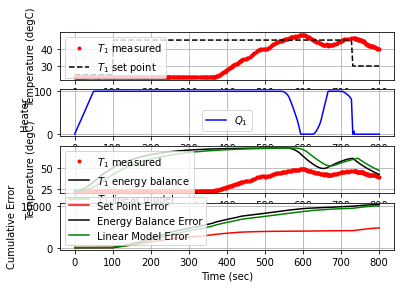

 807.9  30.00  39.47   0.00  -6.03  17.66   0.03


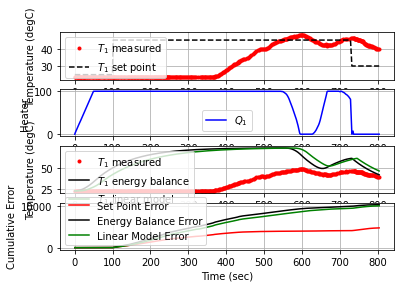

 811.1  30.00  38.95   0.00  -5.70  17.66   0.08


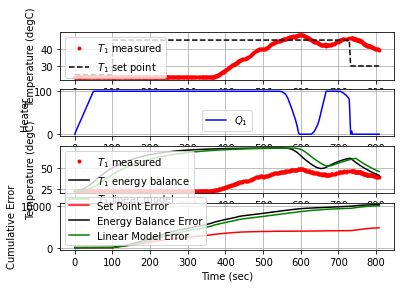

 813.9  30.00  38.76   0.00  -5.58  17.66   0.03


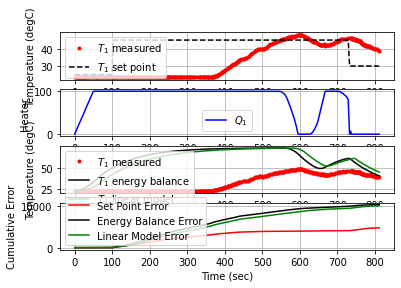

 816.2  30.00  38.76   0.00  -5.58  17.66  -0.00


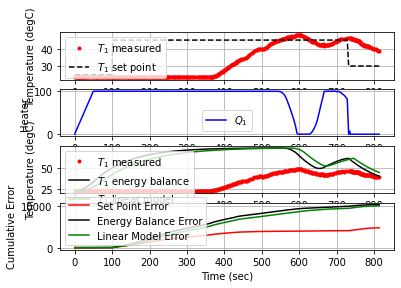

 818.8  30.00  38.61   0.00  -5.48  17.66   0.03


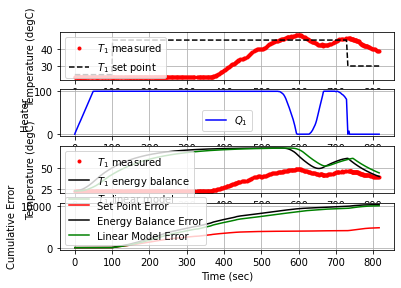

 821.1  30.00  38.36   0.00  -5.32  17.66   0.05


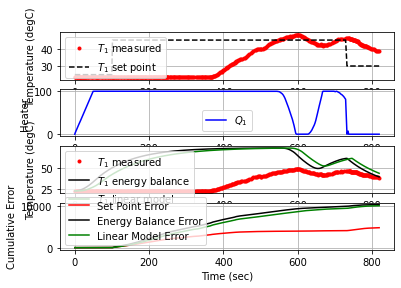

 823.3  30.00  38.22   0.00  -5.23  17.66   0.03


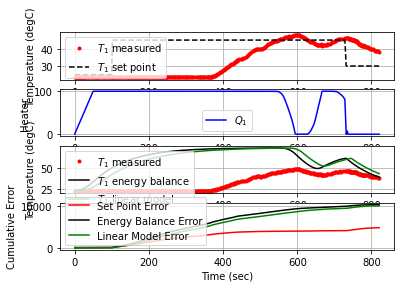

 825.4  30.00  38.01   0.00  -5.10  17.66   0.05


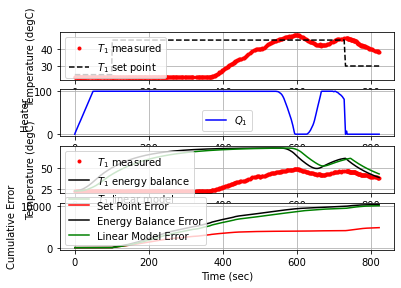

 827.5  30.00  37.67   0.00  -4.88  17.66   0.07


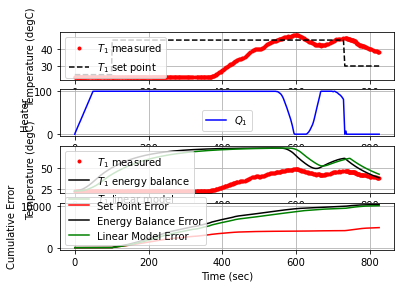

 829.5  30.00  37.39   0.00  -4.71  17.66   0.06


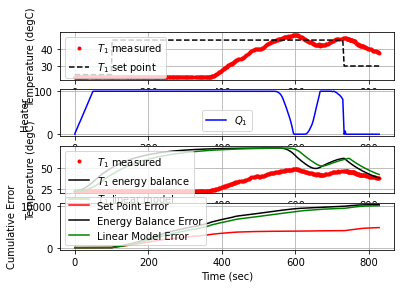

 831.8  30.00  37.22   0.00  -4.60  17.66   0.03


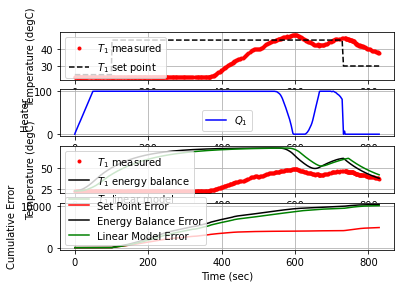

 834.2  30.00  37.06   0.00  -4.50  17.66   0.03


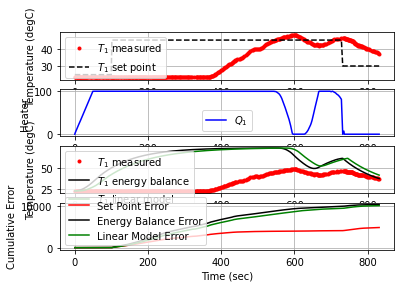

 836.4  30.00  36.97   0.00  -4.44  17.66   0.02


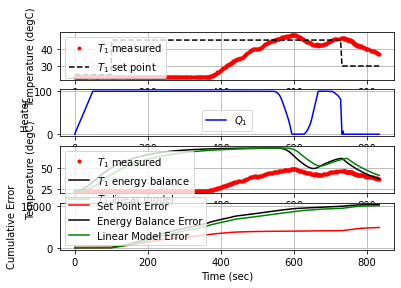

 838.5  30.00  36.67   0.00  -4.25  17.66   0.06


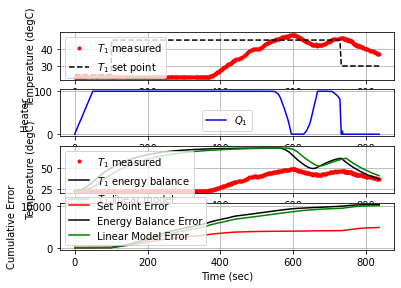

 840.6  30.00  36.45   0.00  -4.11  17.66   0.05


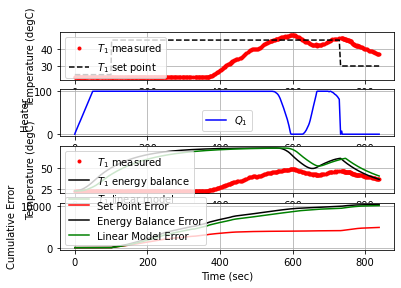

 843.0  30.00  36.23   0.00  -3.97  17.66   0.04


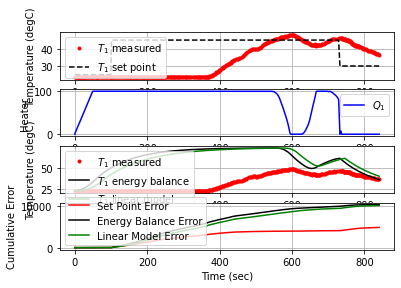

 845.2  30.00  36.04   0.00  -3.85  17.66   0.04


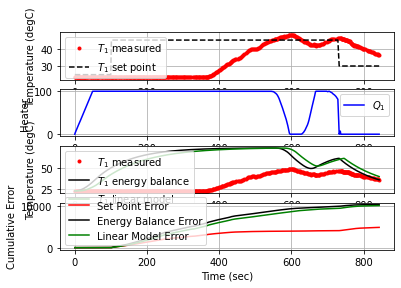

 846.5  30.00  35.97   3.46  -3.80   7.24   0.02


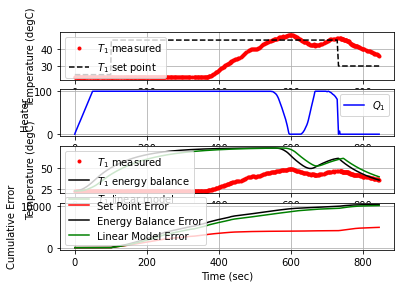

 847.7  30.00  35.75   0.00  -3.66   7.24   0.09


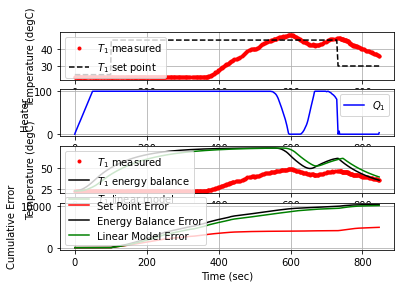

 849.6  30.00  35.70   0.00  -3.63   7.24   0.01


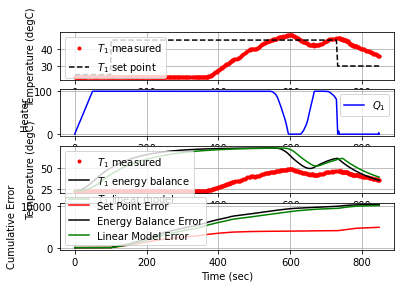

 851.9  30.00  35.52   0.00  -3.52   7.24   0.03


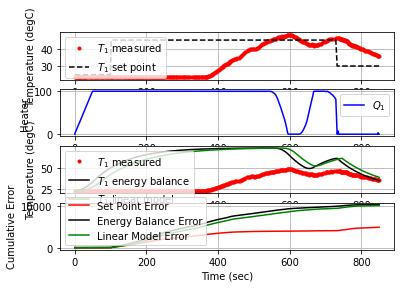

 854.3  30.00  35.15   0.00  -3.28   7.24   0.07


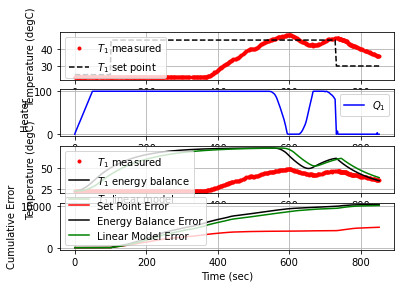

 856.4  30.00  35.03   0.00  -3.21   7.24   0.02


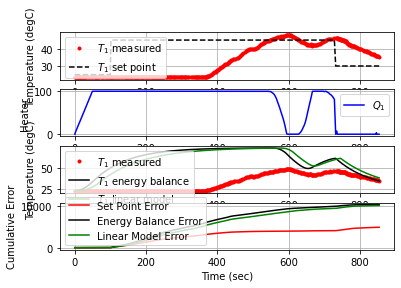

 858.5  30.00  34.93   0.00  -3.14   7.24   0.02


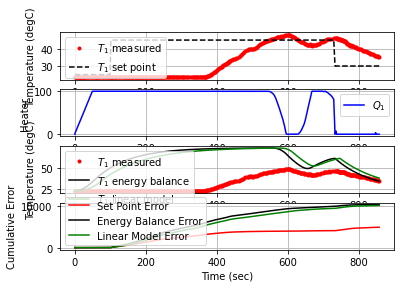

 860.5  30.00  34.88   0.00  -3.11   7.24   0.01


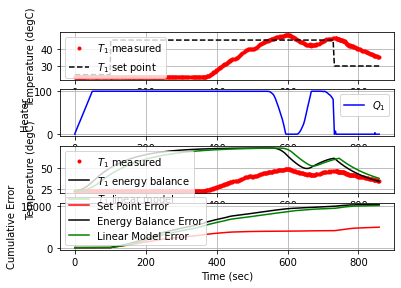

 862.6  30.00  34.63   0.00  -2.95   7.24   0.05


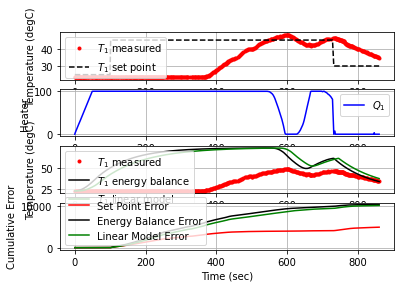

 865.2  30.00  34.50   0.00  -2.87   7.24   0.02


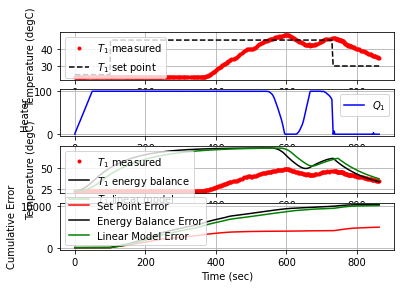

 867.2  30.00  34.37   0.00  -2.79   7.24   0.03


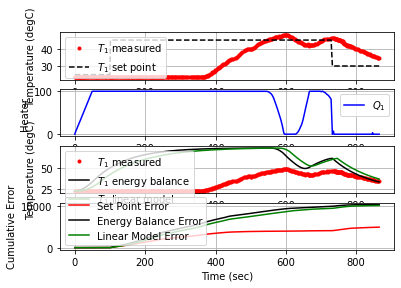

 869.2  30.00  34.19   0.00  -2.67   7.24   0.04


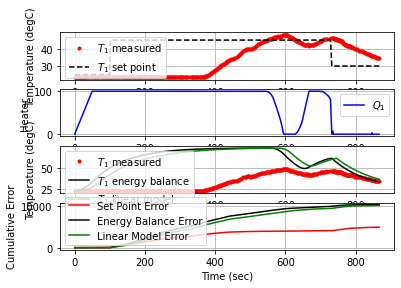

 871.4  30.00  34.12   0.00  -2.63   7.24   0.01


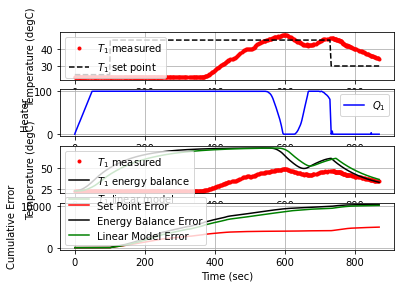

 873.8  30.00  33.92   0.00  -2.50   7.24   0.04


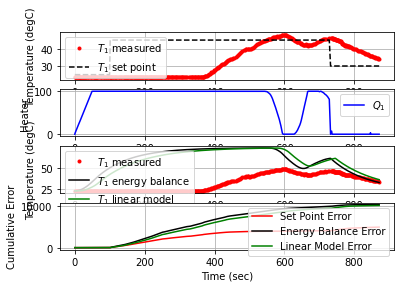

 876.1  30.00  33.83   0.00  -2.44   7.24   0.02


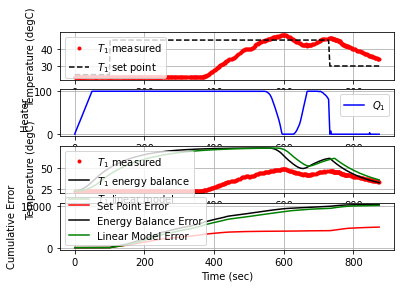

 878.2  30.00  33.67   0.00  -2.34   7.24   0.04


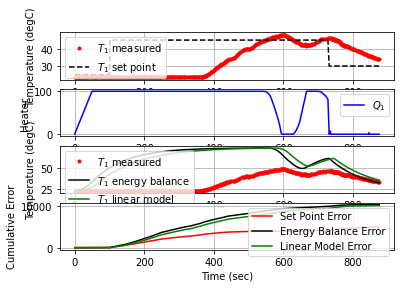

 880.4  30.00  33.51   0.00  -2.24   7.24   0.03


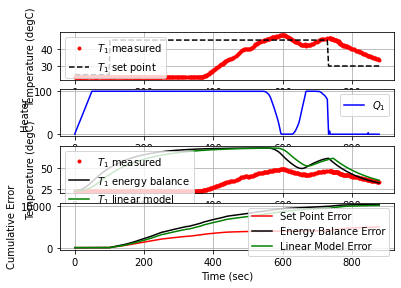

 882.5  30.00  33.47   0.00  -2.22   7.24   0.01


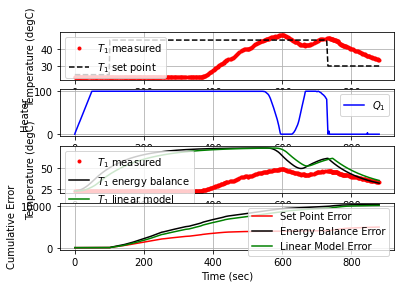

 884.7  30.00  33.17   0.00  -2.02   7.24   0.06


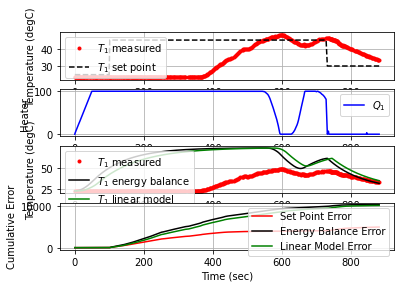

 887.8  30.00  32.88   0.00  -1.84   7.24   0.04


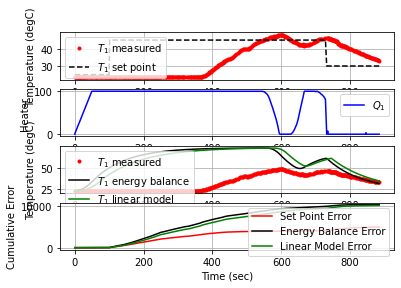

 890.5  30.00  32.68   0.00  -1.71   7.24   0.03


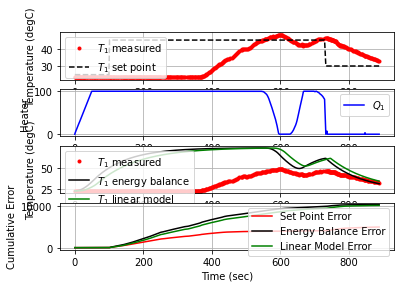

 892.6  30.00  32.58   0.00  -1.65   7.24   0.02


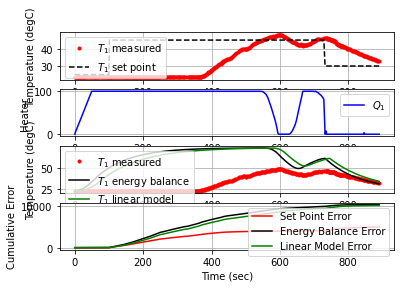

 895.0  30.00  32.53   0.00  -1.62   7.24   0.01


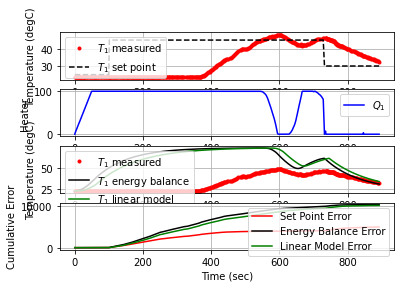

 897.0  30.00  32.48   0.00  -1.59   7.24   0.01


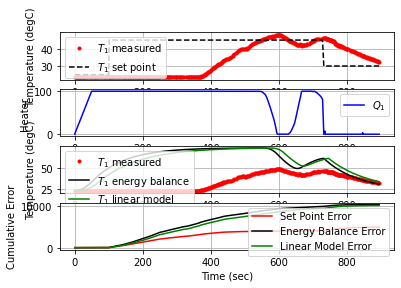

 899.1  30.00  32.30   0.00  -1.47   7.24   0.04


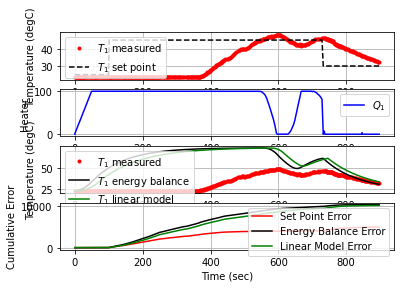

 901.4  30.00  32.07   0.00  -1.32   7.24   0.04


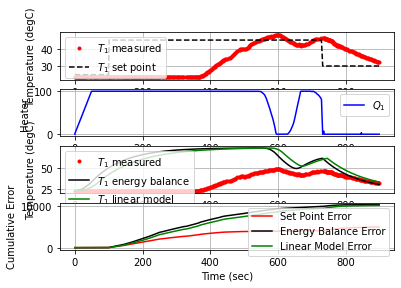

 904.0  30.00  31.63   0.88  -1.04   1.85   0.08


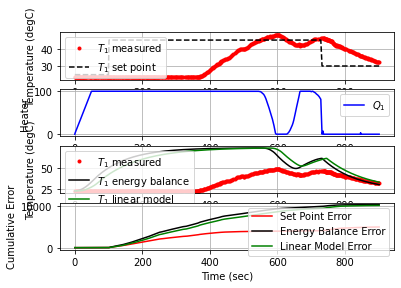

 906.3  30.00  31.72   0.00  -1.10   1.85  -0.02


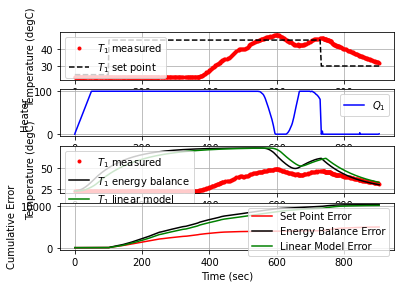

 908.3  30.00  31.68   0.00  -1.08   1.85   0.01


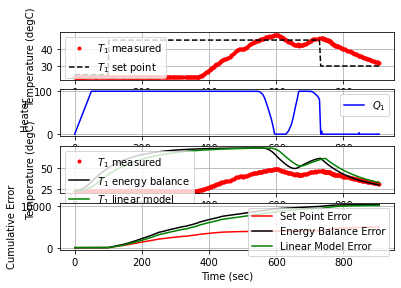

 909.5  30.00  31.62   0.00  -1.04   1.85   0.02


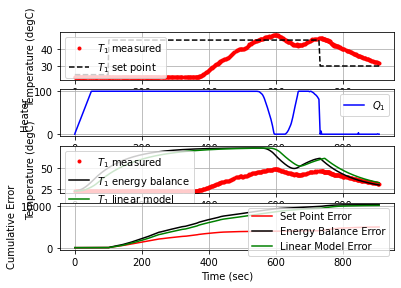

 910.5  30.00  31.48   0.00  -0.95   1.85   0.06


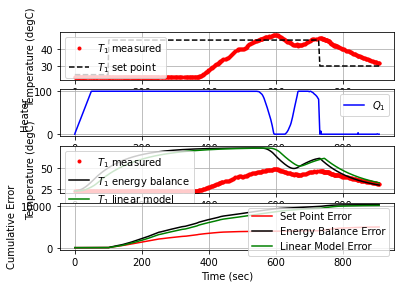

 911.7  30.00  31.43   0.00  -0.92   1.85   0.02


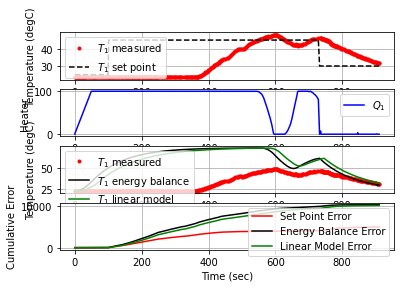

 912.7  30.00  31.39   0.00  -0.89   1.85   0.02


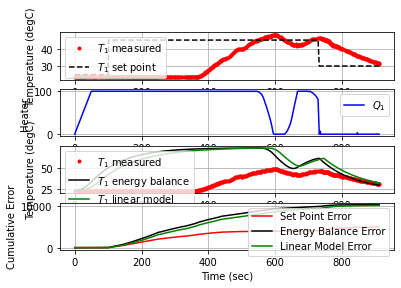

 914.0  30.00  31.19   0.00  -0.76   1.85   0.07


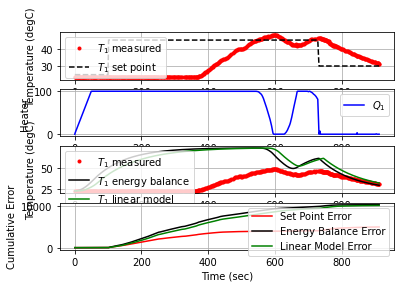

 915.0  30.00  31.19   0.00  -0.76   1.85  -0.00


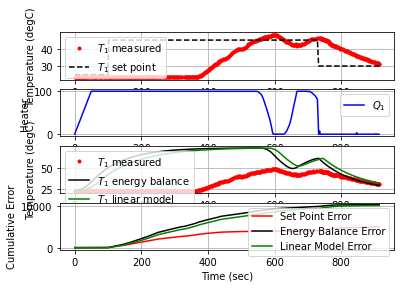

 916.0  30.00  31.13   0.00  -0.73   1.85   0.03


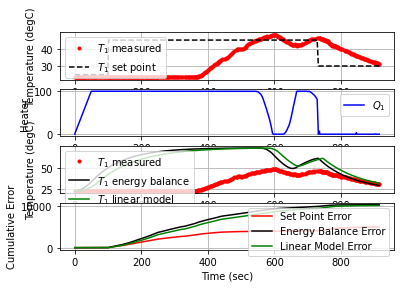

 917.1  30.00  31.08   0.00  -0.69   1.85   0.02


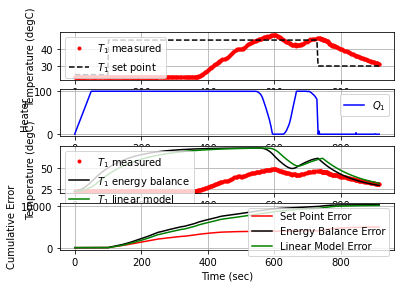

 918.1  30.00  30.99   0.00  -0.64   1.85   0.04


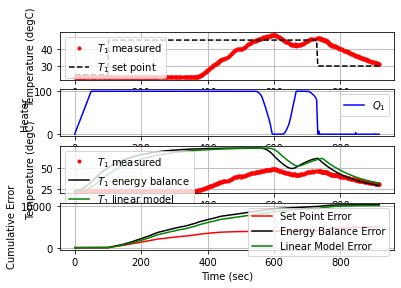

 919.2  30.00  30.94   0.04  -0.60   0.62   0.02


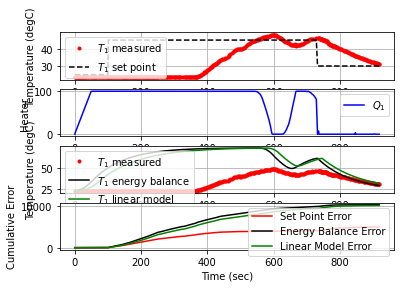

 920.2  30.00  30.82   0.00  -0.53   0.62   0.05


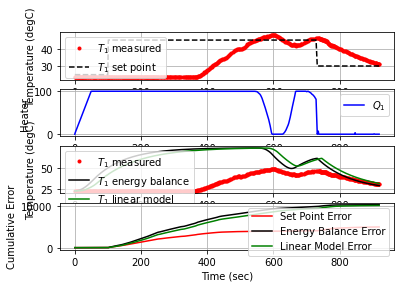

 921.5  30.00  30.79   0.00  -0.51   0.62   0.01


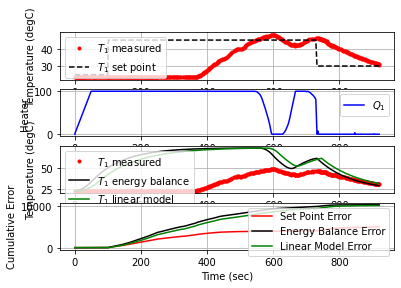

 923.6  30.00  30.61   0.00  -0.39   0.62   0.04


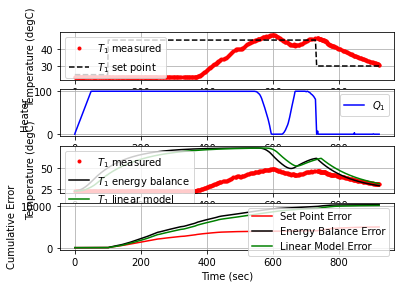

 927.1  30.00  30.44   0.00  -0.28   0.62   0.02


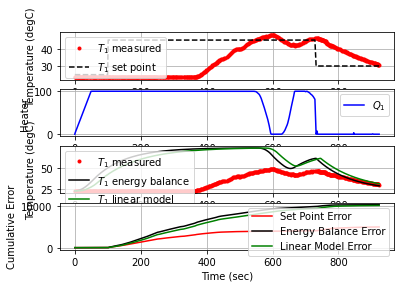

 929.9  30.00  30.44   0.00  -0.28   0.62  -0.00


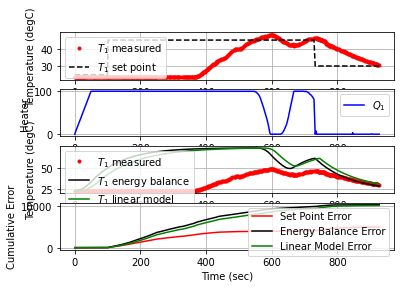

 931.6  30.00  30.39   0.00  -0.25   0.62   0.01


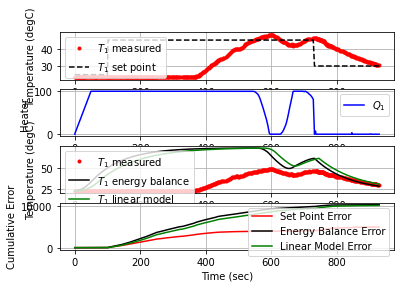

 932.6  30.00  30.30   0.07  -0.19   0.22   0.04


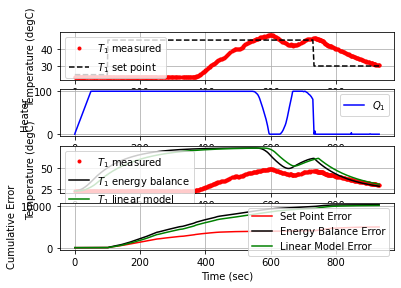

 933.8  30.00  30.23   0.00  -0.15   0.22   0.03


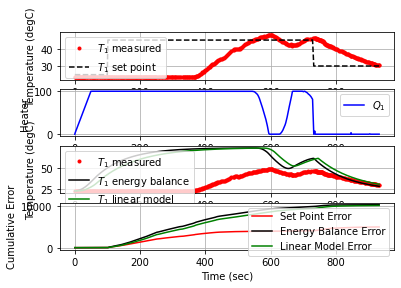

 934.8  30.00  30.20   0.00  -0.13   0.22   0.01


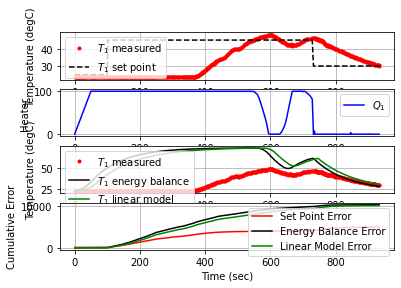

 936.0  30.00  30.09   0.08  -0.06   0.09   0.04


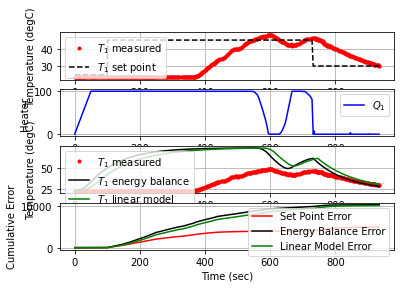

 937.0  30.00  30.02   0.08  -0.01   0.06   0.03


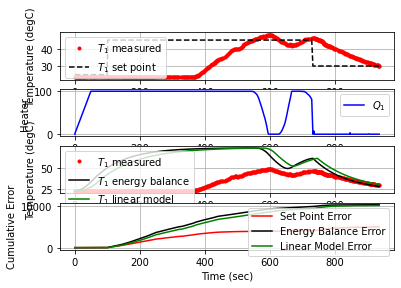

 938.0  30.00  29.86   0.41   0.09   0.25   0.07


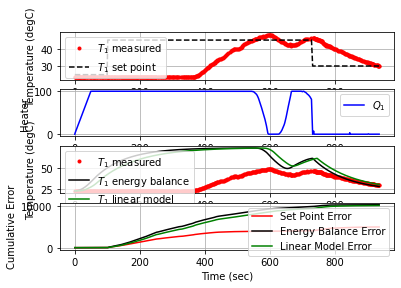

 939.0  30.00  29.92   0.38   0.05   0.35  -0.03


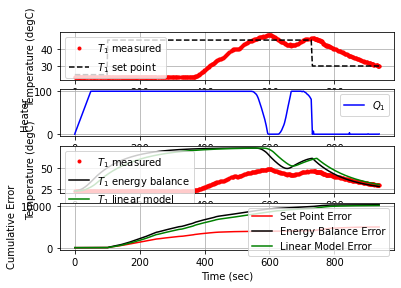

 940.0  30.00  29.79   0.82   0.14   0.63   0.06


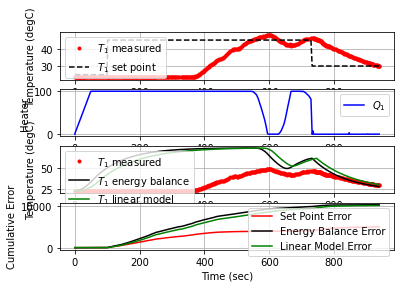

 941.2  30.00  29.84   0.95   0.10   0.87  -0.02


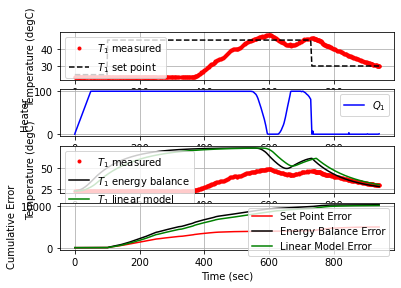

 942.2  30.00  29.71   1.50   0.19   1.25   0.06


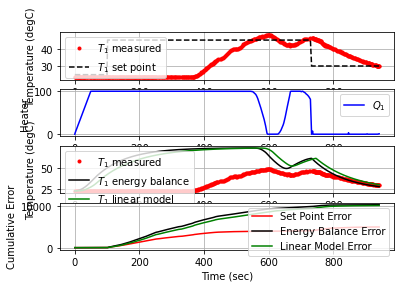

 943.2  30.00  29.71   1.83   0.19   1.64  -0.00


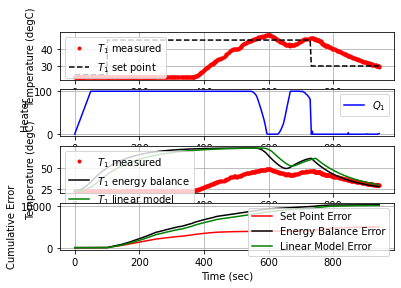

 944.3  30.00  29.64   2.38   0.23   2.11   0.03


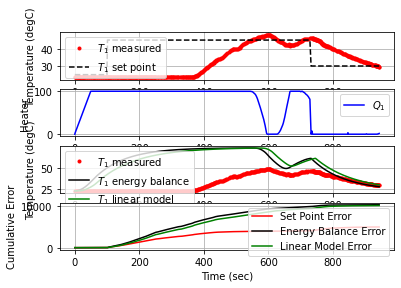

 945.3  30.00  29.53   3.08   0.30   2.72   0.05


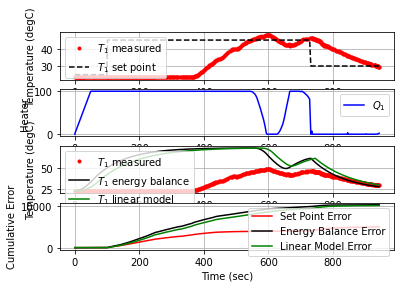

 946.4  30.00  29.44   3.95   0.36   3.55   0.04


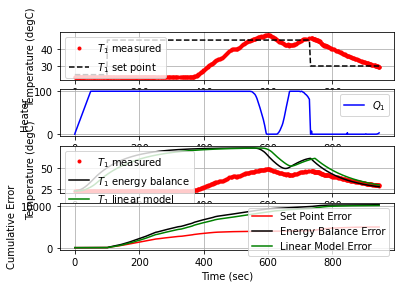

 947.4  30.00  29.39   4.78   0.39   4.37   0.02


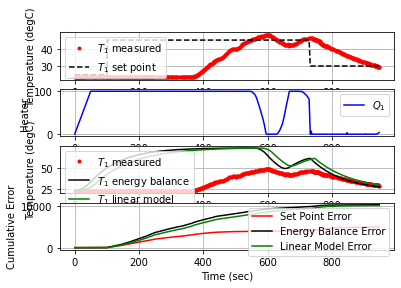

 948.4  30.00  29.35   5.64   0.42   5.21   0.02


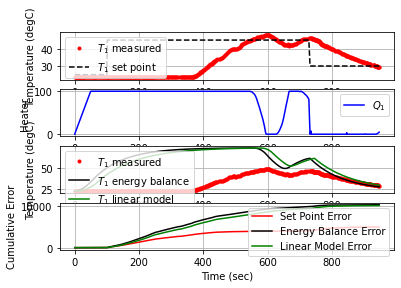

 949.4  30.00  29.34   6.51   0.43   6.07   0.00


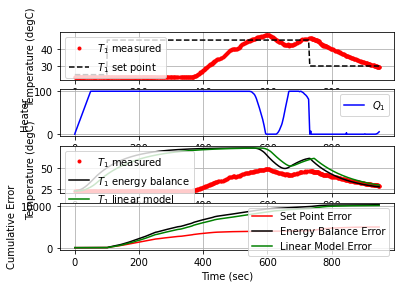

 950.6  30.00  29.25   7.71   0.48   7.18   0.04


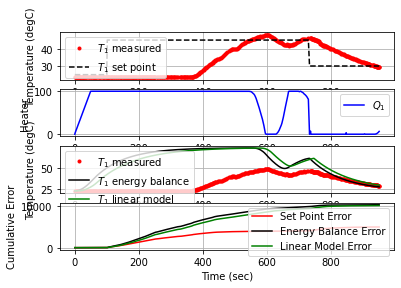

 951.7  30.00  29.39   8.36   0.39   8.03  -0.06


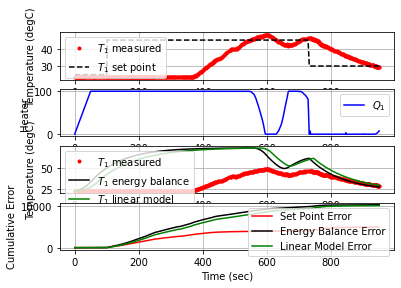

 952.8  30.00  29.34   9.48   0.43   9.03   0.02


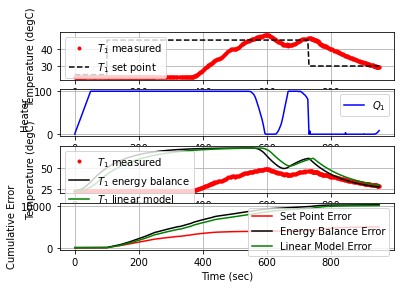

 953.9  30.00  29.33  10.41   0.43   9.97   0.00


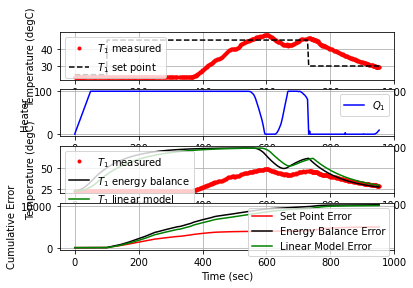

 954.9  30.00  29.38  11.18   0.40  10.80  -0.02


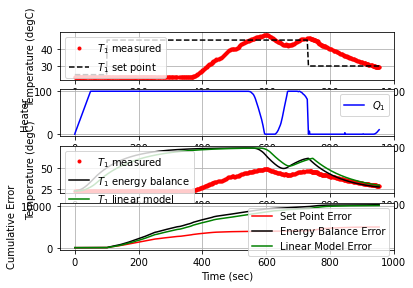

 956.0  30.00  29.40  11.99   0.39  11.61  -0.01


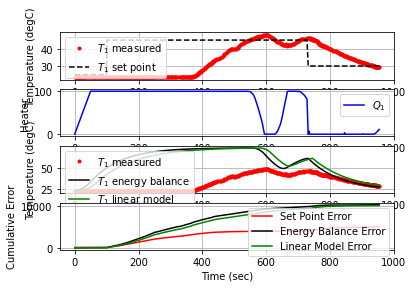

 957.0  30.00  29.31  13.04   0.45  12.55   0.04


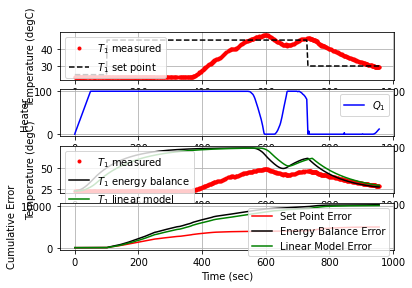

 958.2  30.00  29.32  14.02   0.44  13.59  -0.00


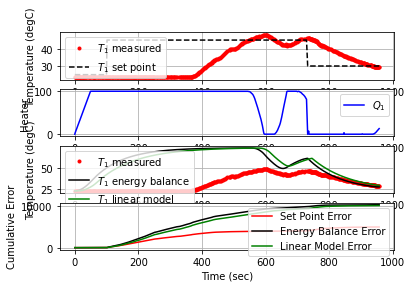

 959.2  30.00  29.23  15.16   0.50  14.62   0.04


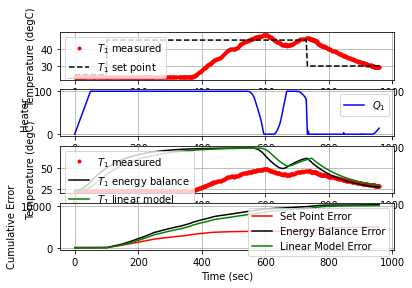

 960.3  30.00  29.28  16.04   0.47  15.59  -0.02


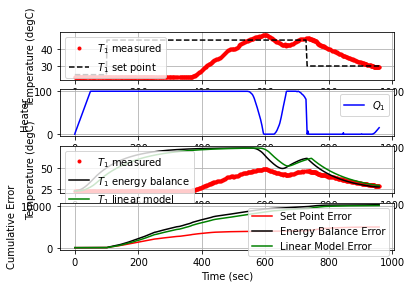

 961.3  30.00  29.18  17.27   0.53  16.69   0.04


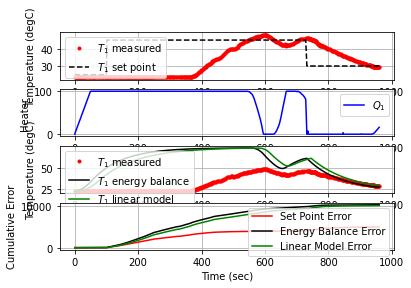

 962.4  30.00  29.22  18.22   0.50  17.73  -0.02


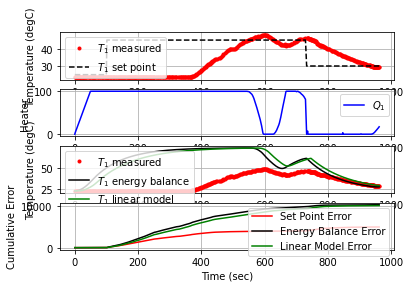

 963.7  30.00  29.21  19.60   0.51  19.08   0.00


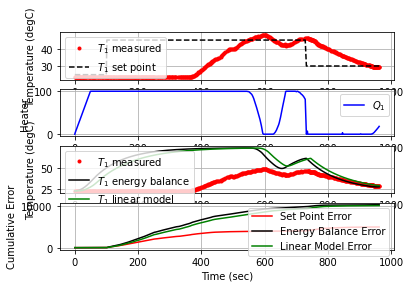

 964.8  30.00  29.24  20.72   0.49  20.24  -0.01


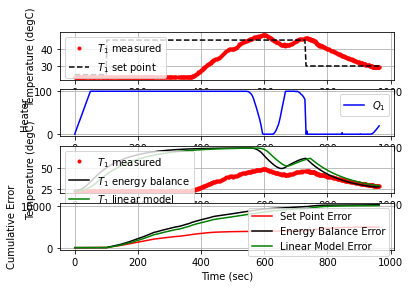

 965.9  30.00  29.39  21.38   0.39  21.06  -0.07


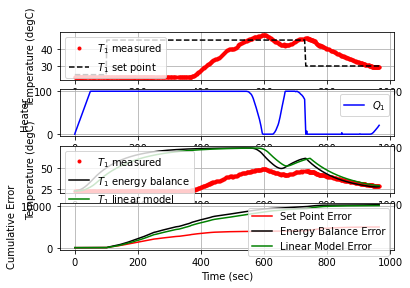

 966.9  30.00  29.29  22.52   0.46  22.02   0.04


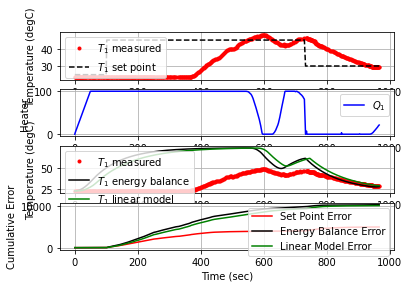

 967.9  30.00  29.40  23.15   0.39  22.81  -0.05


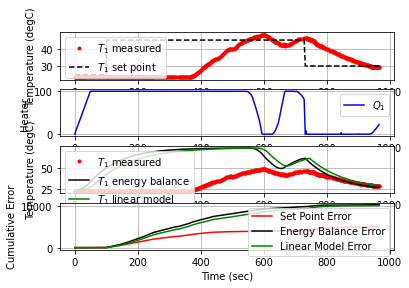

 969.0  30.00  29.46  23.86   0.35  23.53  -0.03


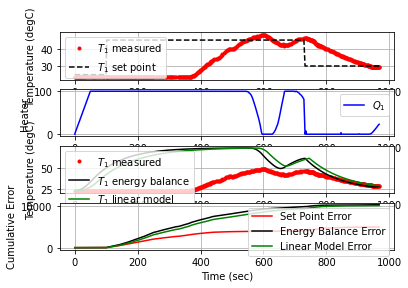

 970.1  30.00  29.59  24.37   0.27  24.16  -0.05


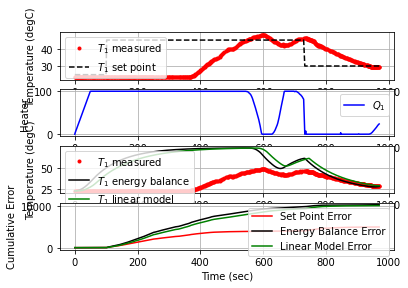

 971.2  30.00  29.63  24.87   0.24  24.65  -0.02


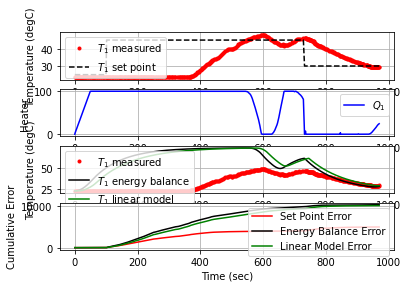

 972.2  30.00  29.58  25.52   0.27  25.23   0.02


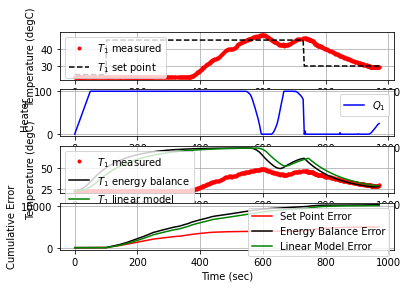

 973.4  30.00  29.74  25.72   0.17  25.62  -0.06


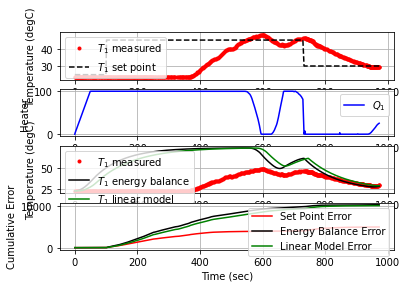

 974.4  30.00  29.79  26.01   0.14  25.90  -0.02


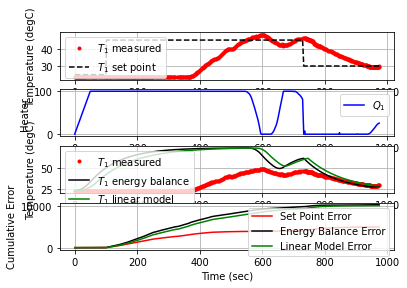

 975.5  30.00  29.70  26.54   0.19  26.30   0.04


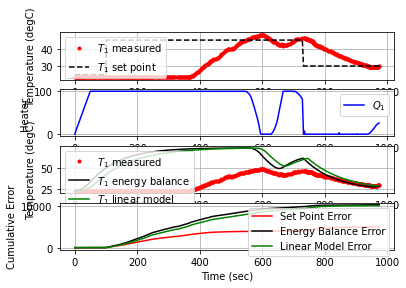

 976.7  30.00  29.95  26.32   0.03  26.38  -0.09


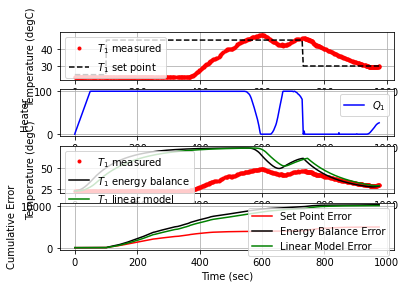

 978.7  30.00  29.96  26.51   0.03  26.49  -0.00


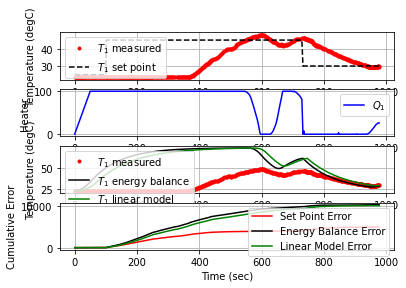

 980.4  30.00  30.21  25.82  -0.14  26.02  -0.07


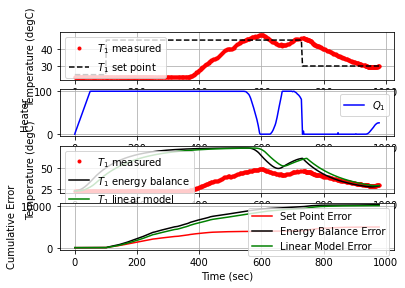

 982.3  30.00  30.40  24.75  -0.26  25.06  -0.05


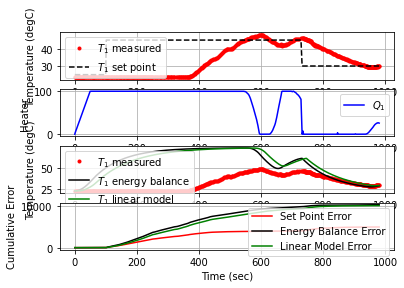

 983.5  30.00  30.43  24.13  -0.28  24.42  -0.01


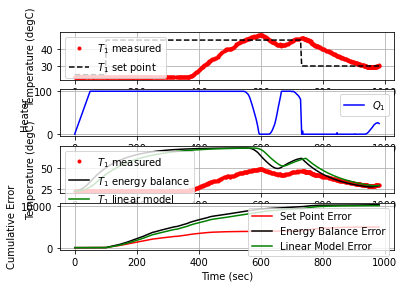

 985.1  30.00  30.60  22.72  -0.39  23.15  -0.05


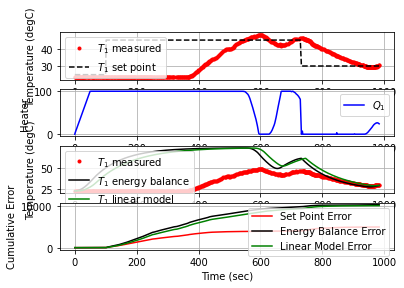

 986.3  30.00  30.62  21.77  -0.40  22.18  -0.01


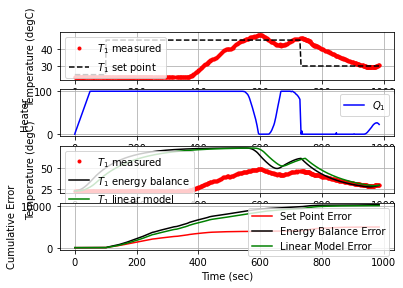

 987.4  30.00  30.74  20.65  -0.48  21.18  -0.05


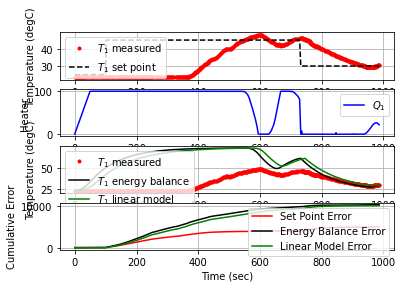

 988.4  30.00  30.84  19.45  -0.54  20.03  -0.04


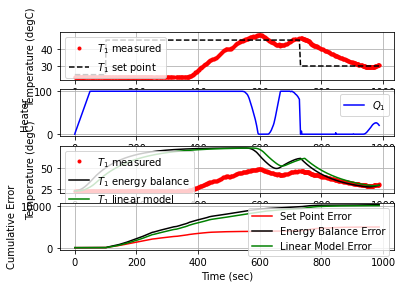

 989.6  30.00  30.86  18.21  -0.55  18.77  -0.01


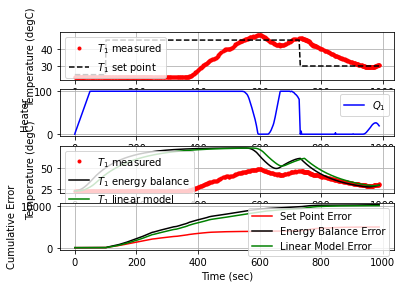

 991.0  30.00  30.90  16.51  -0.58  17.10  -0.01


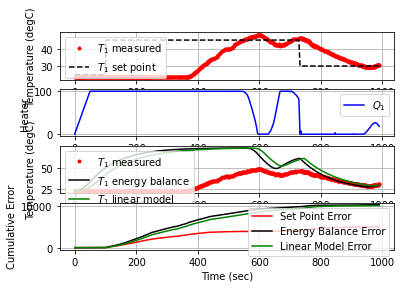

 992.3  30.00  31.05  14.62  -0.68  15.35  -0.05


In [ ]:
######################################################
# Do not adjust anything below this point            #
######################################################

# Connect to Arduino
a = itclab.iTCLab()
#a.encode('utf-8').strip()#modification error
# Turn LED on
print('LED On')
a.LED(100)

# Run time in minutes
run_time = 15.0

# Number of cycles
loops = int(60.0*run_time)
tm = np.zeros(loops)

# Temperature
# set point (degC)
Tsp1 = np.ones(loops) * 25.0 
Tsp1[60:] = 45.0
Tsp1[360:] = 30.0
Tsp1[660:] = 35.0
T1 = np.ones(loops) * a.T1 # measured T (degC)
error_sp = np.zeros(loops)

Tsp2 = np.ones(loops) * 23.0 # set point (degC)
T2 = np.ones(loops) * a.T2 # measured T (degC)

# Predictions
Tp = np.ones(loops) * a.T1
error_eb = np.zeros(loops)
Tpl = np.ones(loops) * a.T1
error_fopdt = np.zeros(loops)

# impulse tests (0 - 100%)
Q1 = np.ones(loops) * 0.0
Q2 = np.ones(loops) * 0.0

print('Running Main Loop. Ctrl-C to end.')
print('  Time     SP     PV     Q1   =  P   +  I  +   D')
print(('{:6.1f} {:6.2f} {:6.2f} ' + \
       '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
           tm[0],Tsp1[0],T1[0], \
           Q1[0],0.0,0.0,0.0))

# Create plot
plt.figure(figsize=(10,7))
plt.ion()
plt.show()

# Main Loop
start_time = time.time()
prev_time = start_time
# Integral error
ierr = 0.0
try:
    for i in range(1,loops):
        # Sleep time
        sleep_max = 1.0
        sleep = sleep_max - (time.time() - prev_time)
        if sleep>=0.01:
            time.sleep(sleep-0.01)
        else:
            time.sleep(0.01)

        # Record time and change in time
        t = time.time()
        dt = t - prev_time
        prev_time = t
        tm[i] = t - start_time

        # Read temperatures in Kelvin 
        T1[i] = a.T1
        T2[i] = a.T2

        # Simulate one time step with Energy Balance
        Tnext = odeint(heat,Tp[i-1]+273.15,[0,dt],args=(Q1[i-1],))
        Tp[i] = Tnext[1]-273.15

        # Simulate one time step with linear FOPDT model
        z = np.exp(-dt/tauP)
        Tpl[i] = (Tpl[i-1]-Tss) * z \
                 + (Q1[max(0,i-int(thetaP)-1)]-Qss)*(1-z)*Kp \
                 + Tss

        # Calculate PID Output (Choose one of them)
        # 1. Manually Choosen
#         [Q1[i],P,ierr,D] = pid(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # 2. Based on Deep Learning Result
        [Q1[i],P,ierr,D] = pid_dl(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # Start setpoint error accumulation after 1 minute (60 seconds)
        if i>=60:
            error_eb[i] = error_eb[i-1] + abs(Tp[i]-T1[i])
            error_fopdt[i] = error_fopdt[i-1] + abs(Tpl[i]-T1[i])
            error_sp[i] = error_sp[i-1] + abs(Tsp1[i]-T1[i])

        # Write output (0-100)
        a.Q1(Q1[i])
        a.Q2(0.0)

        # Print line of data
        print(('{:6.1f} {:6.2f} {:6.2f} ' + \
              '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
                  tm[i],Tsp1[i],T1[i], \
                  Q1[i],P,ierr,D))
        
        # Publish data to MQTT Broker
        pub_sp = client.publish('SetPoint', Tsp1[i])
        pub_pv1 = client.publish('Suhu1', T1[i])
        pub_op = client.publish('Nilai_op', Q1[i])

        # Plot
        plt.clf()
        ax=plt.subplot(4,1,1)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tsp1[0:i],'k--',label=r'$T_1$ set point')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,2)
        ax.grid()
        plt.plot(tm[0:i],Q1[0:i],'b-',label=r'$Q_1$')
        plt.ylabel('Heater')
        plt.legend(loc='best')
        ax=plt.subplot(4,1,3)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tp[0:i],'k-',label=r'$T_1$ energy balance')
        plt.plot(tm[0:i],Tpl[0:i],'g-',label=r'$T_1$ linear model')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,4)
        ax.grid()
        plt.plot(tm[0:i],error_sp[0:i],'r-',label='Set Point Error')
        plt.plot(tm[0:i],error_eb[0:i],'k-',label='Energy Balance Error')
        plt.plot(tm[0:i],error_fopdt[0:i],'g-',label='Linear Model Error')
        plt.ylabel('Cumulative Error')
        plt.legend(loc='best')
        plt.xlabel('Time (sec)')
        plt.draw()
        plt.pause(0.05)

    # Turn off heaters
    a.Q1(0)
    a.Q2(0)
    # Save figure
    plt.savefig('test_PID_dl.png')

# Allow user to end loop with Ctrl-C           
except KeyboardInterrupt:
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')

# Make sure serial connection still closes when there's an error
except:           
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Error: Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')
    raise

a.close()

In [12]:
a.close()

Arduino disconnected successfully


True